# PROJECT TITLE: EQUITY IN HEALTHCARE: TACKLING DIFFERENCES BETWEEN SOCIO-ECONOMIC ASPECTS AND HEALTH EQUITY
## By Team D-3
### Team Members:
#### _Soham Mali (02fe22bci025)_
#### _Manish Sabnis (02fe22bci026)_
#### _Shreya Rokade (02fe22bci042)_
#### _Snehal Gujjar (02fe22bci045)_

# SECTION 1 -
## IMPORTS:

### - _Import all required packages and modules_
### - _Import the test.csv and train.csv_




In [1]:
import pandas as pd
import csv
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
import statsmodels.api as sm
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, KNNImputer, SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, AdaBoostRegressor
from sklearn.experimental import enable_hist_gradient_boosting  
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import make_pipeline
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, confusion_matrix
from sklearn.preprocessing import PowerTransformer
from lofo import LOFOImportance, plot_importance, Dataset

sns.set()



/home/manish/.local/lib/python3.10/site-packages/sklearn/experimental/enable_hist_gradient_boosting.py:15: UserWarning: Since version 1.0, it is not needed to import enable_hist_gradient_boosting anymore. HistGradientBoostingClassifier and HistGradientBoostingRegressor are now stable and can be normally imported from sklearn.ensemble.
  warnings.warn(
/home/manish/.local/lib/python3.10/site-packages/lofo/lofo_importance.py:3: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from tqdm.autonotebook import tqdm


In [58]:
experimental_train = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/train.csv')
experimental_test = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/test.csv')


In [2]:
wids_train = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/train.csv')
wids_test = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/test.csv')
wids_train


,patient_id,patient_race,payer_type,patient_state,patient_zip3,Region,Division,patient_age,patient_gender,bmi,...,Average of Apr-18,Average of May-18,Average of Jun-18,Average of Jul-18,Average of Aug-18,Average of Sep-18,Average of Oct-18,Average of Nov-18,Average of Dec-18,metastatic_diagnosis_period
0,268700,NaN,COMMERCIAL,AR,724,South,West South Central,39,F,NaN,...,52.55,74.77,79.96,81.69,78.30,74.56,59.98,42.98,41.18,191
1,484983,White,NaN,IL,629,Midwest,East North Central,55,F,35.36,...,49.30,72.87,77.40,77.43,75.83,72.64,58.36,39.68,39.71,33
2,277055,NaN,COMMERCIAL,CA,925,West,Pacific,59,F,NaN,...,68.50,70.31,78.61,87.24,85.52,80.75,70.81,62.67,55.58,157
3,320055,Hispanic,MEDICAID,CA,900,West,Pacific,59,F,NaN,...,63.34,63.10,67.45,75.86,75.24,71.10,68.95,65.46,59.46,146
4,190386,NaN,COMMERCIAL,CA,934,West,Pacific,71,F,NaN,...,59.45,60.24,64.77,69.81,70.13,68.10,65.38,60.72,54.08,286
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13168,588544,Hispanic,MEDICAID,PA,191,Northeast,Middle Atlantic,59,F,NaN,...,48.81,66.12,70.38,77.18,77.53,70.90,56.53,41.46,37.49,106
13169,393047,NaN,COMMERCIAL,TX,757,South,West South Central,73,F,30.67,...,62.03,77.82,84.52,85.35,84.61,78.50,67.24,52.16,50.01,92
13170,790904,NaN,COMMERCIAL,CA,928,West,Pacific,19,F,NaN,...,66.20,66.04,70.87,80.68,79.75,75.27,71.40,66.01,59.20,0
13171,455518,NaN,COMMERCIAL,MI,481,Midwest,East North Central,52,F,NaN,...,39.93,63.56,68.68,72.13,72.55,66.17,49.79,34.16,32.28,330


# SECTION 2
## DESCRIPTION AND ANALYSIS:

### -  _Analyse the dataset_
### -  _Perform a statistical analysis_
### -  _Plot the dataframe for visualization of the dataset_
### -  _Identify dependent variables, independent variables, and predictors_
### -  _Replace any incorrect values_

In [34]:
wids_train.describe()

,patient_id,patient_zip3,patient_age,bmi,population,density,age_median,age_under_10,age_10_to_19,age_20s,...,Average of Apr-18,Average of May-18,Average of Jun-18,Average of Jul-18,Average of Aug-18,Average of Sep-18,Average of Oct-18,Average of Nov-18,Average of Dec-18,metastatic_diagnosis_period
count,13173.000000,13173.000000,13173.000000,4102.000000,13173.000000,13173.000000,13173.000000,13173.000000,13173.000000,13173.000000,...,13173.000000,13173.000000,13164.000000,13127.000000,13157.000000,13166.000000,13166.000000,13161.000000,13140.000000,13173.000000
mean,555441.784939,568.530859,59.271313,29.168808,20651.373928,1776.872376,40.542676,11.104988,12.857587,13.297375,...,52.411982,67.932236,73.074635,77.120929,76.281156,71.417027,59.323286,46.100150,42.096213,96.515221
std,259476.503094,275.758485,13.218883,5.752820,13840.379638,3876.061897,4.031027,1.511534,1.952248,3.390472,...,11.069900,6.301740,6.581630,5.335091,5.282156,6.502875,9.261934,12.245594,11.209011,108.969873
min,100043.000000,100.000000,18.000000,15.000000,635.550000,0.920000,20.600000,0.000000,6.310000,5.930000,...,28.790000,45.880000,53.460000,58.540000,56.200000,51.830000,37.540000,19.150000,15.380000,0.000000
25%,335100.000000,330.000000,50.000000,24.825000,9160.340000,163.150000,37.190000,10.150000,11.650000,11.000000,...,42.900000,63.220000,68.050000,73.170000,72.550000,67.020000,51.970000,35.560000,33.370000,3.000000
50%,555769.000000,557.000000,59.000000,28.580000,18952.780000,700.340000,40.640000,11.000000,12.900000,12.530000,...,50.290000,66.120000,71.640000,76.650000,76.080000,70.880000,57.450000,42.430000,38.500000,44.000000
75%,780967.000000,832.000000,67.000000,33.000000,30021.280000,1666.520000,42.940000,12.140000,13.910000,14.970000,...,62.220000,72.590000,77.660000,80.290000,79.130000,75.640000,67.360000,55.730000,50.500000,181.000000
max,999982.000000,995.000000,91.000000,97.000000,71374.130000,29851.690000,54.570000,17.680000,35.300000,62.100000,...,76.490000,86.570000,90.660000,96.430000,95.770000,89.190000,81.460000,76.300000,73.540000,365.000000


In [3]:

numerical_train = wids_train.select_dtypes(include=['number'])
numerical_traincolumns = [c for c in numerical_train]
categorical_train = wids_train.select_dtypes(include=['object'])

numerical_test = wids_test.select_dtypes(include=['number'])
numerical_testcolumns = [c for c in numerical_test]
categorical_test = wids_test.select_dtypes(include=['object'])

In [4]:

def statanalysis(df):
    n_description = pd.DataFrame(index = list(numerical_train))
    n_description['Mean'] = numerical_train.mean()
    n_description['Median'] = numerical_train.median()
    n_description['Total Null Values'] = numerical_train.isnull().sum()
    n_description['Null Value Percentage'] = (numerical_train.isnull().sum()/len(numerical_train)) * 100
    n_description['Max'] = numerical_train.max()
    n_description['Min'] = numerical_train.min()
    n_description['Standard Deviation'] = numerical_train.std()
    print(n_description)

statanalysis(numerical_train)




                                      Mean     Median  Total Null Values  \
patient_id                   555441.784939  555769.00                  0   
patient_zip3                    568.530859     557.00                  0   
patient_age                      59.271313      59.00                  0   
bmi                              29.168808      28.58               9071   
population                    20651.373928   18952.78                  0   
...                                    ...        ...                ...   
Average of Sep-18                71.417027      70.88                  7   
Average of Oct-18                59.323286      57.45                  7   
Average of Nov-18                46.100150      42.43                 12   
Average of Dec-18                42.096213      38.50                 33   
metastatic_diagnosis_period      96.515221      44.00                  0   

                             Null Value Percentage        Max        Min  \
patient_id 

In [5]:

def catanalysis(df):
    c_description = pd.DataFrame(index=df.columns)
    c_description['Mode'] = df.mode().iloc[0]
    c_description['Null Values'] = df.isna().sum()
    c_description['Null Value Percentage'] = df.isna().sum() / len(df) * 100
    print(c_description)

catanalysis(categorical_train)


                                                                                    Mode  \
patient_race                                                                       White   
payer_type                                                                    COMMERCIAL   
patient_state                                                                         CA   
Region                                                                             South   
Division                                                              East North Central   
patient_gender                                                                         F   
breast_cancer_diagnosis_code                                                        1749   
breast_cancer_diagnosis_desc           Malignant neoplasm of breast (female), unspeci...   
metastatic_cancer_diagnosis_code                                                    C773   
metastatic_first_novel_treatment                                                

Upon analysing the .csv file, we found out that column `breast_cancer_diagnosis_desc` contained incorrect values like male cancer descriptions. 
Since our patient gender is female, replace male cancer descriptions and their corresponding codes with female cancer descriptions and codes.

In [6]:
male_columns = [c for c in wids_train['breast_cancer_diagnosis_desc'] if re.search(r'\bmale\b', c)]
filtered_data = wids_train[wids_train['breast_cancer_diagnosis_desc'].isin(male_columns)]
corresponding_codes = filtered_data['breast_cancer_diagnosis_code']
for code, description in zip(corresponding_codes, filtered_data['breast_cancer_diagnosis_desc']):
    print(f"{code}: {description}")

C50421: Malig neoplasm of upper-outer quadrant of right male breast
C50922: Malignant neoplasm of unspecified site of left male breast
C50221: Malig neoplasm of upper-inner quadrant of right male breast
C50122: Malignant neoplasm of central portion of left male breast


As seen above, there are values in `breast_cancer_diagnosis_desc` which contained male cancer descriptions and male cancer codes. We will replace these cancer codes with their corresponding female codes as given on __[this site](httpd://www.icd10data.com/ICD10CM/Codes/C00-D49/C50-C50/C50-)__

In [7]:
replacement_map = {'C50421': 'C50411', 'C50922': 'C50912', 'C50221': 'C50912', 'C50122': 'C50112'}
categorical_train['breast_cancer_diagnosis_code'].replace(replacement_map, inplace=True)

/tmp/ipykernel_3366/2981967419.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  categorical_train['breast_cancer_diagnosis_code'].replace(replacement_map, inplace=True)


Let's analyse what is the skewness of the target attribute in the train dataset. We will try to analyse how many patients were diagnosed quickly and how many took a while to get diagnosed with TNBC

<Axes: xlabel='metastatic_diagnosis_period', ylabel='Count'>

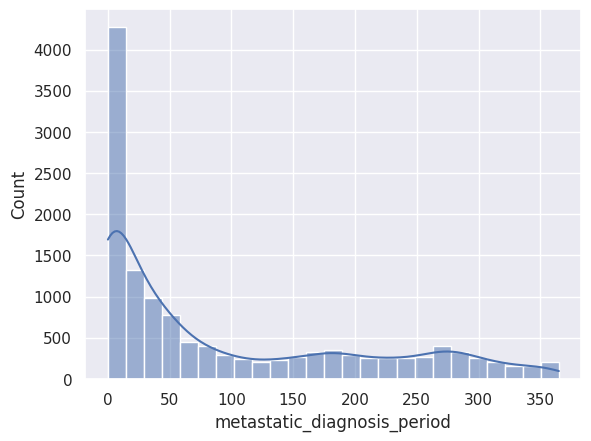

In [40]:
sns.histplot(data=numerical_train['metastatic_diagnosis_period'], kde = True)

#### Hypothesis from the above graph
Why is the graph showing higher frequency at 0?
1) The graph is skewed positively, with which we can conclude that most of the patients were diagnosed quickly. Although, there are patients that took a year or so as well.

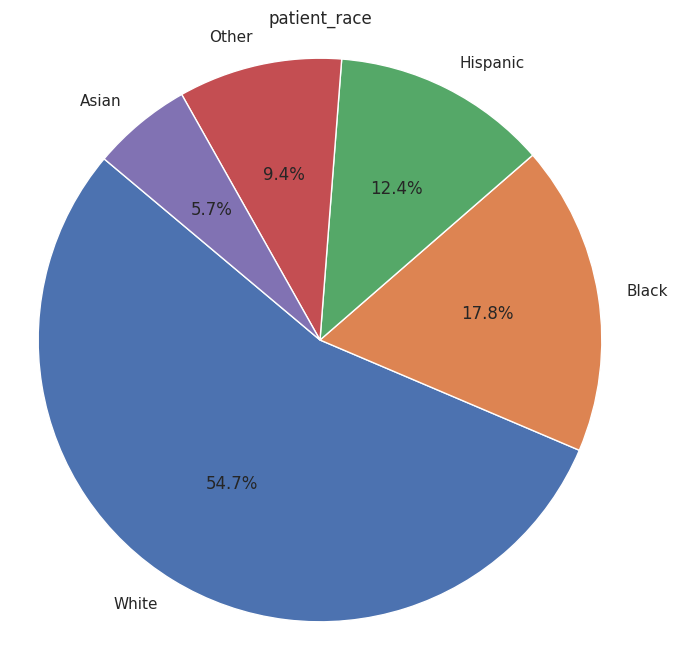

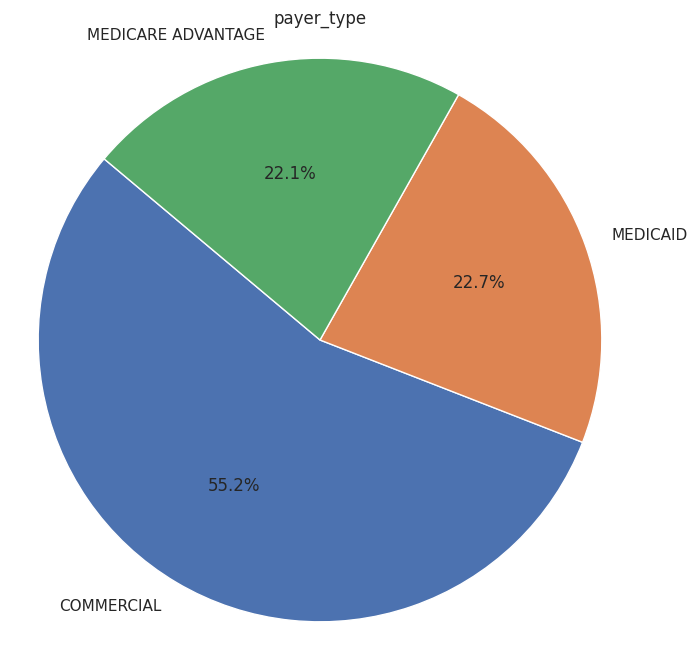

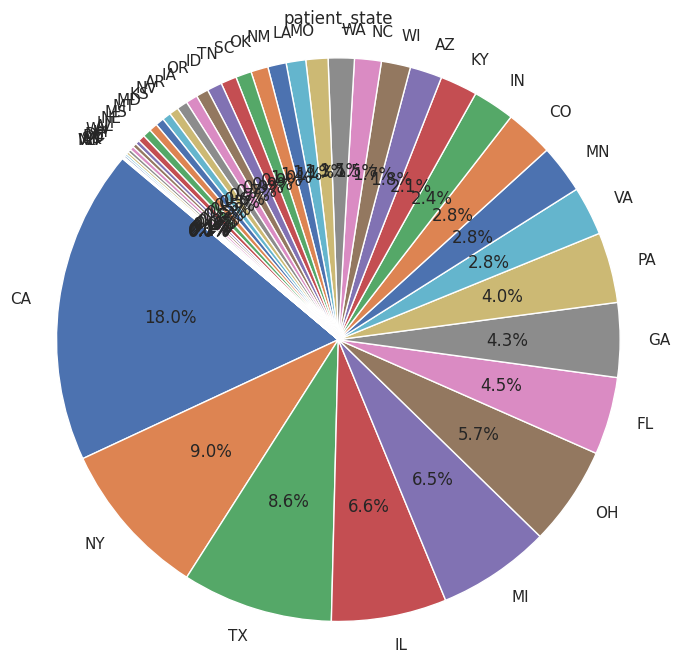

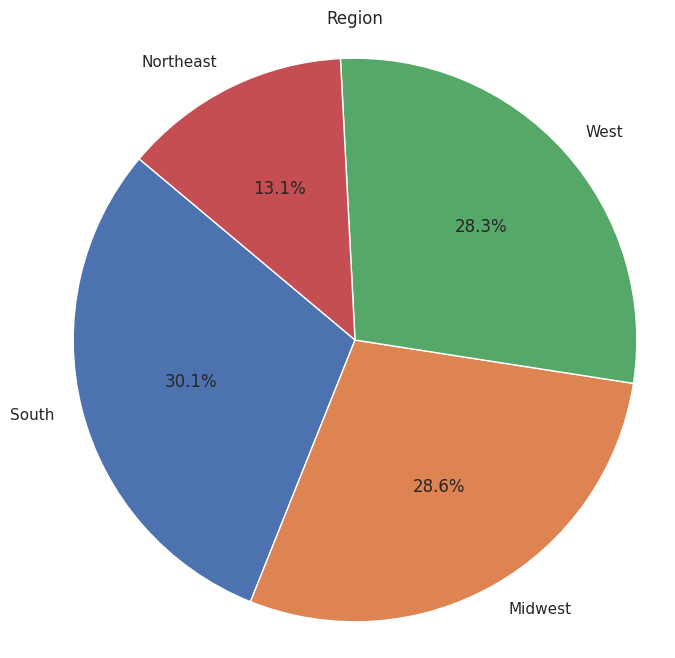

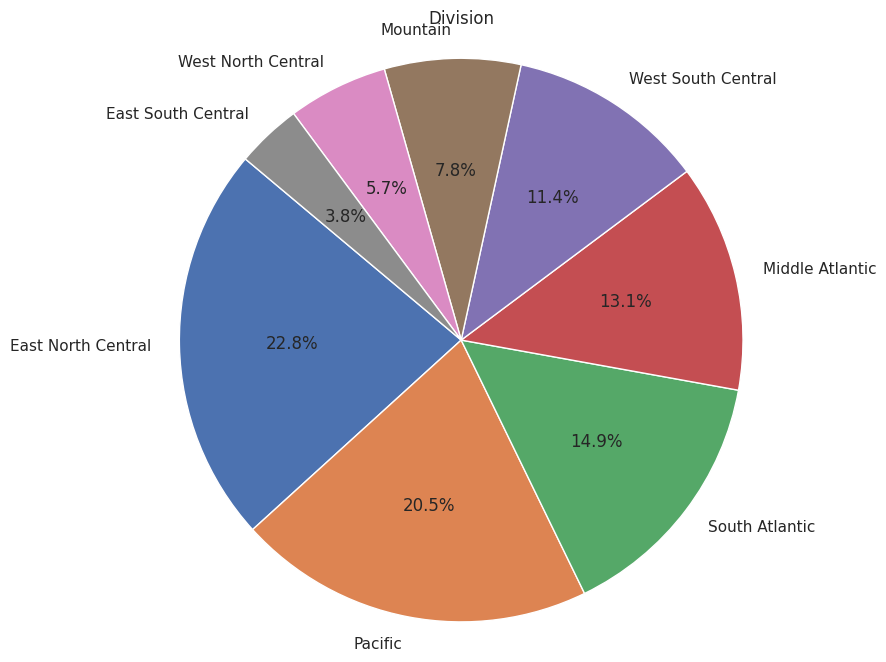

...

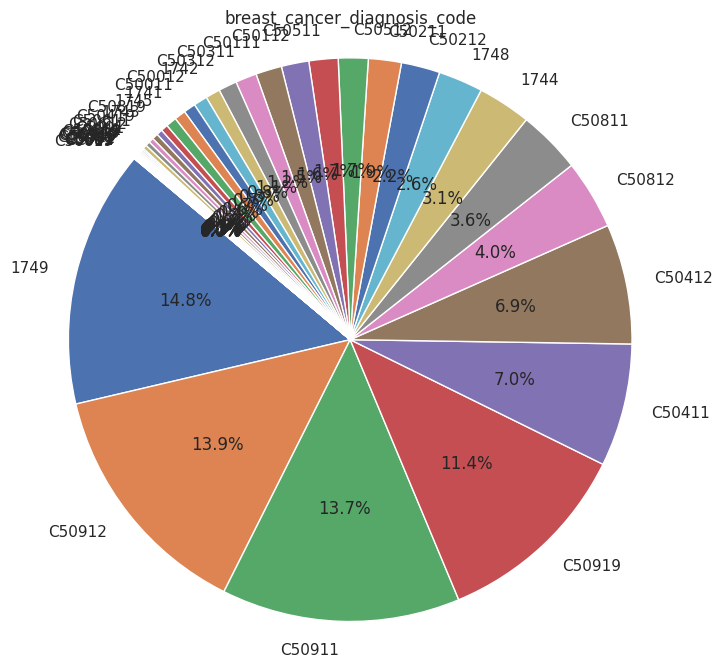

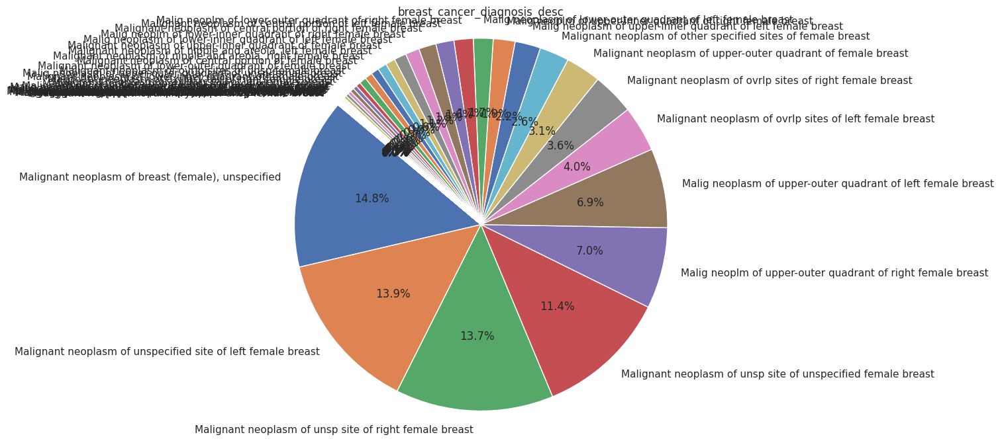

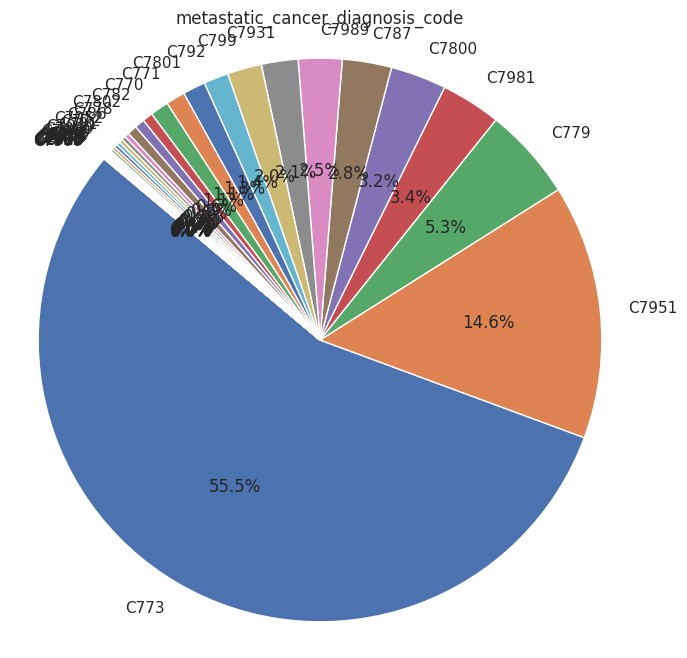

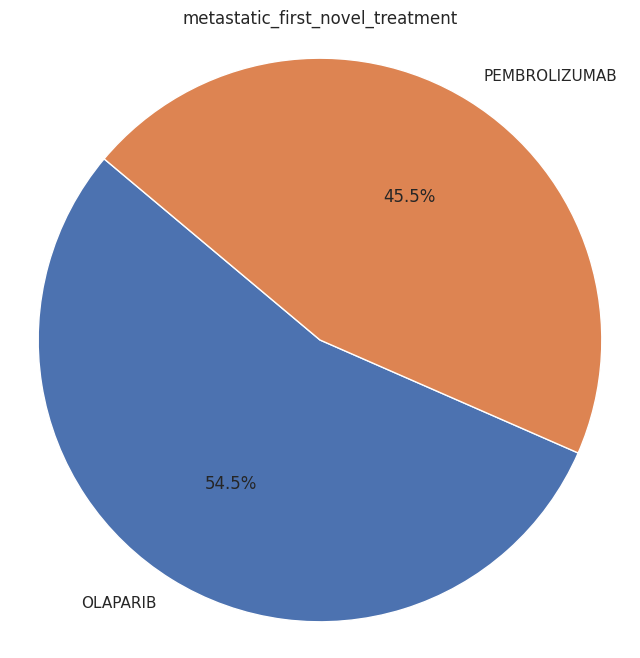

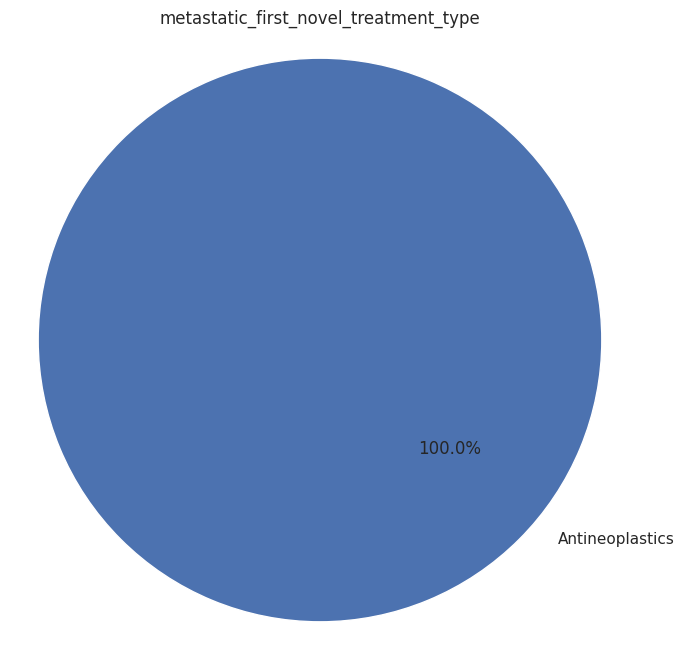

In [41]:
for c in categorical_train:
    category_counts = categorical_train[c].value_counts()


    plt.figure(figsize=(8, 8))
    plt.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%', startangle=140)
    plt.title(c)
    plt.axis('equal') 


    plt.show()

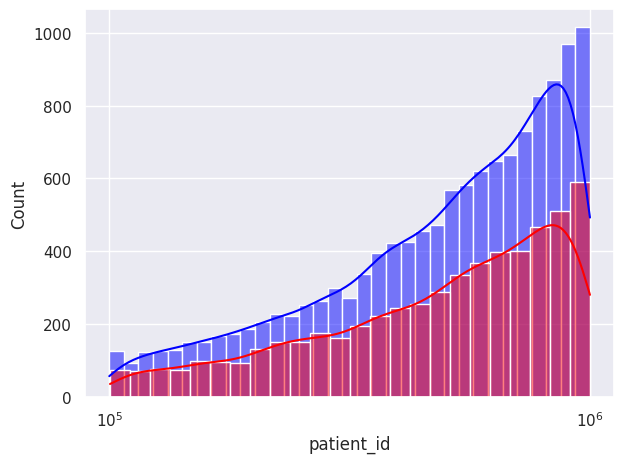

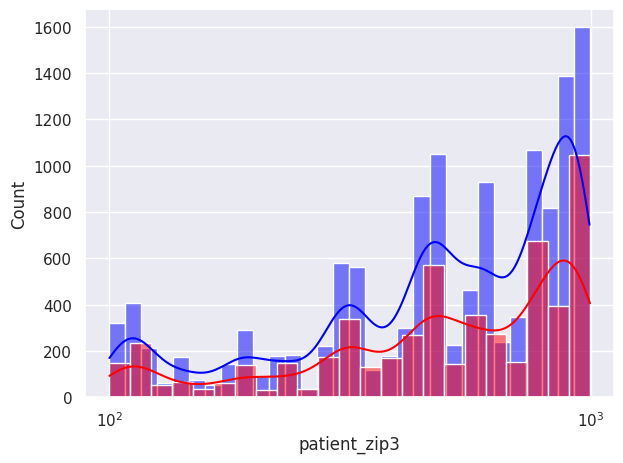

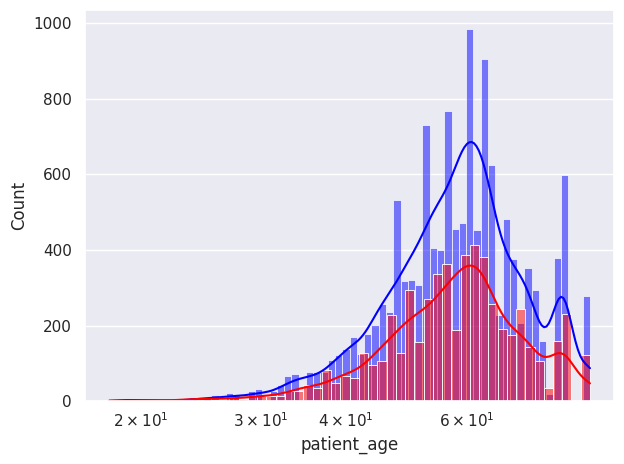

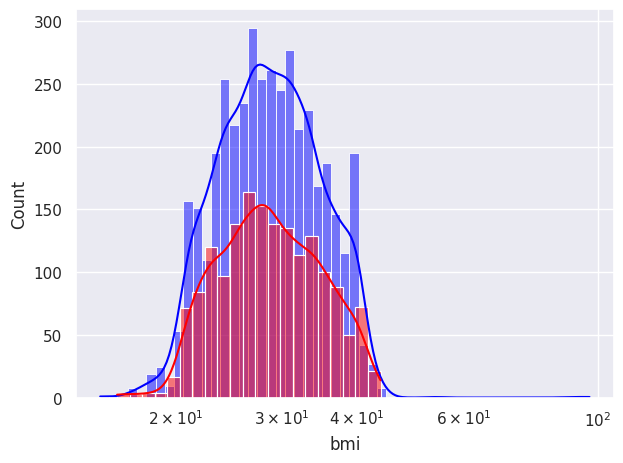

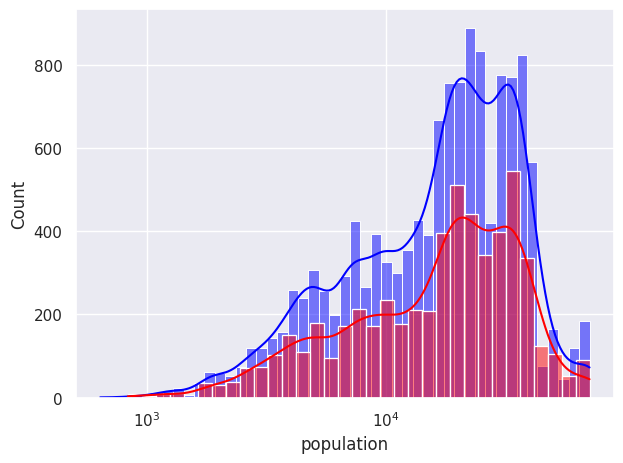

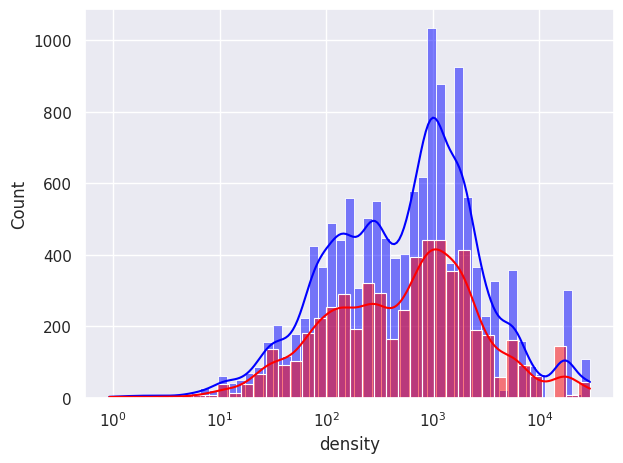

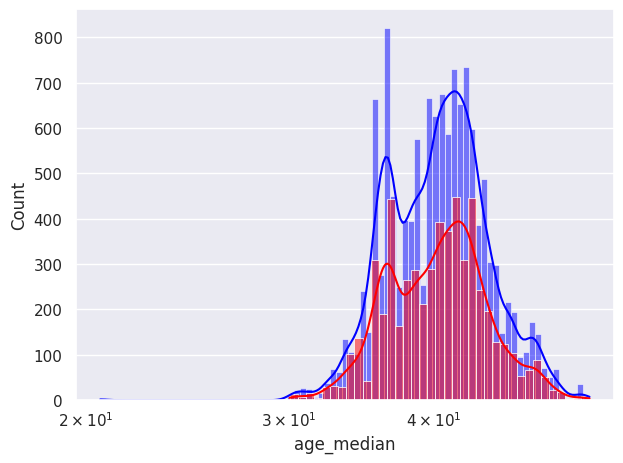

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


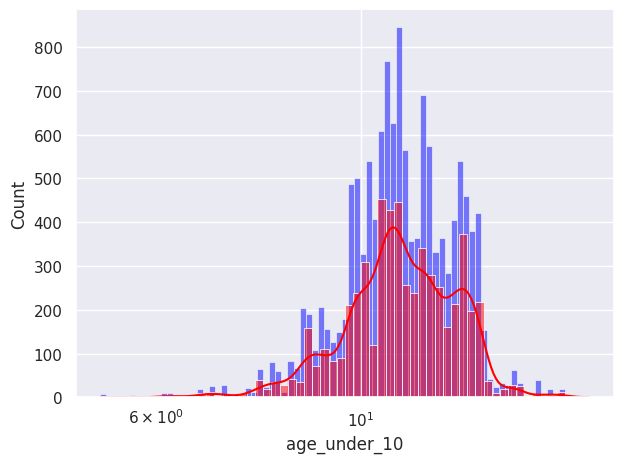

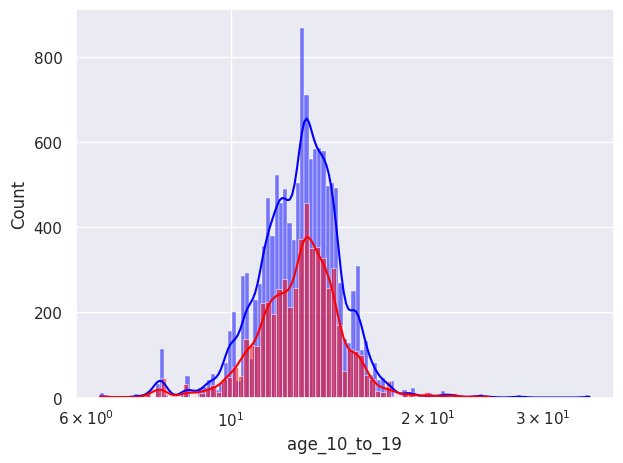

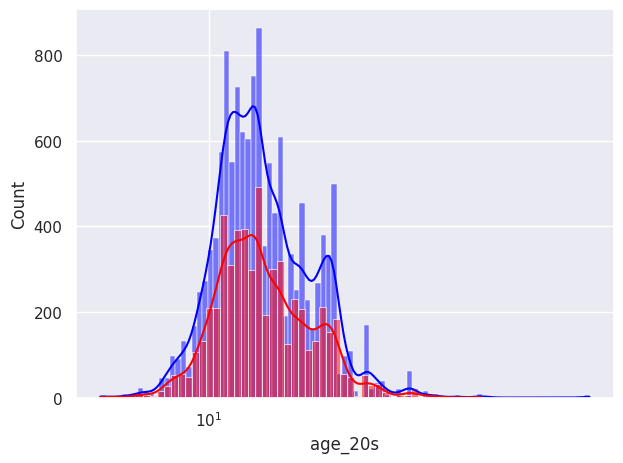

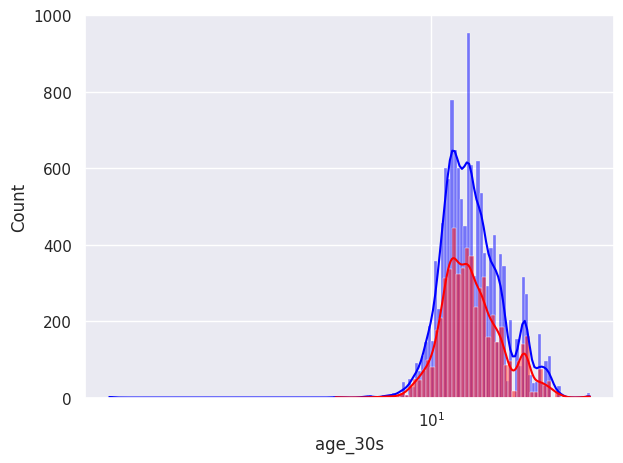

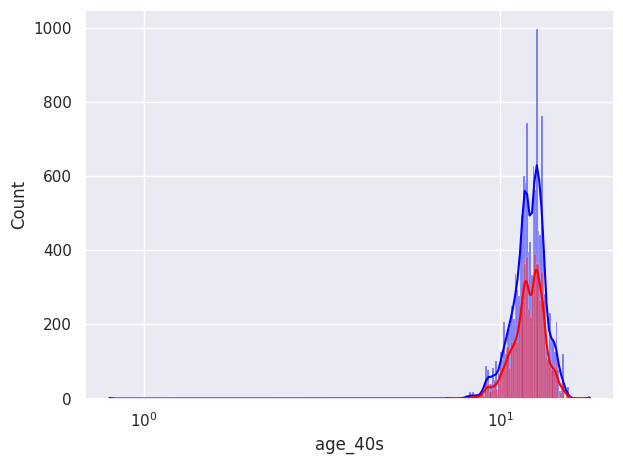

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


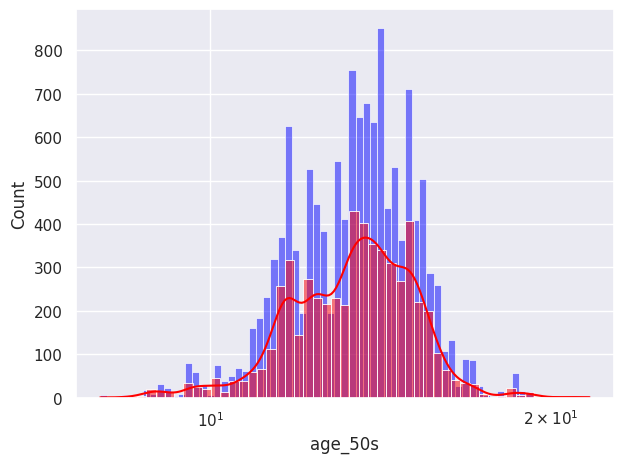

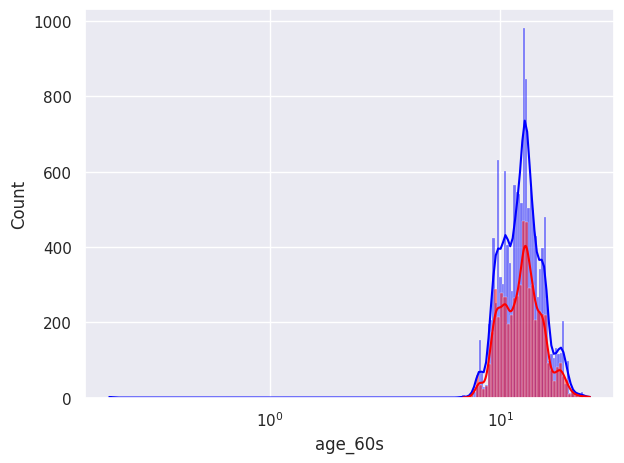

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


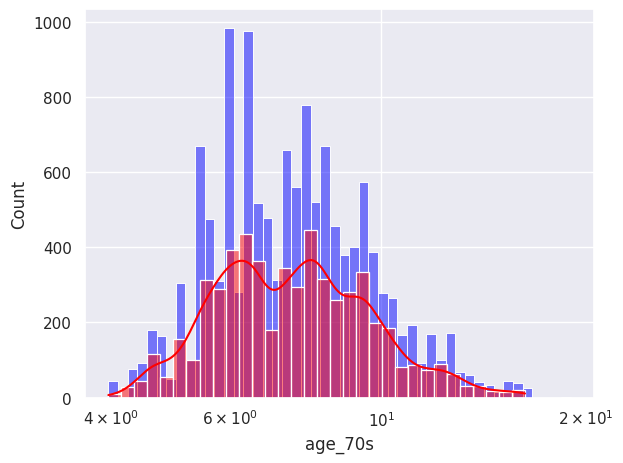

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


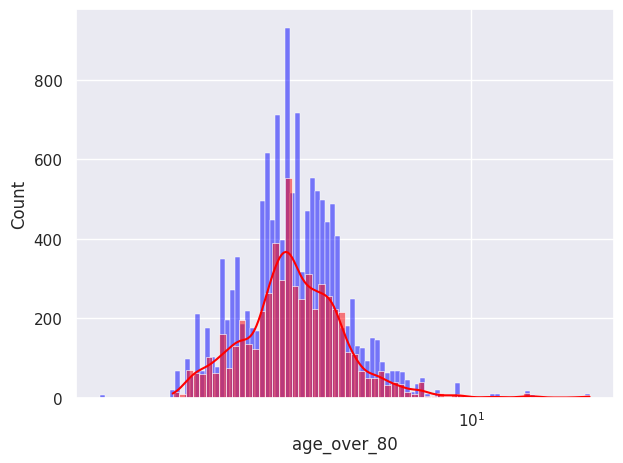

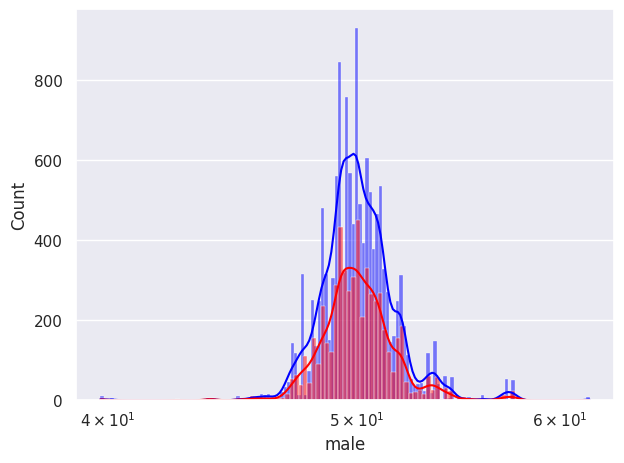

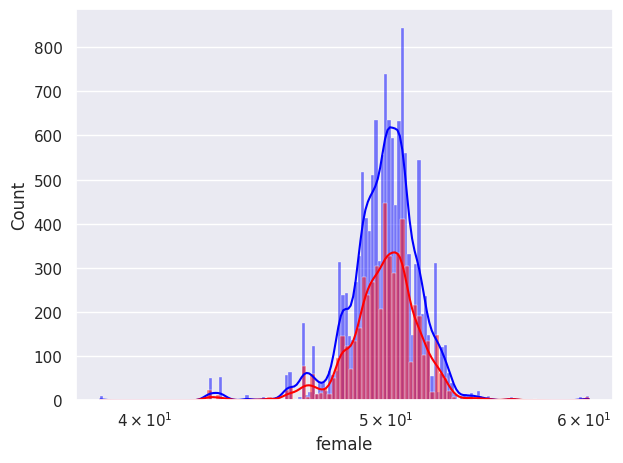

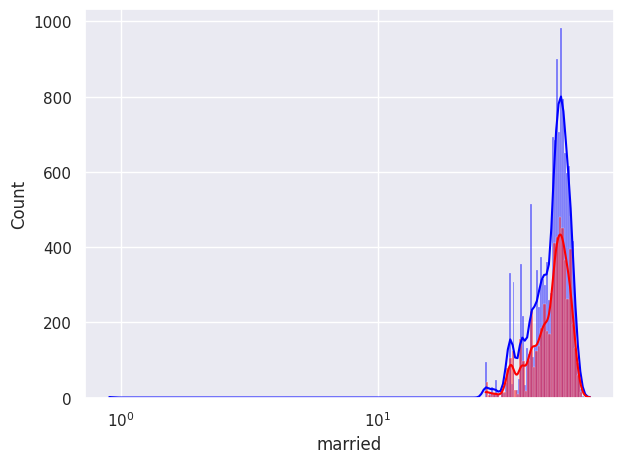

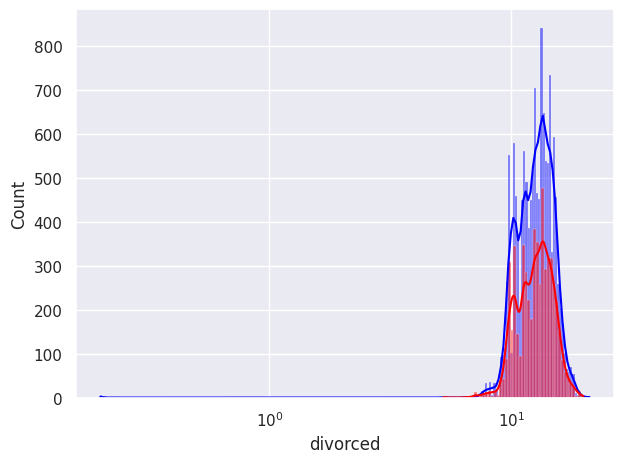

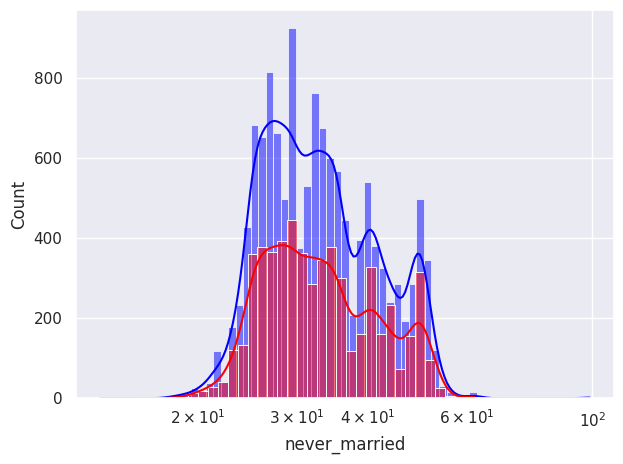

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


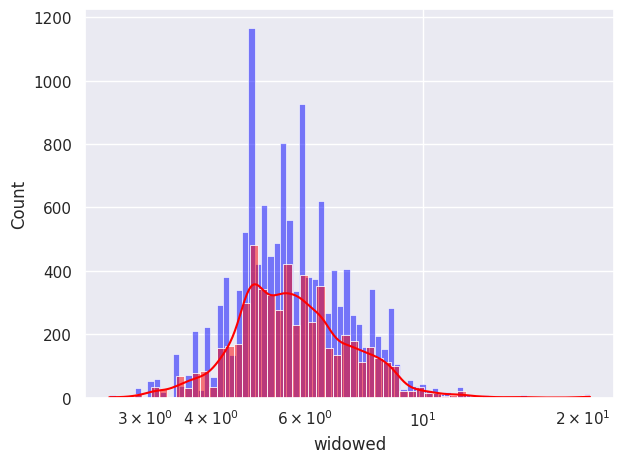

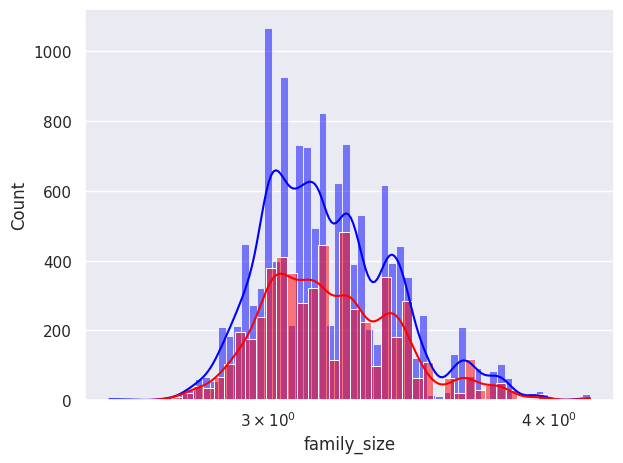

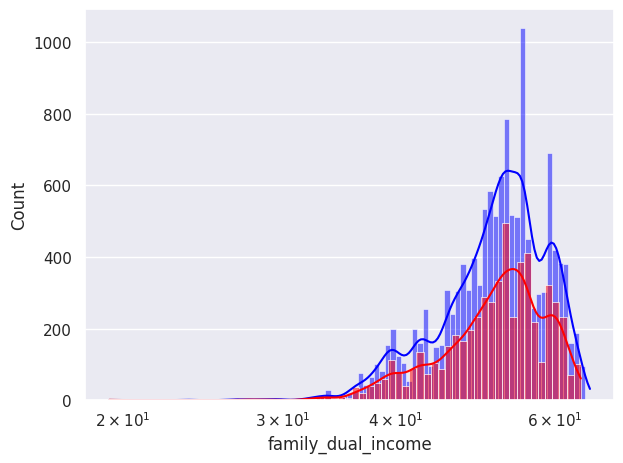

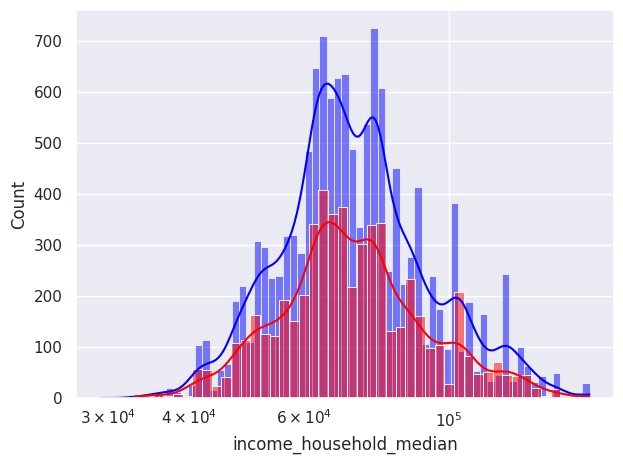

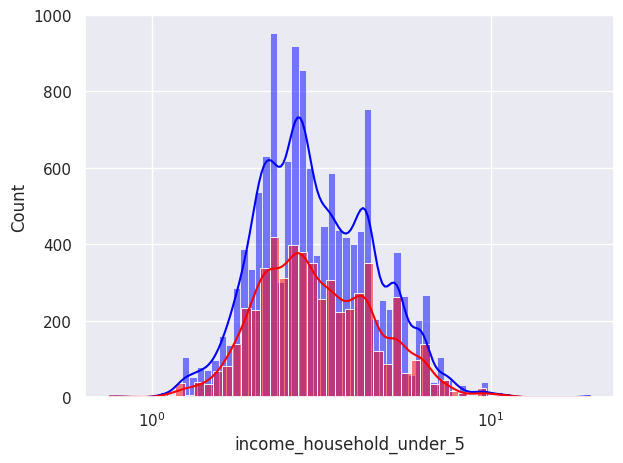

...

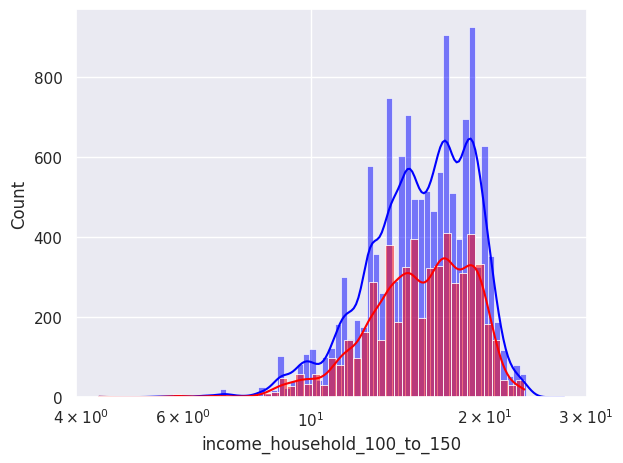

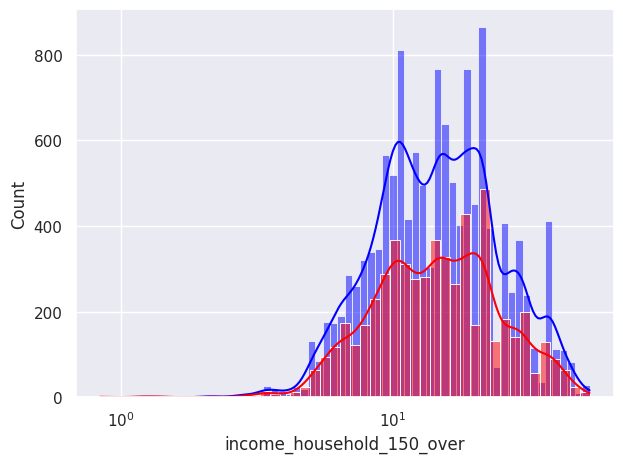

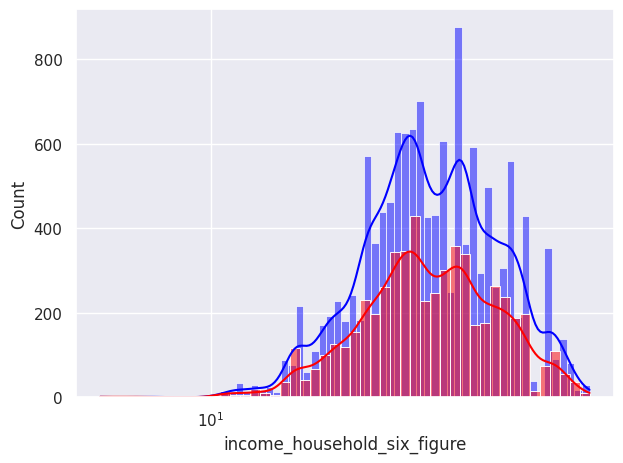

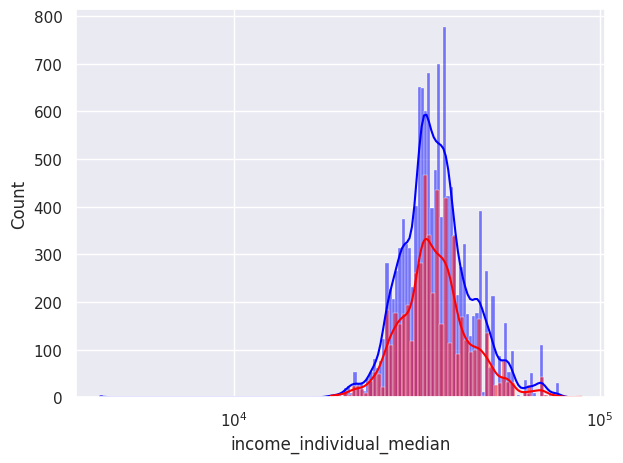

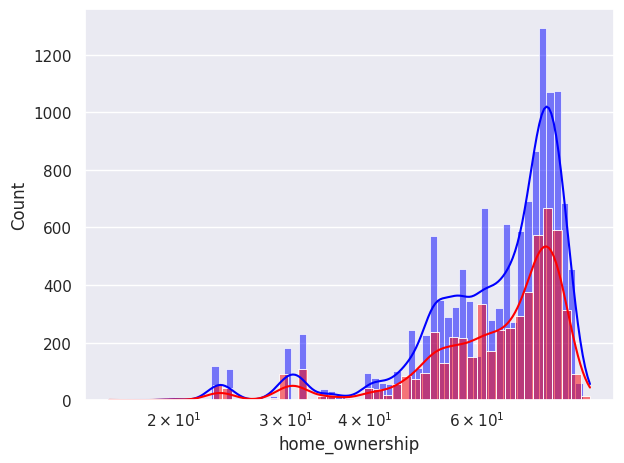

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


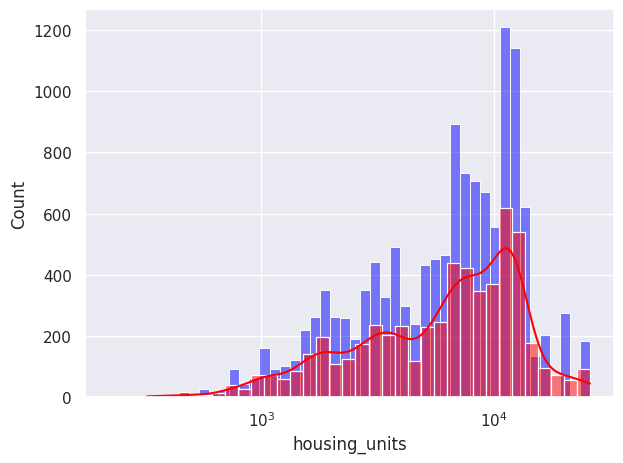

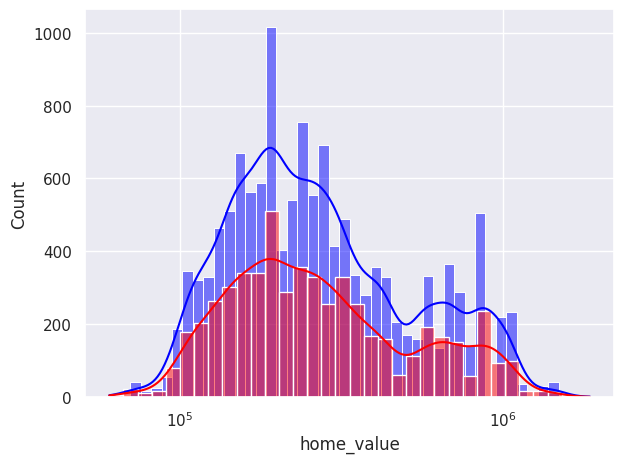

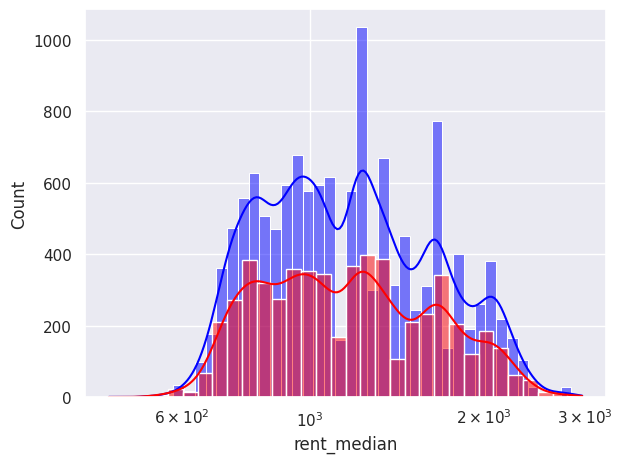

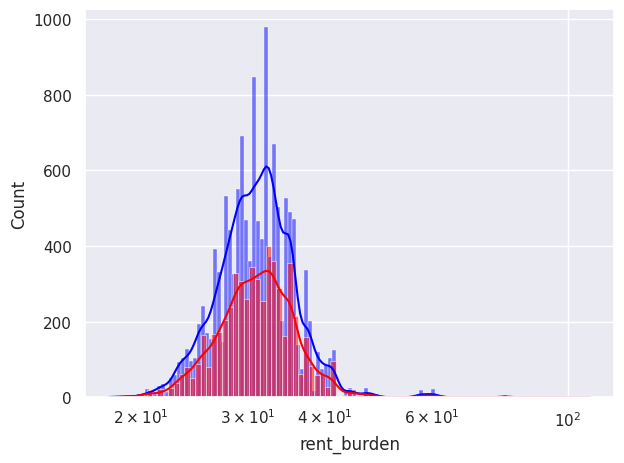

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


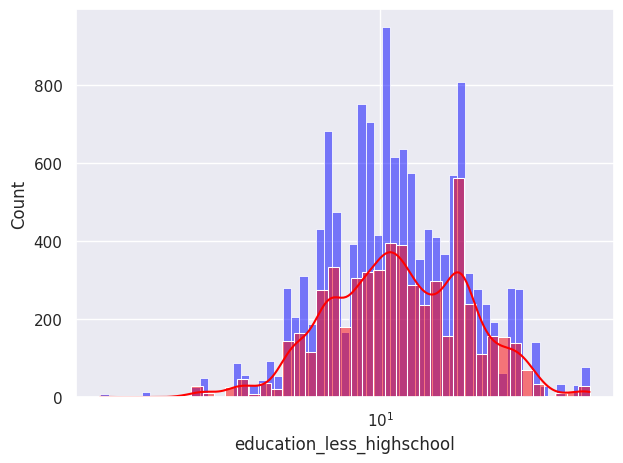

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


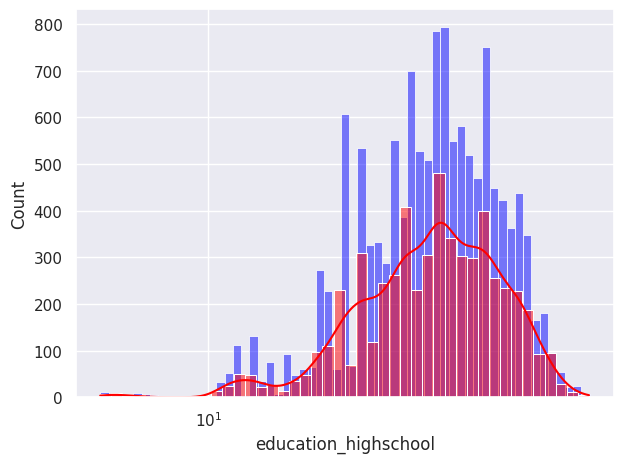

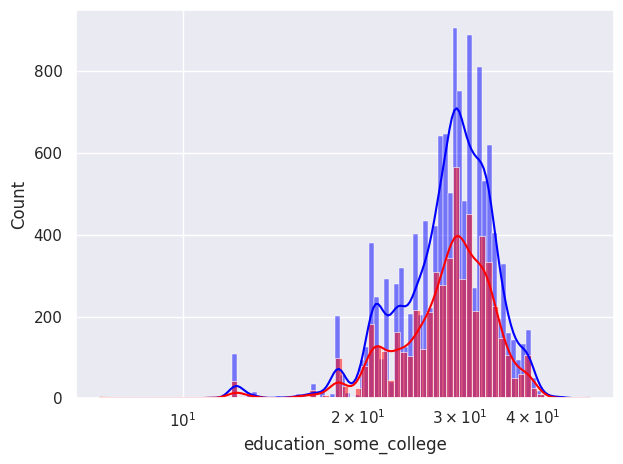

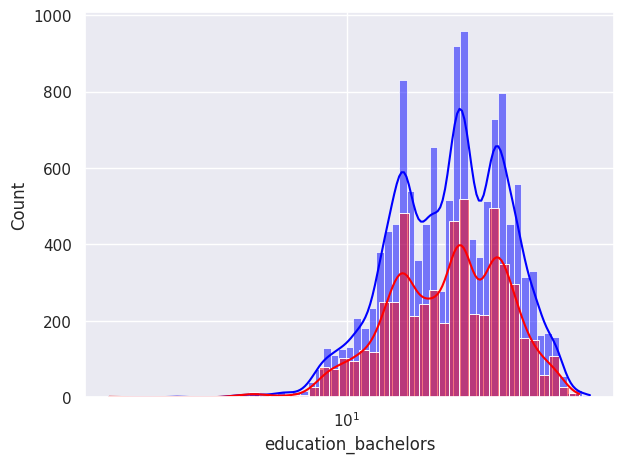

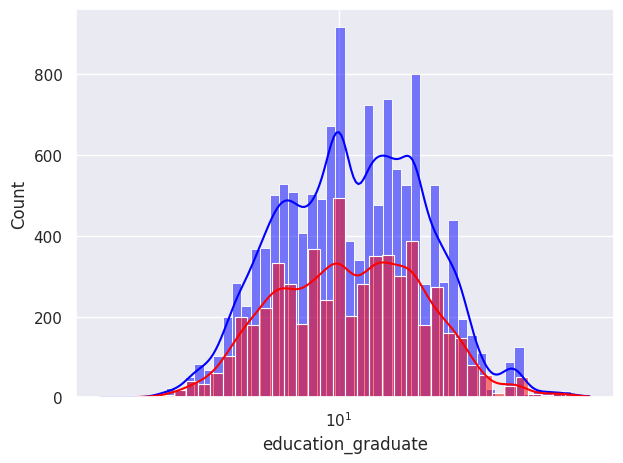

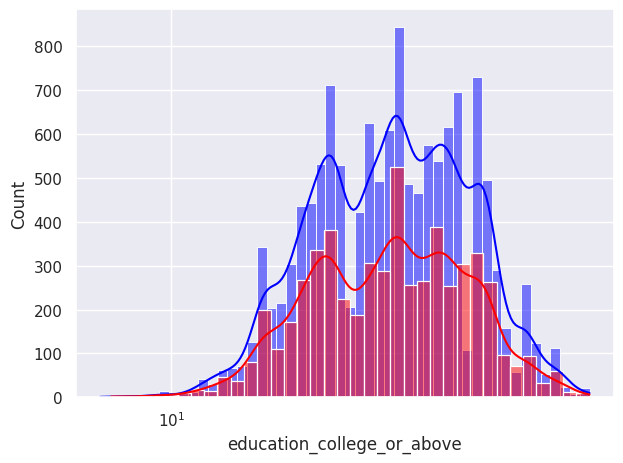

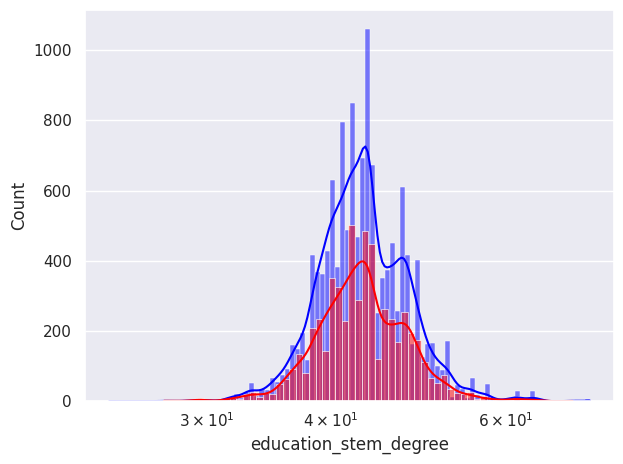

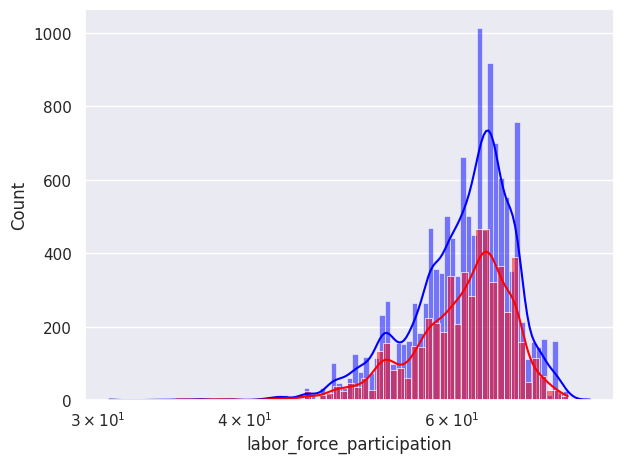

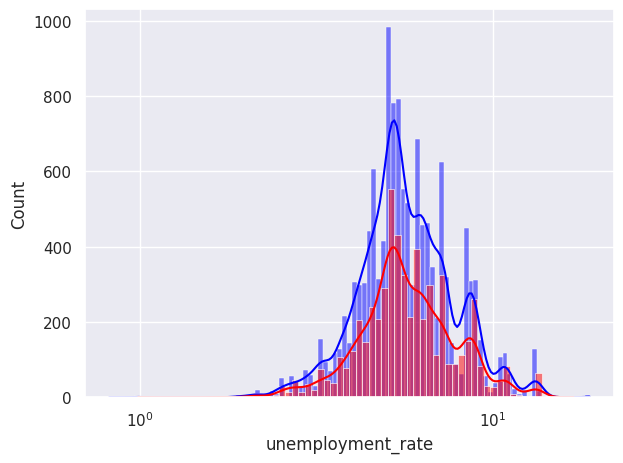

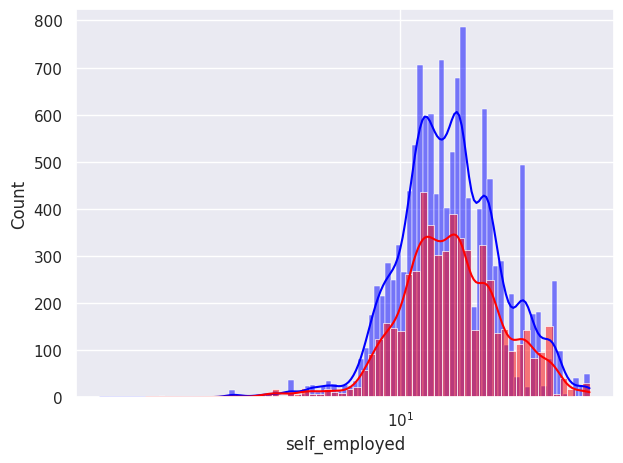

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


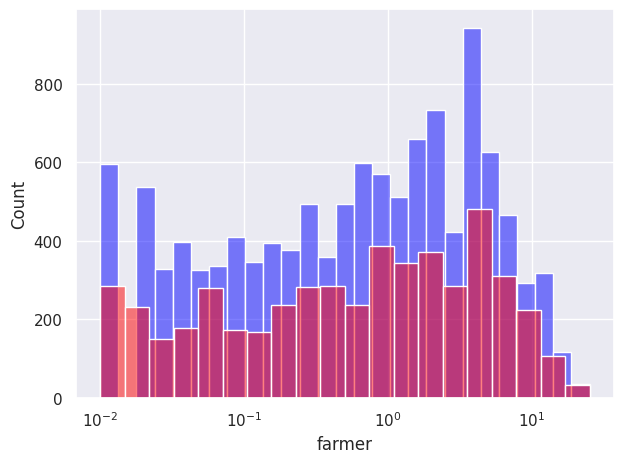

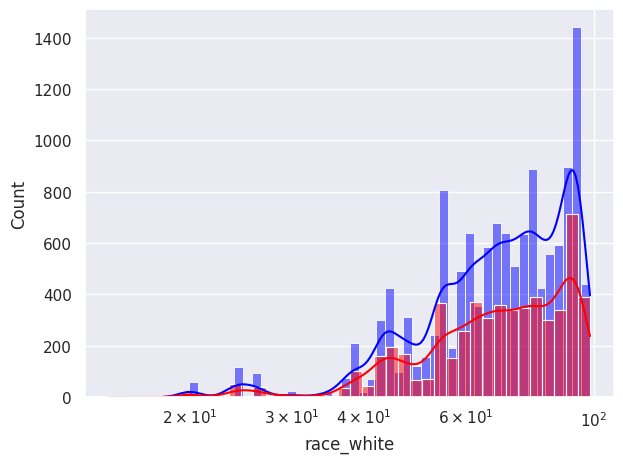

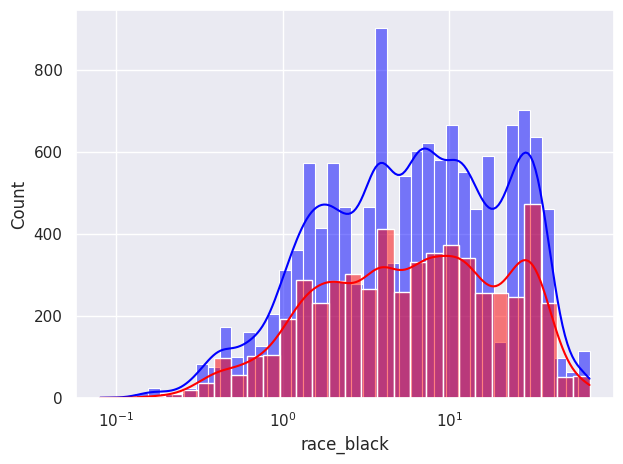

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


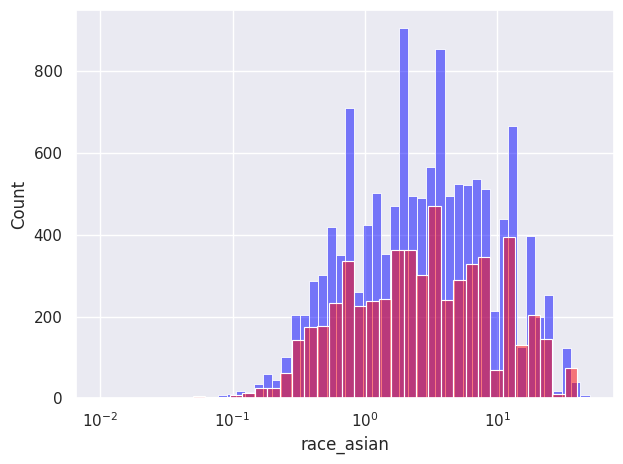

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


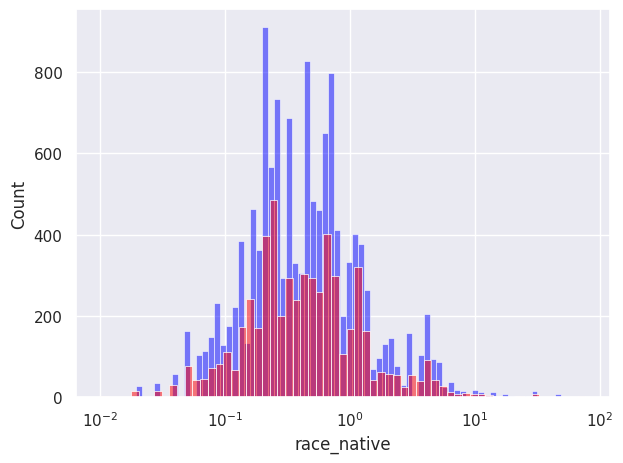

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


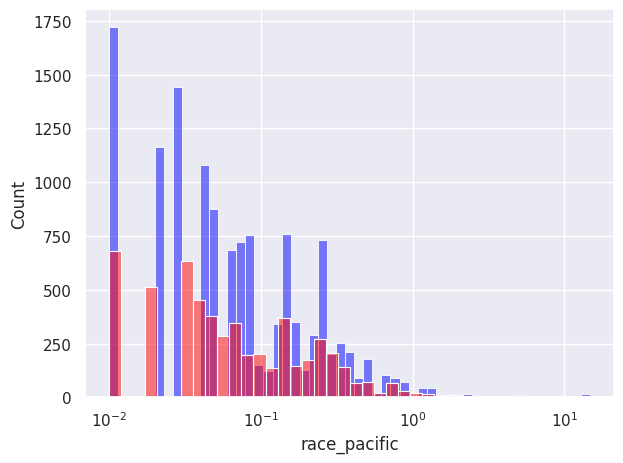

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


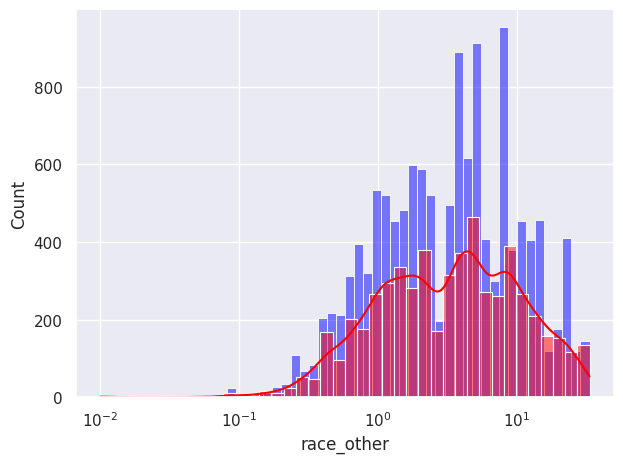

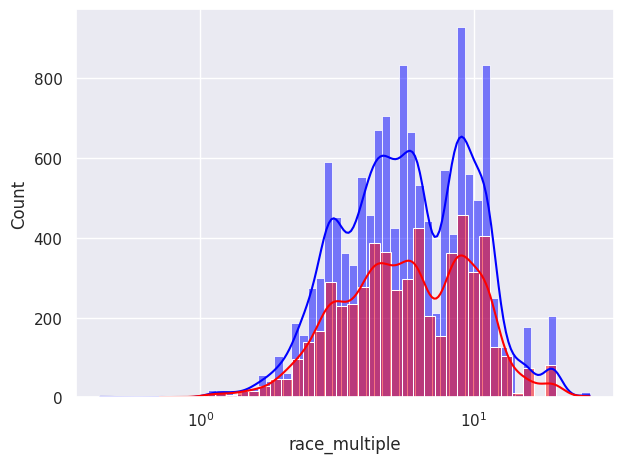

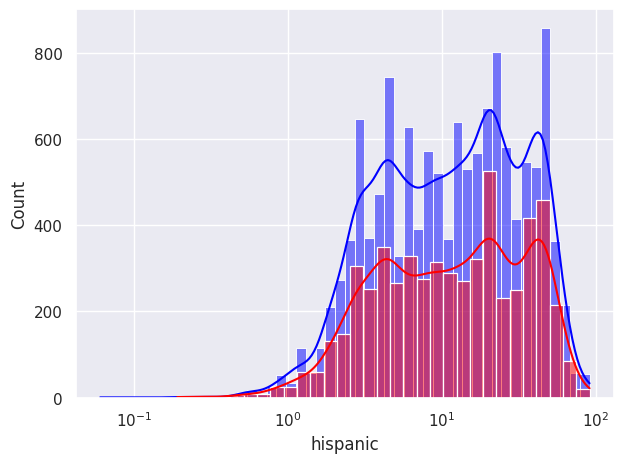

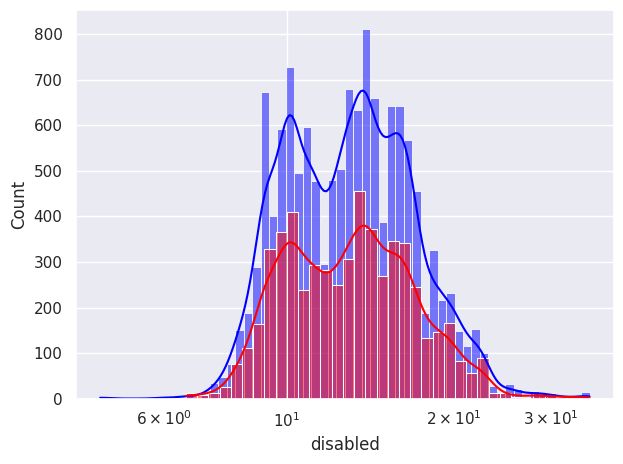

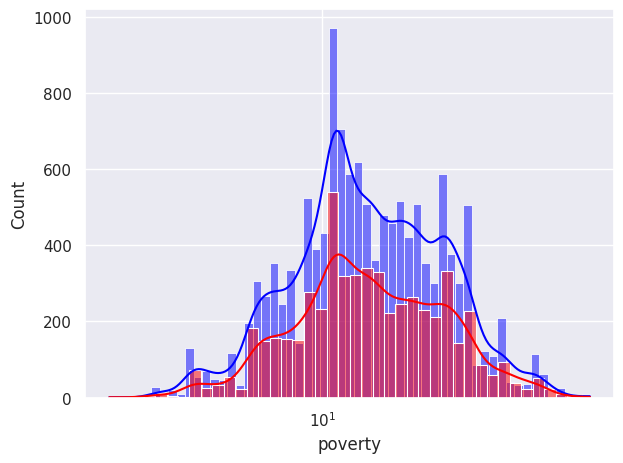

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)


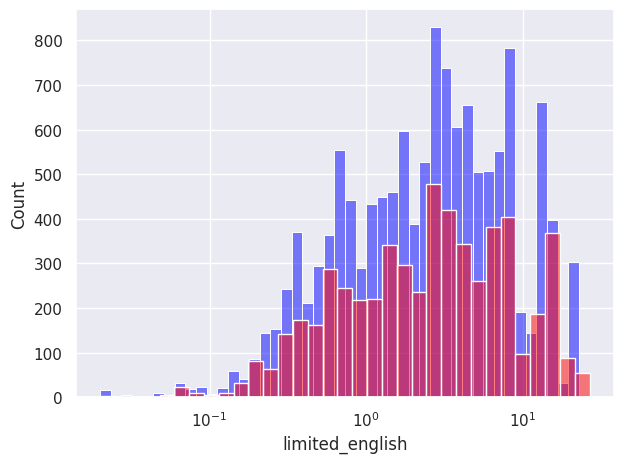

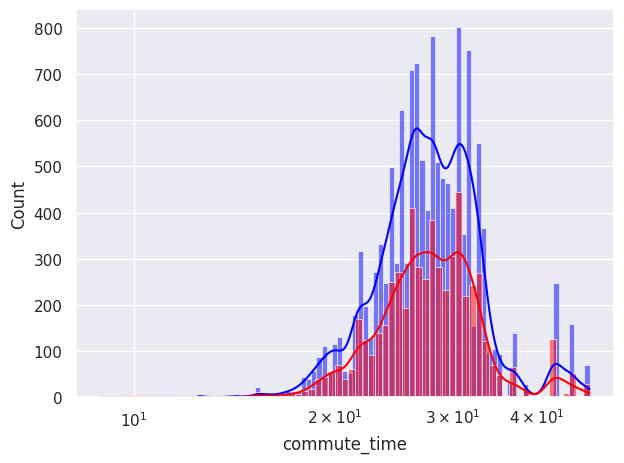

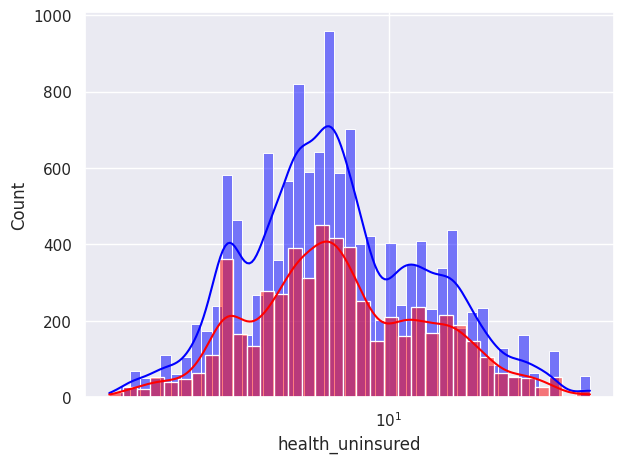

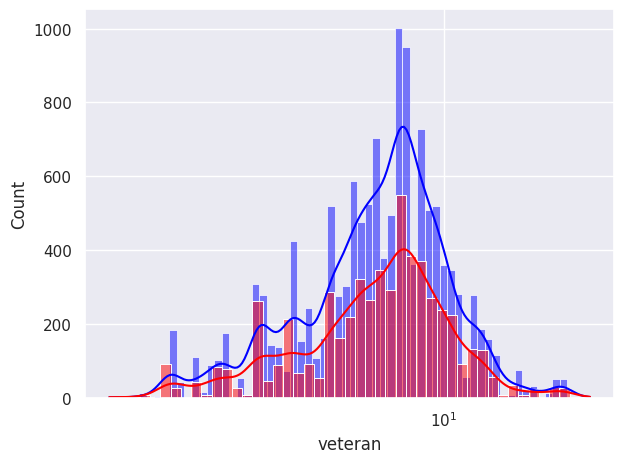

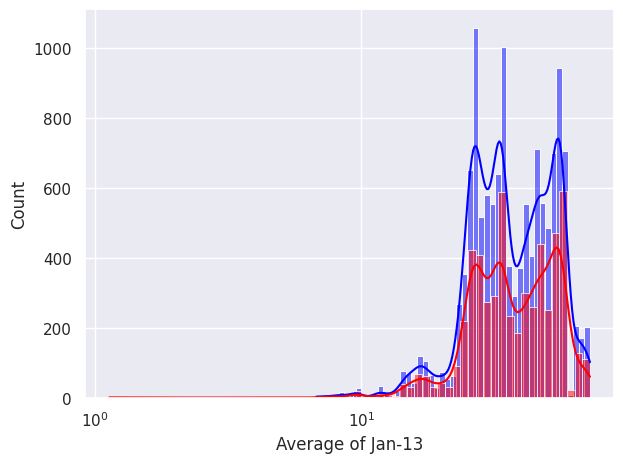

...

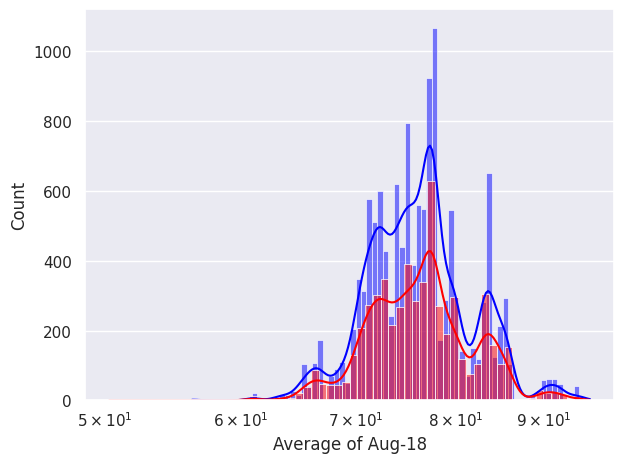

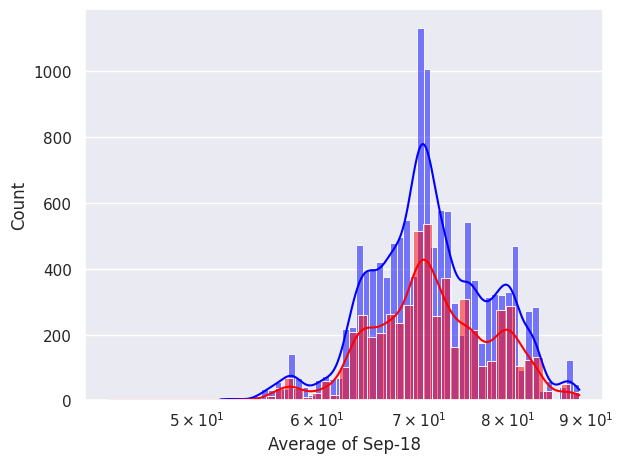

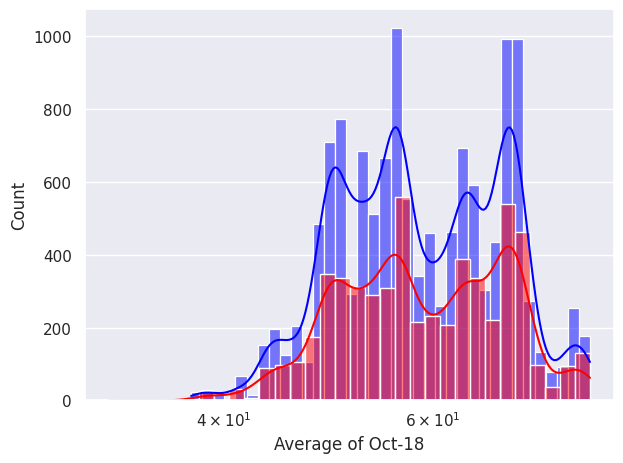

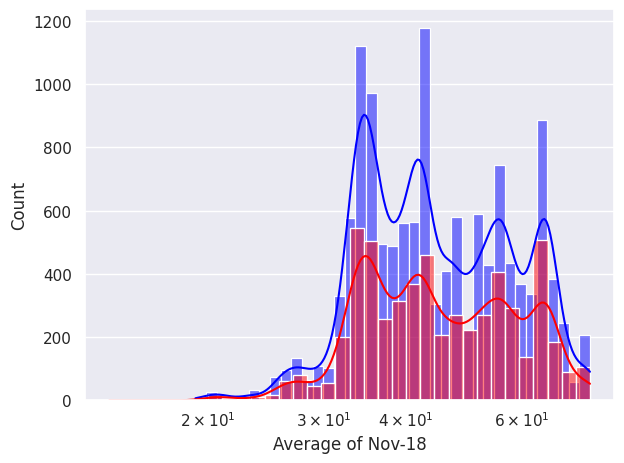

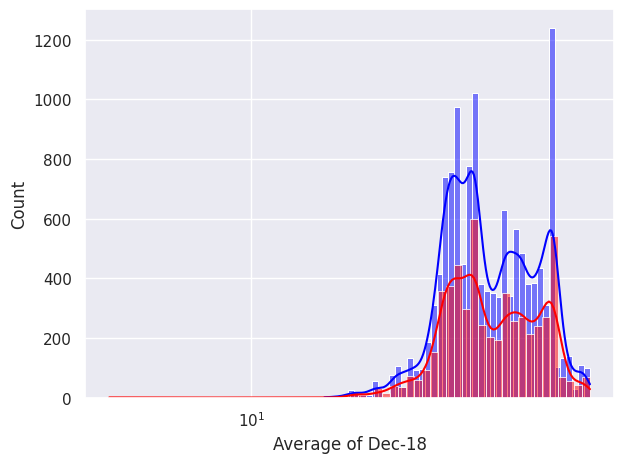

In [155]:
def plotfunction():
    for i in numerical_test:
        sns.histplot(numerical_train[i], color = 'Blue', kde = True, log_scale=True)
        sns.histplot(numerical_test[i], color= 'Red', kde = True, log_scale=True)
        plt.tight_layout()
        plt.show()


plotfunction()

#### Hypothesis from the above graphs
What can you conclude from the above graphs?
2) The Train and Test datasets have similar distributions for key features, suggesting that they are comparable in terms of their statistical properties which means that test dataset does not need any special preprocessing. Whatever we have applied on training dataset can also be applied on testing dataset.

# SECTION 3
## Data Cleaning and Preprocessing:

### - _Impute Missing values_
### - _Encode categorical columns into numerical_

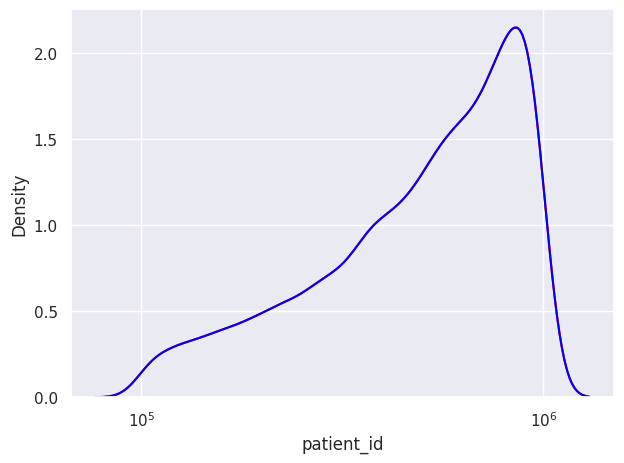

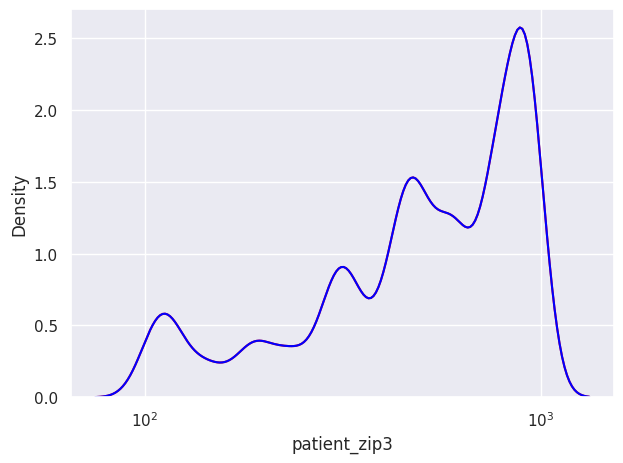

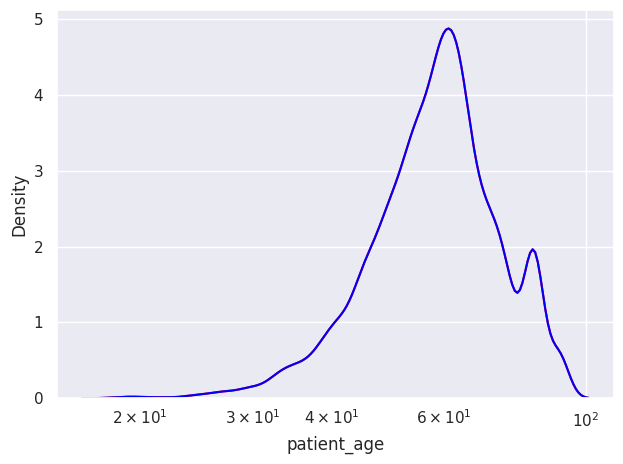

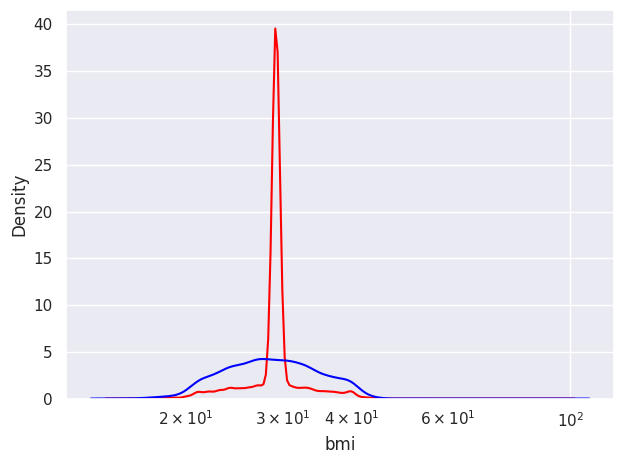

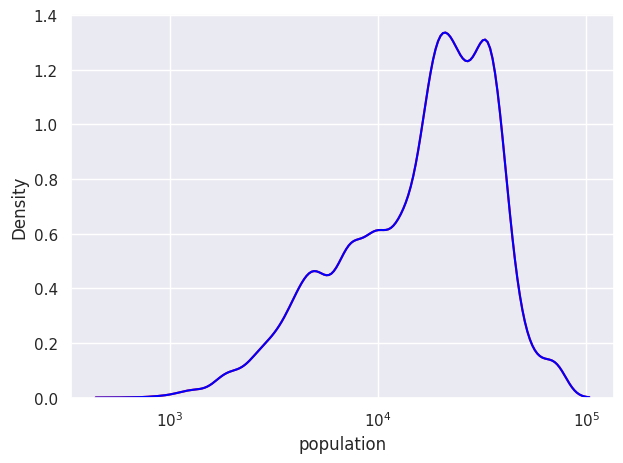

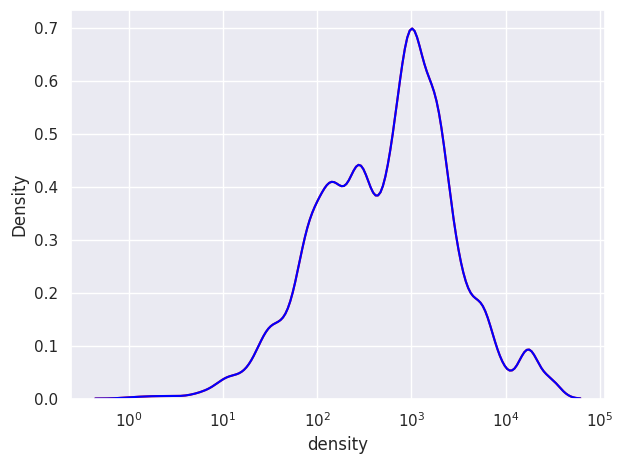

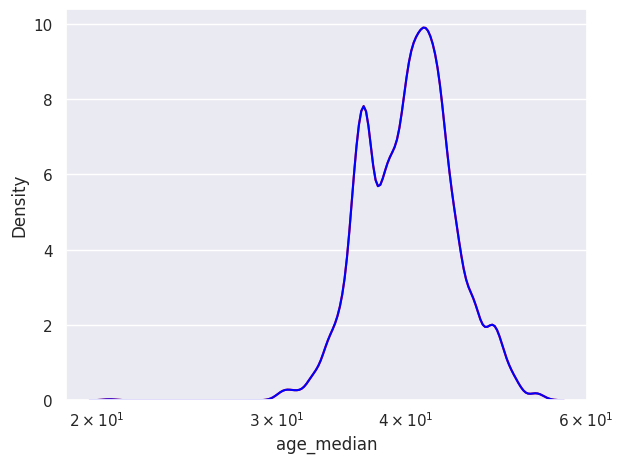

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


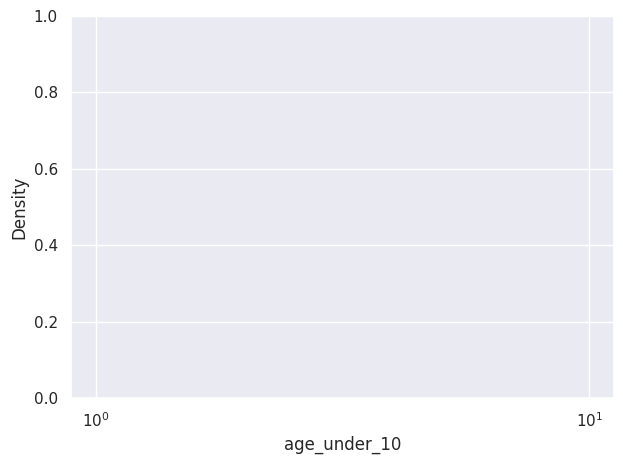

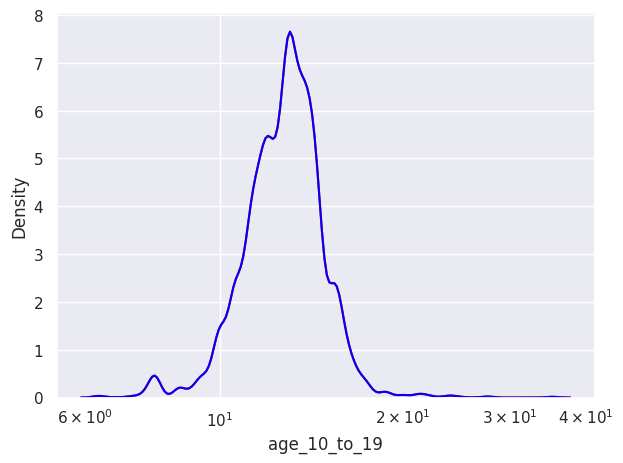

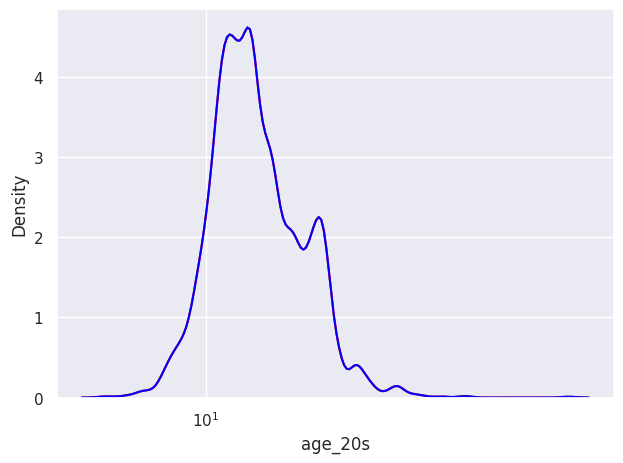

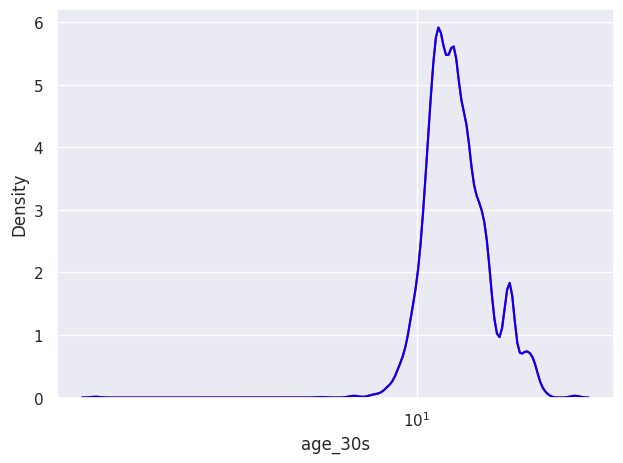

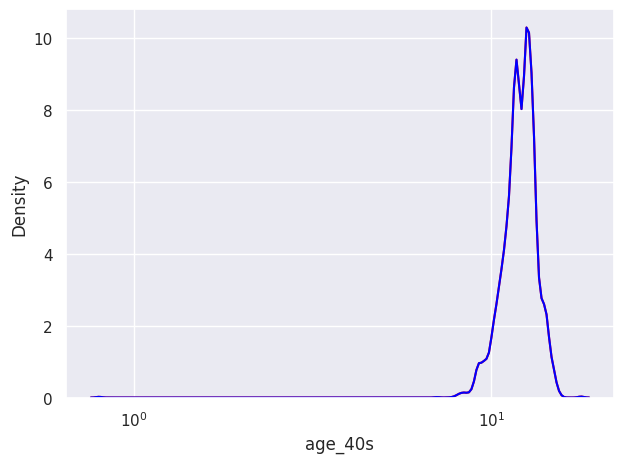

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


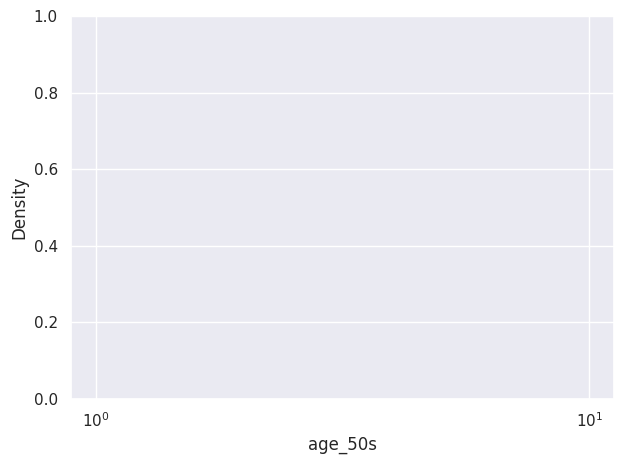

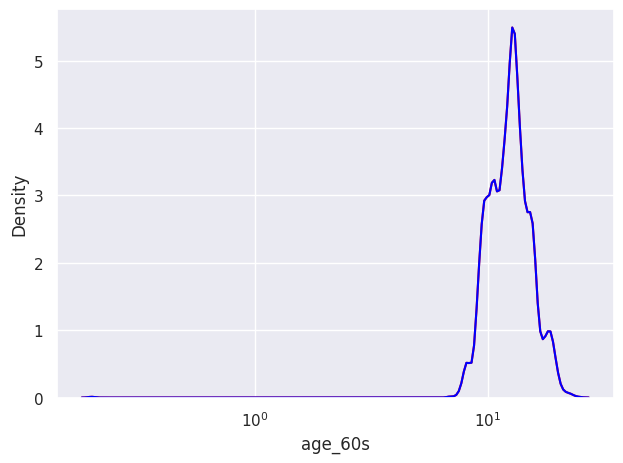

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


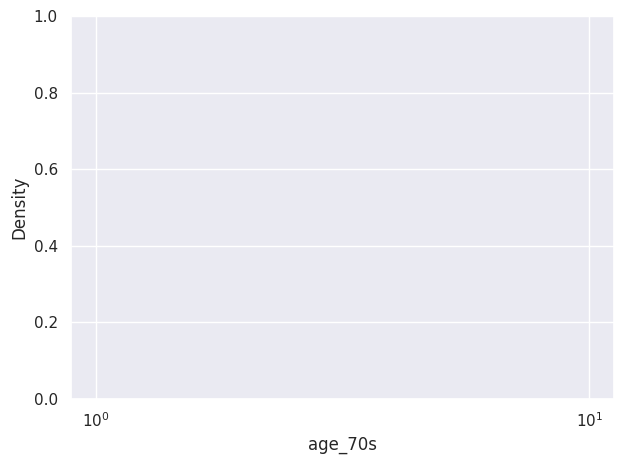

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


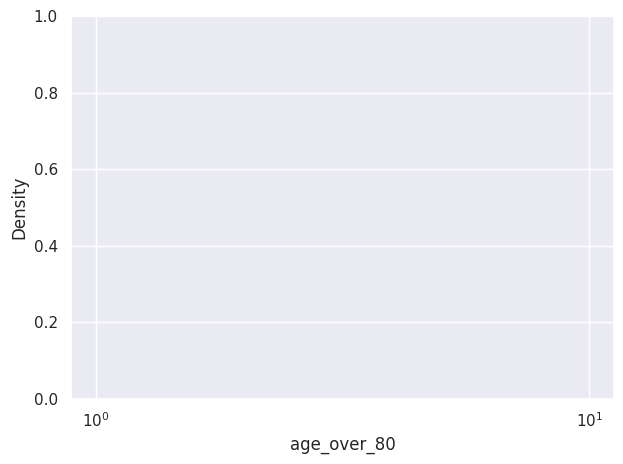

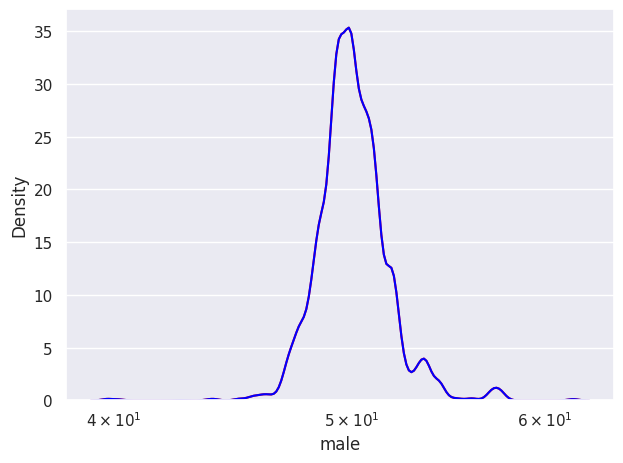

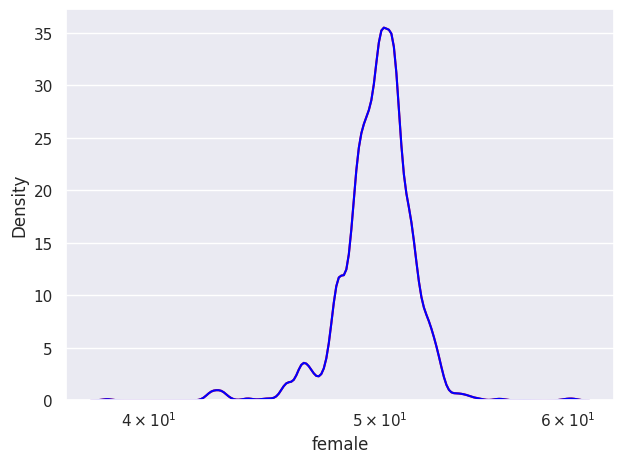

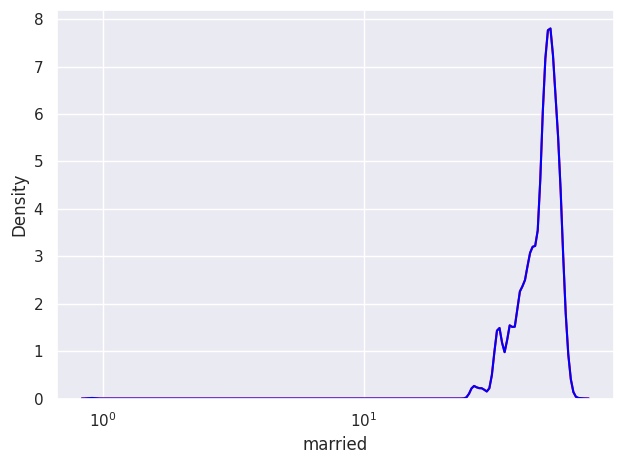

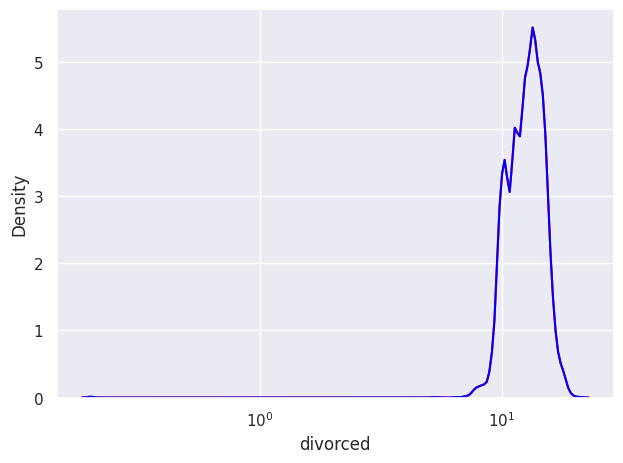

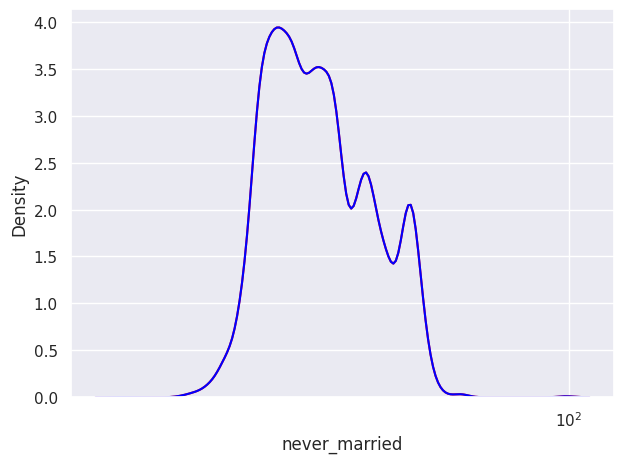

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


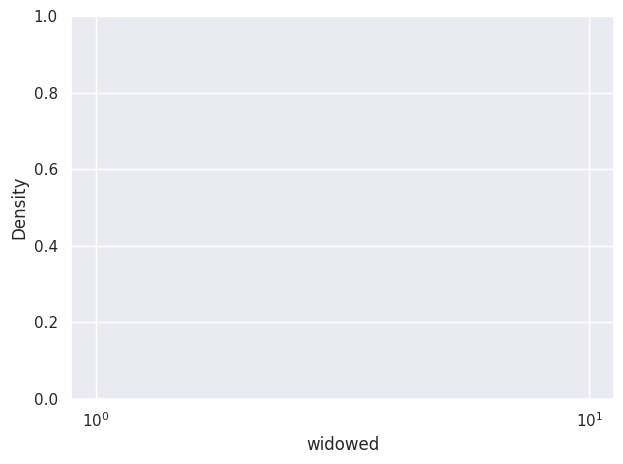

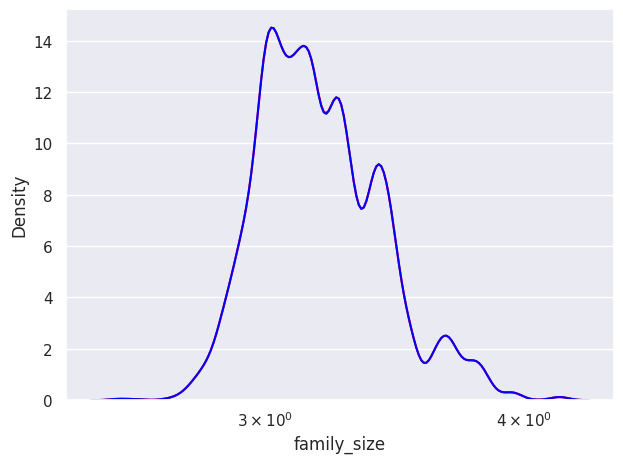

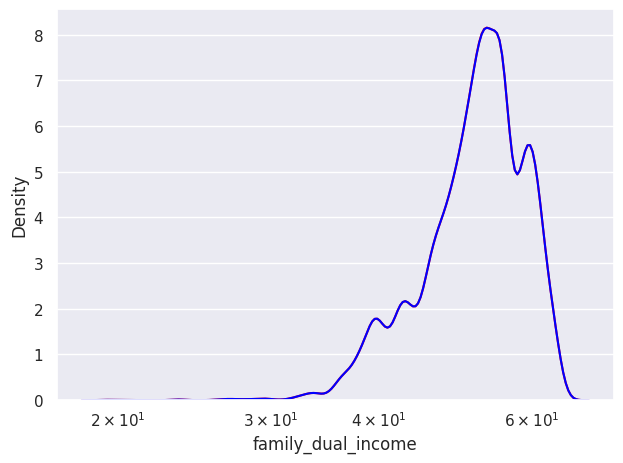

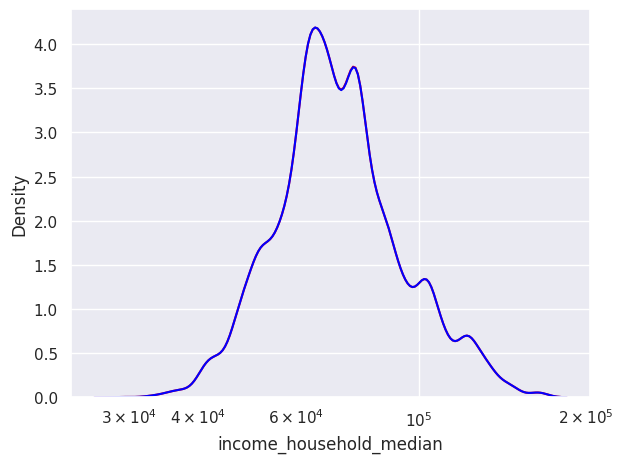

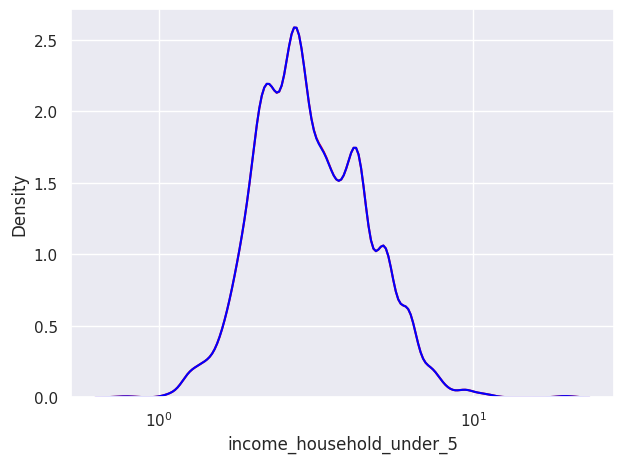

...

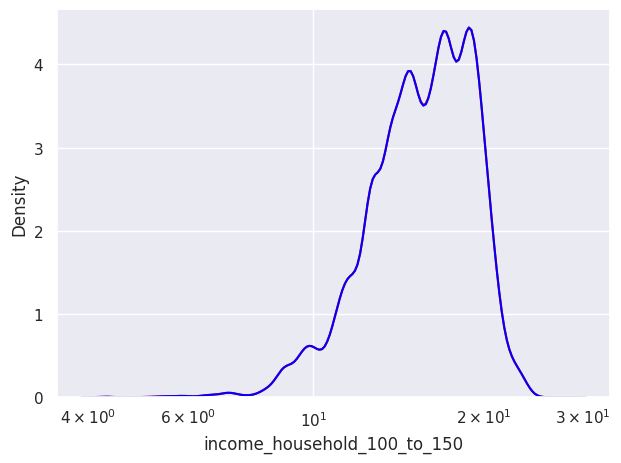

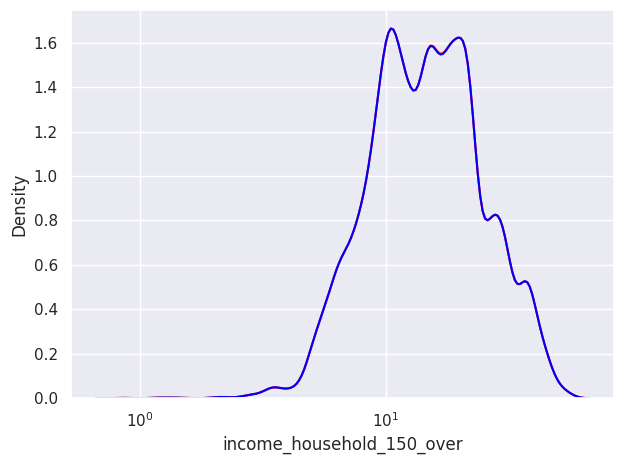

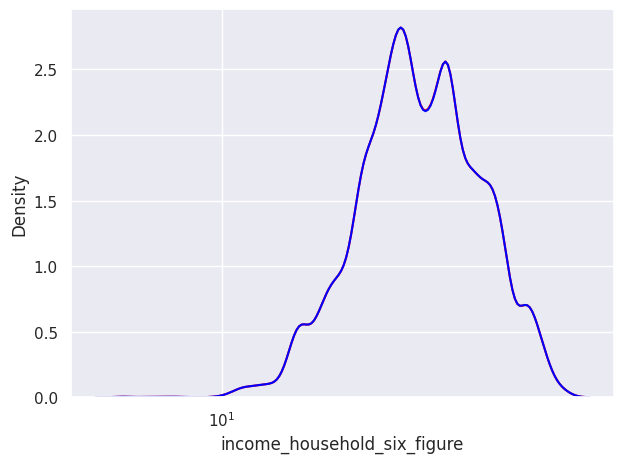

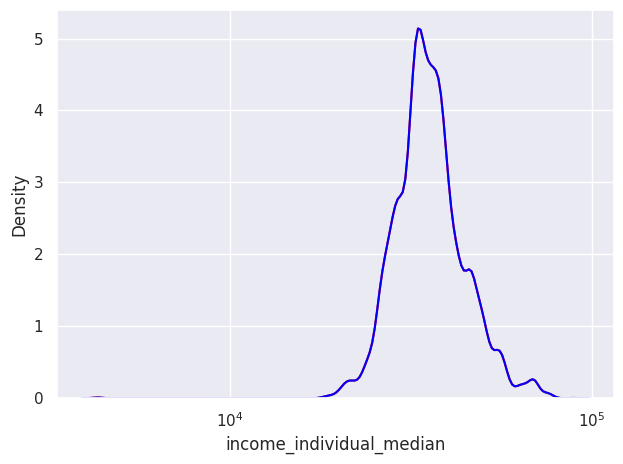

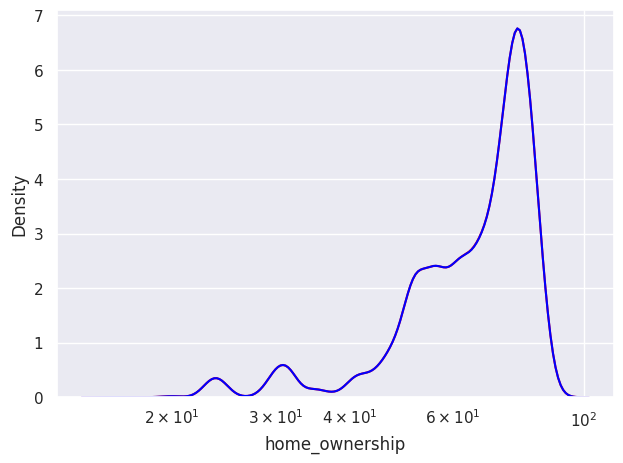

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


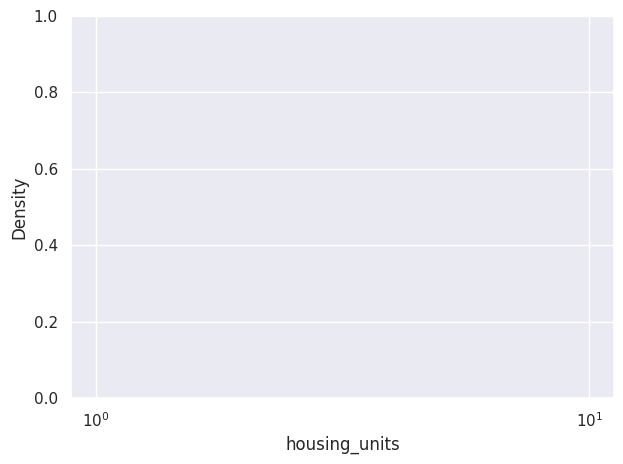

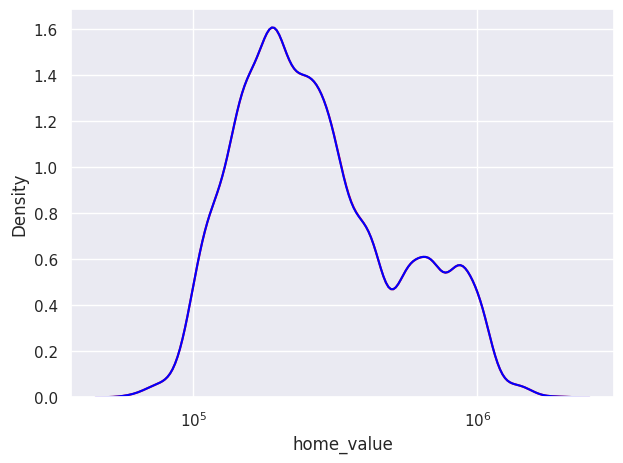

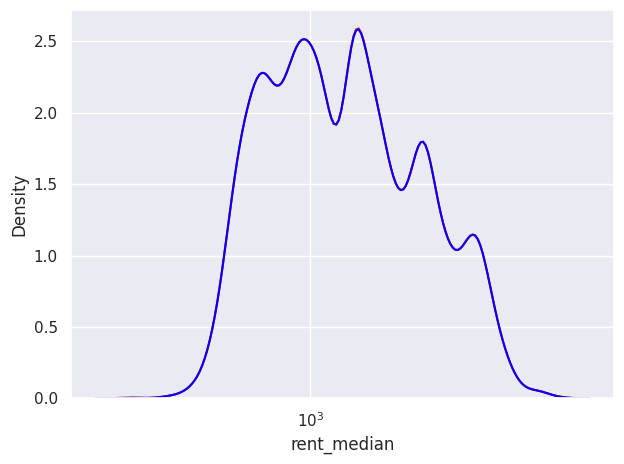

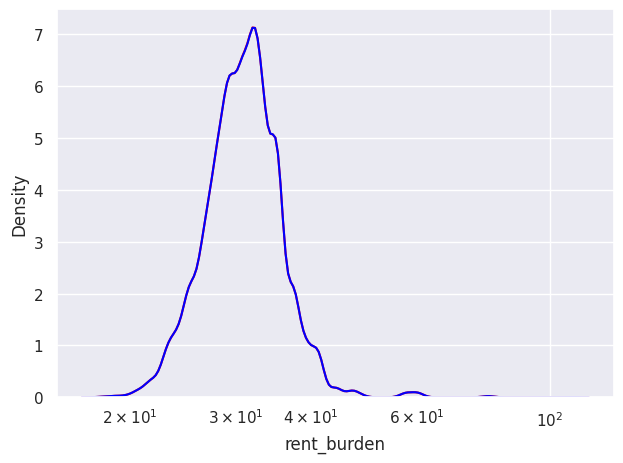

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


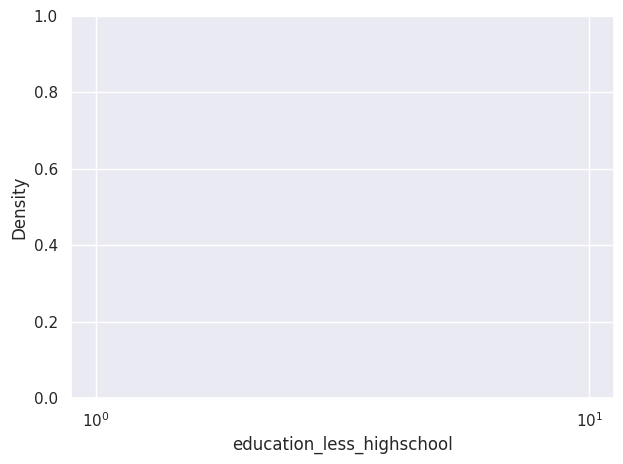

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


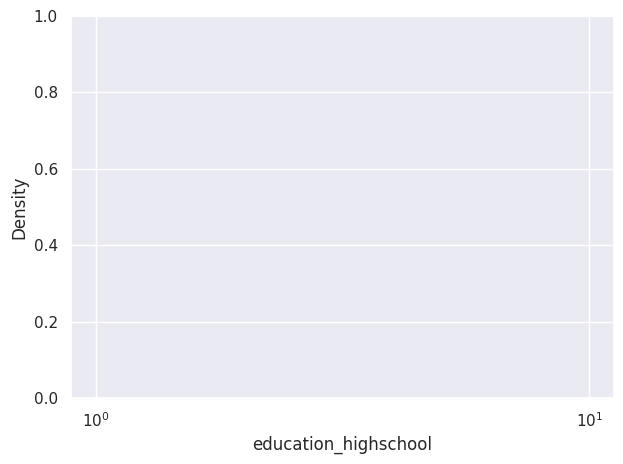

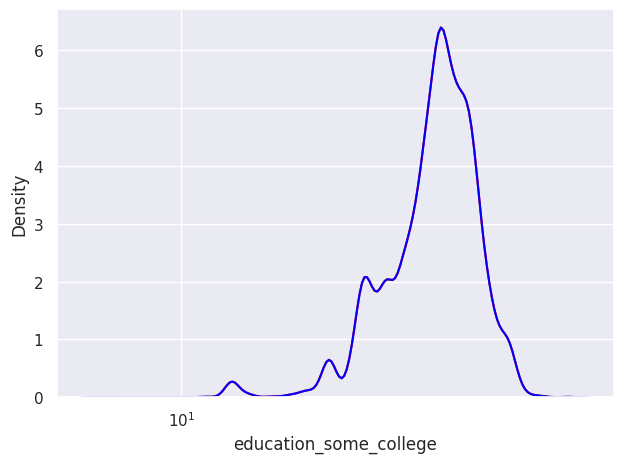

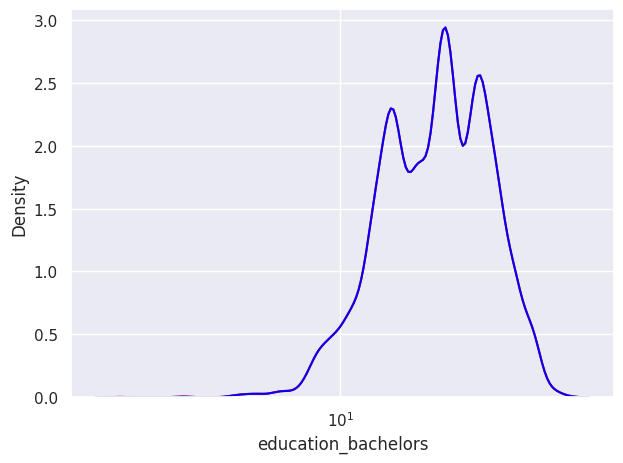

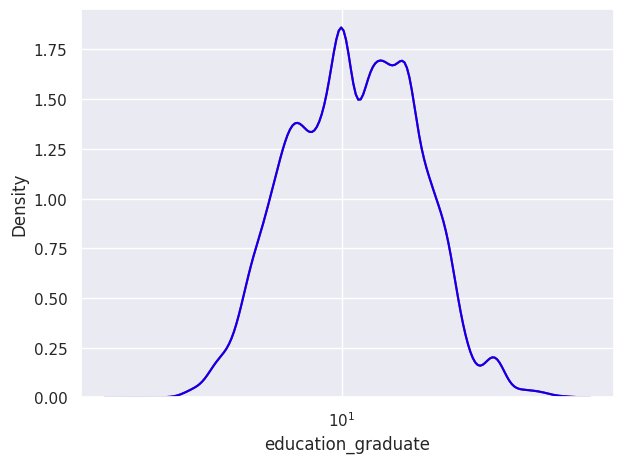

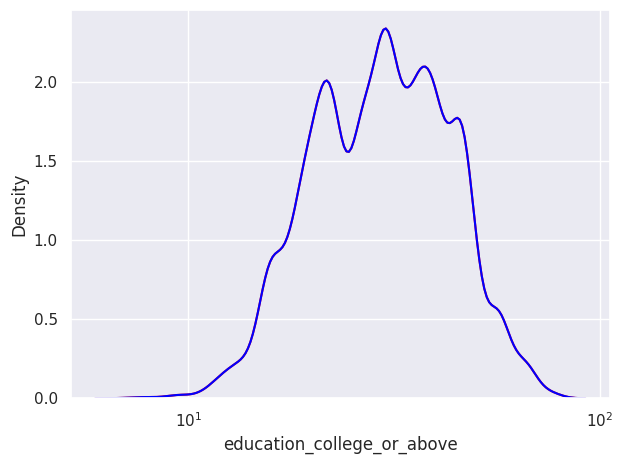

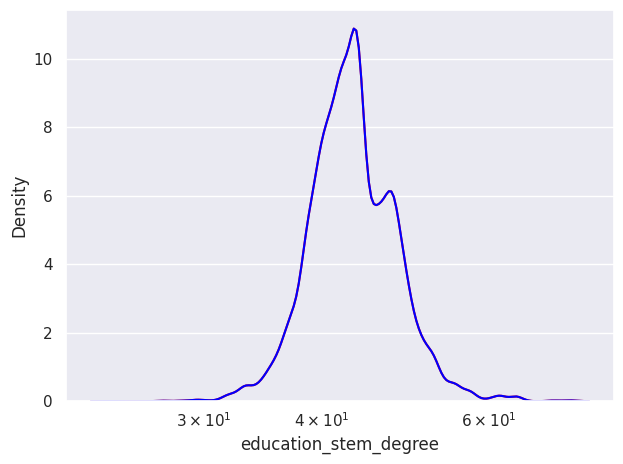

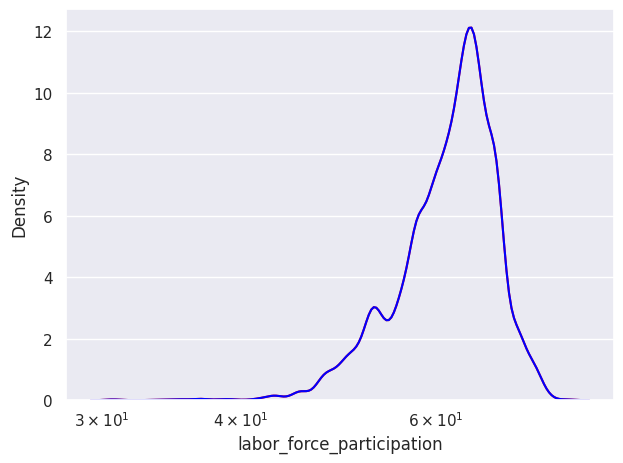

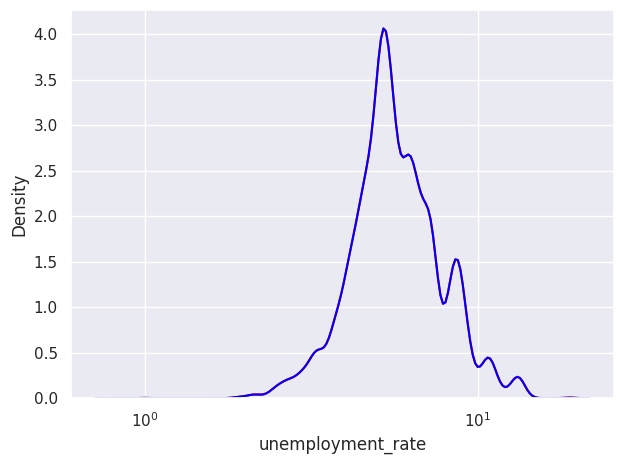

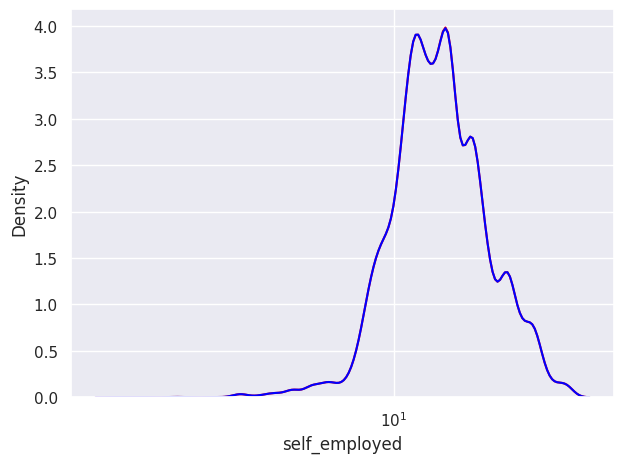

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


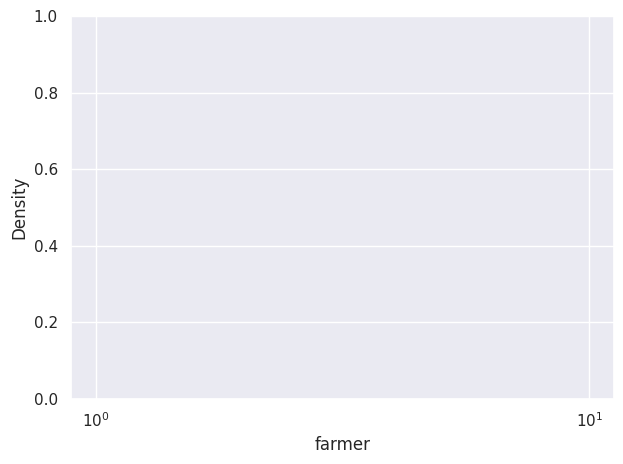

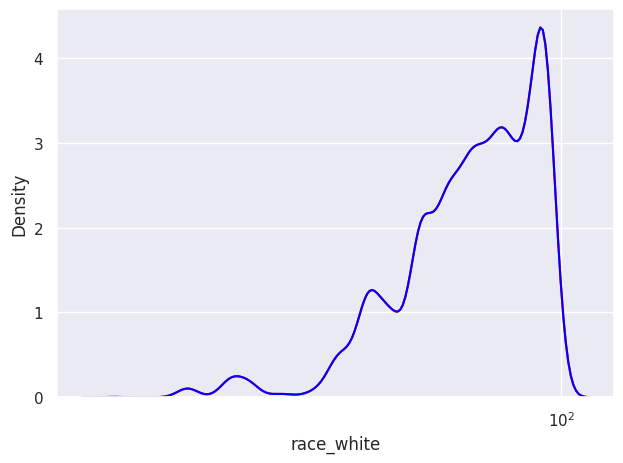

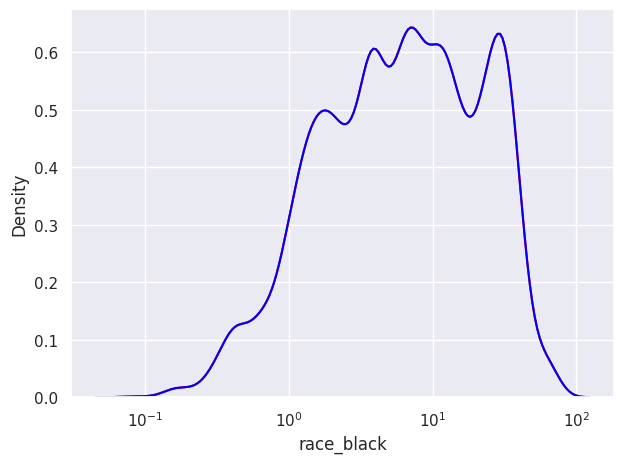

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


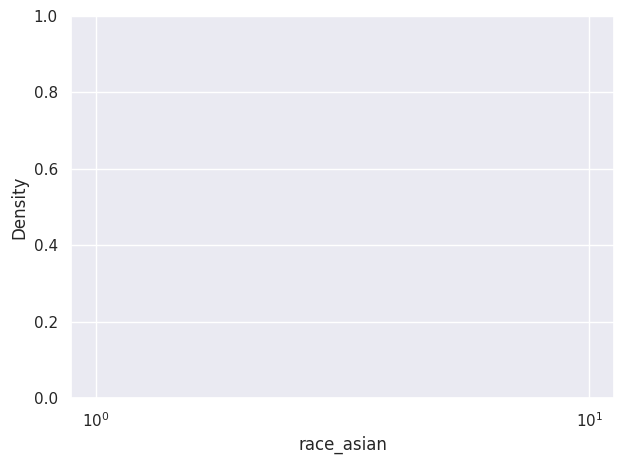

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


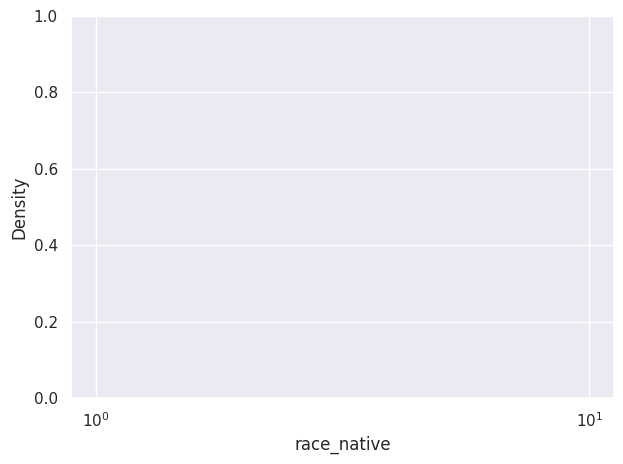

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


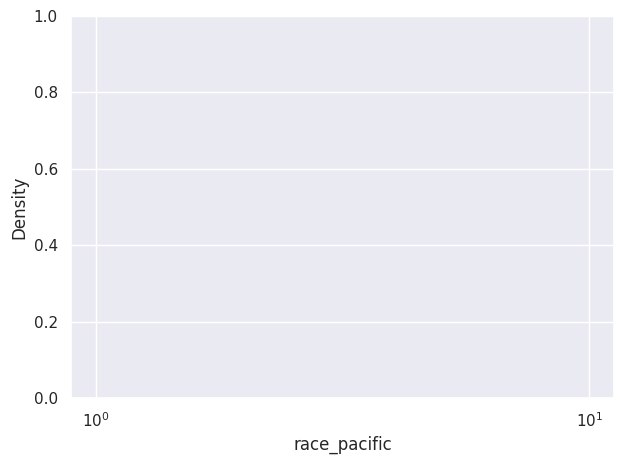

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


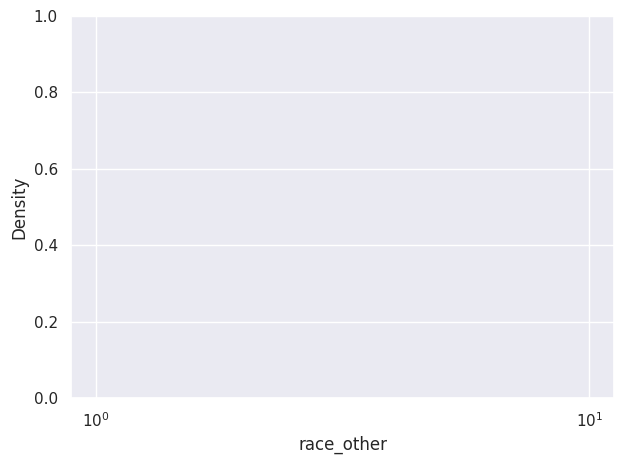

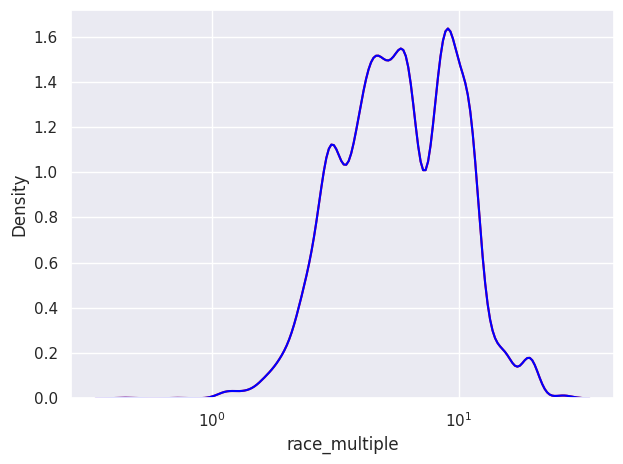

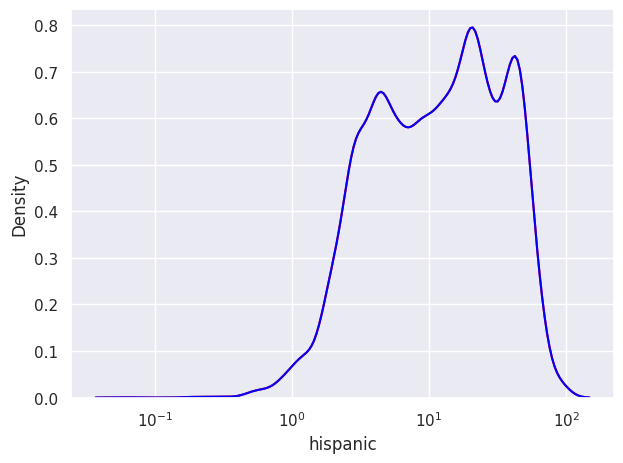

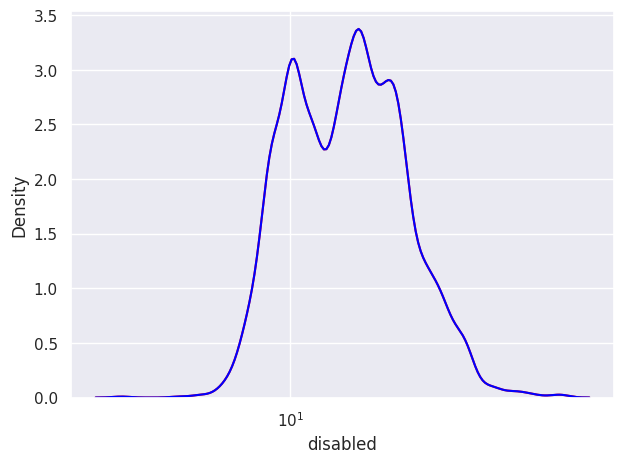

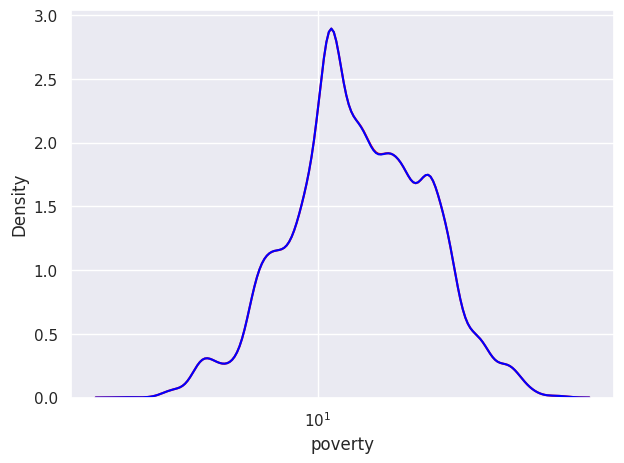

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


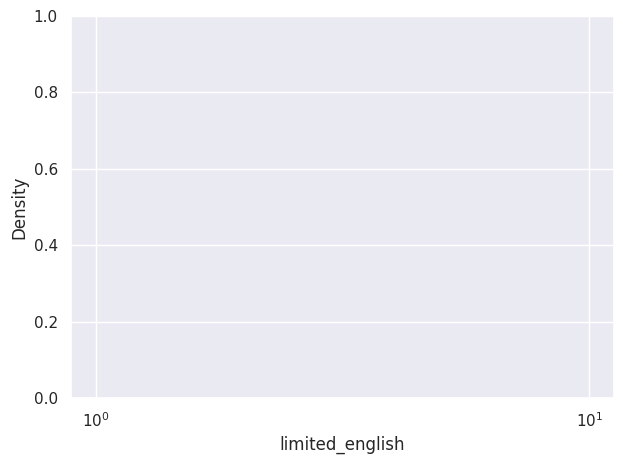

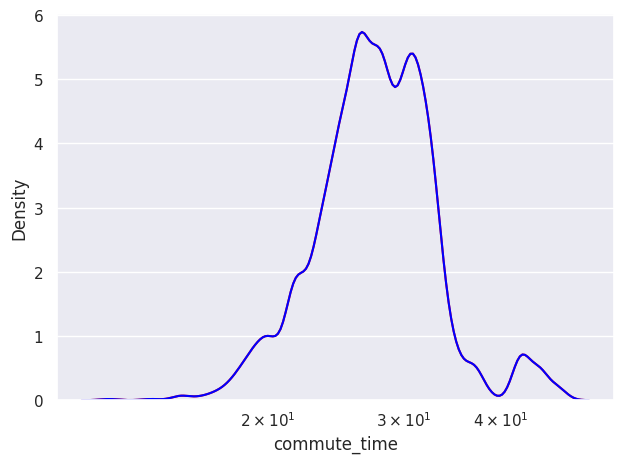

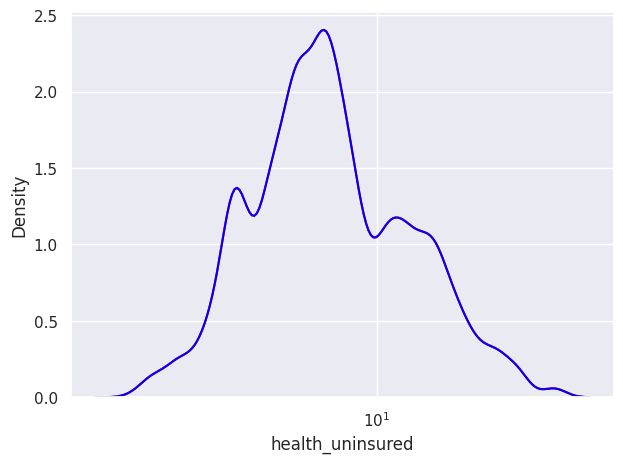

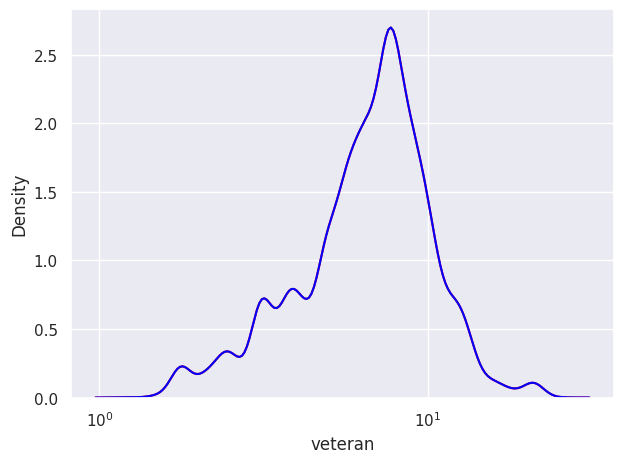

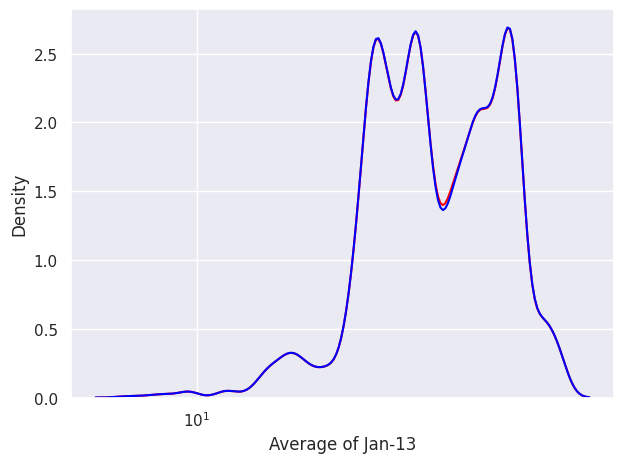

...

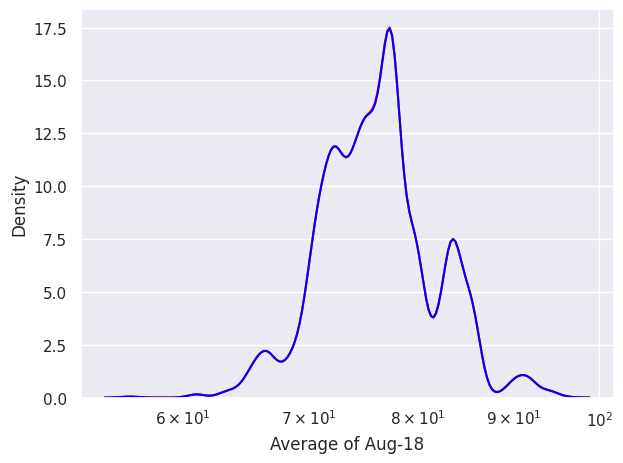

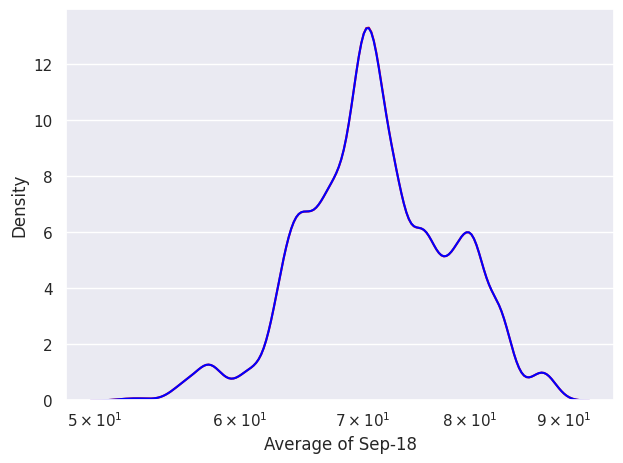

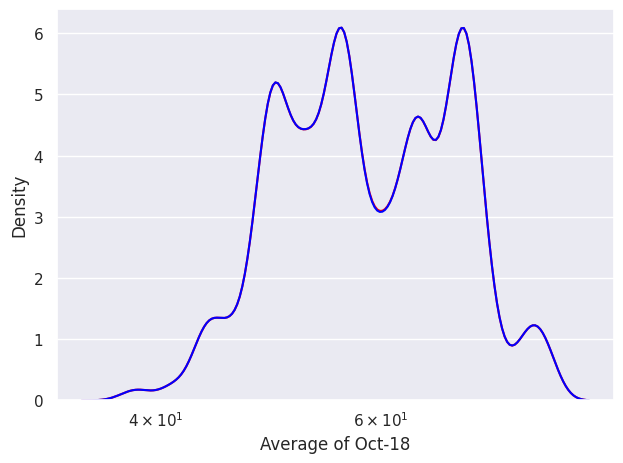

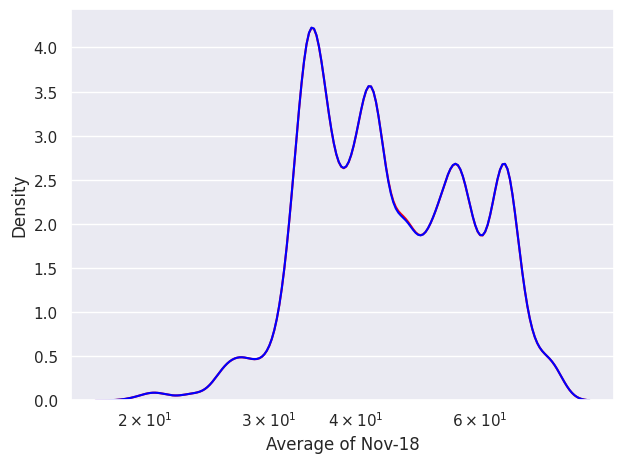

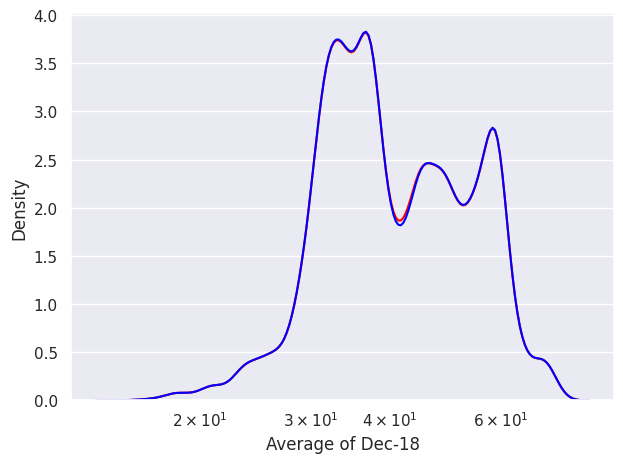

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:5: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(n_copy[i], color='red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_4489/1250730958.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


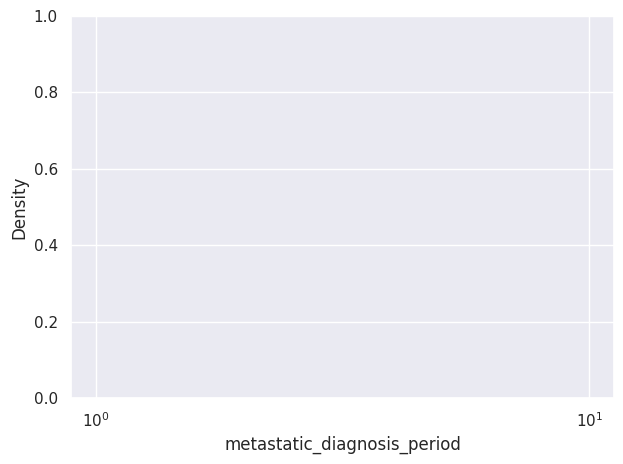

In [156]:
n_copy = numerical_train.copy()
n_copy.fillna(n_copy.mean(), inplace=True)

for i in n_copy:
    sns.kdeplot(n_copy[i], color='red', log_scale=True)
    sns.kdeplot(wids_train[i], color='blue', log_scale=True)
    plt.tight_layout()
    plt.show()

The distribution of `bmi` column exploded when imputed with mean values. We cannot use imputation techniques that result in such a high deviation from the original distribution. Let's try KNN imputation technique.

In [8]:
imputer = KNNImputer(n_neighbors= 4)
numerical_train = pd.DataFrame(imputer.fit_transform(numerical_train), columns=numerical_train.columns)
print(numerical_train)

       patient_id  patient_zip3  patient_age      bmi  population  density  \
0        268700.0         724.0         39.0  34.1050     3924.87    82.63   
1        484983.0         629.0         55.0  35.3600     2745.39    51.79   
2        277055.0         925.0         59.0  26.8025    38343.18   700.34   
3        320055.0         900.0         59.0  28.7450    36054.12  5294.33   
4        190386.0         934.0         71.0  25.4075    13700.37   400.48   
...           ...           ...          ...      ...         ...      ...   
13168    588544.0         191.0         59.0  27.2350    31948.46  5512.17   
13169    393047.0         757.0         73.0  30.6700     9309.38   204.69   
13170    790904.0         928.0         19.0  22.5425    39121.88  2295.94   
13171    455518.0         481.0         52.0  29.0875    23266.06   743.56   
13172    379418.0         900.0         63.0  22.1200    36054.12  5294.33   

       age_median  age_under_10  age_10_to_19  age_20s  ...  \


In [9]:
prev_skewness = numerical_train.skew(axis = 0)
print(prev_skewness)

patient_id                    -0.022242
patient_zip3                  -0.105417
patient_age                    0.156724
bmi                            0.938133
population                     0.970058
                                 ...   
Average of Sep-18              0.176731
Average of Oct-18              0.232572
Average of Nov-18              0.481594
Average of Dec-18              0.472060
metastatic_diagnosis_period    0.924862
Length: 141, dtype: float64


We will use KNNImputer for categorical_train as well

In [44]:
categorical_train.columns

Index(['patient_race', 'payer_type', 'patient_state', 'Region', 'Division',
       'patient_gender', 'breast_cancer_diagnosis_code',
       'breast_cancer_diagnosis_desc', 'metastatic_cancer_diagnosis_code',
       'metastatic_first_novel_treatment',
       'metastatic_first_novel_treatment_type'],
      dtype='object')

#### LOFO Importance: Leave One Feature Importance
-> Package description: Calculates RMSE for every iteration where a new column is dropped. Gives an equivalent importance_mean score to the dropped column.

In [ ]:
wids_train = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/train.csv')
wids_test = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/test.csv')
total_data = pd.concat([wids_train, wids_test], keys=["train", "test"])
copydata = total_data.copy()

# One-hot encode categorical variables
copydata = pd.get_dummies(copydata, drop_first=True)

# Split the combined data back into train and test sets
train = copydata[:len(wids_train)]
test = copydata[len(wids_train):].drop(columns=['metastatic_diagnosis_period'])

# Split train into x_train and y_train
y_train = train['metastatic_diagnosis_period']
x_train = train.drop(columns=['metastatic_diagnosis_period'])

# Create a LOFO Dataset excluding the target variable from the features
dataset = Dataset(df=train, target='metastatic_diagnosis_period', features=list(x_train.columns))

# Initialize the LOFOImportance object
lofo_imp = LOFOImportance(dataset, scoring="neg_mean_squared_error", model=HistGradientBoostingRegressor())

# Calculate LOFO importance
importance_df = lofo_imp.get_importance()

In [ ]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    print(importance_df)

## Feature Importance Analysis

The following table lists the features along with their corresponding importance scores. The feature importance score is a measure of the impact each feature has on the model's predictions. Higher values indicate greater importance.

| Feature                                                                             | Importance Score |
|-------------------------------------------------------------------------------------|------------------|
| patient_age                                                                         | 178.257288       |
| breast_cancer_diagnosis_desc_Malignant neoplasm of upper-outer quadrant of breast   | 176.027515       |
| metastatic_cancer_diagnosis_code_C7981                                              | 21.884970        |
| Average of Sep-17                                                                   | 20.120004        |
| metastatic_cancer_diagnosis_code_C7951                                              | 18.892153        |
| metastatic_cancer_diagnosis_code_C773                                               | 16.918443        |
| Average of Jan-14                                                                   | 12.306918        |
| Average of Mar-15                                                                   | 12.276198        |
| Average of Sep-15                                                                   | 9.863797         |
| age_median                                                                          | 9.833360         |
| health_uninsured                                                                    | 9.791305         |
| Average of May-14                                                                   | 9.587373         |
| Region_South                                                                        | 9.323918         |
| Average of Apr-17                                                                   | 8.654381         |
| Average of Feb-16                                                                   | 8.312575         |
| payer_type_MEDICAID                                                                 | 8.085514         |
| Average of Mar-14                                                                   | 7.941062         |
| payer_type_MEDICARE ADVANTAGE                                                       | 7.386194         |
| race_pacific                                                                        | 7.372193         |
| Average of Apr-15                                                                   | 7.065266         |
| metastatic_cancer_diagnosis_code_C779                                               | 6.643900         |
| metastatic_cancer_diagnosis_code_C7800                                              | 6.551982         |
| Average of Jun-18                                                                   | 5.651702         |
| Average of Oct-17                                                                   | 5.362431         |
| race_other                                                                          | 5.250596         |
| race_black                                                                          | 4.491563         |
| patient_race_Other                                                                  | 4.329428         |
| Average of Mar-13                                                                   | 3.626045         |
| race_asian                                                                          | 3.509919         |
| Average of Aug-17                                                                   | 3.088123         |
| education_bachelors                                                                 | 2.448217         |
| Average of Jul-15                                                                   | 2.296253         |
| Average of Jun-13                                                                   | 2.199799         |
| Average of Jan-15                                                                   | 1.812178         |
| Average of Apr-14                                                                   | 1.793807         |
| metastatic_cancer_diagnosis_code_C7802                                              | 1.483379         |
| breast_cancer_diagnosis_code_C50312                                                 | 1.182073         |
| Average of Feb-17                                                                   | 1.105117         |
| Average of Feb-14                                                                   | 1.043663         |
| limited_english                                                                     | 0.835865         |
| Average of Aug-14                                                                   | 0.228922         |
| Average of Aug-13                                                                   | 0.061754         |
| **Features with Zero Importance Score**                                             | **0.000000**     |
| breast_cancer_diagnosis_code_C50912                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of axillary tail of breast          | 0.000000         |
| breast_cancer_diagnosis_code_C5041                                                  | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of lower-inner quadrant of breast       | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of lower-outer quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of breast unspecified               | 0.000000         |
| breast_cancer_diagnosis_code_1743                                                   | 0.000000         |
| breast_cancer_diagnosis_code_C50219                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of central portion of breast        | 0.000000         |
| breast_cancer_diagnosis_code_C50512                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50811                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of overlapping sites of breast      | 0.000000         |
| breast_cancer_diagnosis_code_C50011                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of inner-inner quadrant of breast   | 0.000000         |
| metastatic_cancer_diagnosis_code_C7962                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of skin of breast                       | 0.000000         |
| breast_cancer_diagnosis_code_C50421                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of upper-inner quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplm of lower-inner quadrant of breast         | 0.000000         |
| metastatic_cancer_diagnosis_code_C7911                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7901                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of central portion of breast        | 0.000000         |
| metastatic_cancer_diagnosis_code_C7889                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of overlapping sites of breast          | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of lower-outer quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_code_C50012                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50419                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7961                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplm of upper-inner quadrant of breast         | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of lower-inner quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_code_C50511                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of axillary tail of breast              | 0.000000         |
| metastatic_cancer_diagnosis_code_C775                                               | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of inner-inner quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of lower-inner quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of upper-outer quadrant of breast   | 0.000000         |
| metastatic_cancer_diagnosis_code_C784                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7949                                              | 0.000000         |
| breast_cancer_diagnosis_code_C5021                                                  | 0.000000         |
| breast_cancer_diagnosis_code_1742                                                   | 0.000000         |
| metastatic_cancer_diagnosis_code_C795                                               | 0.000000         |
| Region_West                                                                         | 0.000000         |
| breast_cancer_diagnosis_code_C50922                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50122                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7960                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50911                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C785                                               | 0.000000         |
| breast_cancer_diagnosis_code_C50612                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5081                                                  | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of breast unspecified               | 0.000000         |
| breast_cancer_diagnosis_code_C5031                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C5001                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C50221                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of breast unspecified               | 0.000000         |
| Region_Northeast                                                                    | 0.000000         |
| metastatic_cancer_diagnosis_code_C7932                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of axillary tail of breast          | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of upper-inner quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_code_C50212                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C781                                               | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of upper-inner quadrant of breast       | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplm of lower-inner quadrant of breast         | 0.000000         |
| breast_cancer_diagnosis_code_C50921                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C799                                               | 0.000000         |
| breast_cancer_diagnosis_code_C50112                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50121                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7880                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7900                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7910                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C796                                               | 0.000000         |
| breast_cancer_diagnosis_code_C50812                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of breast unspecified               | 0.000000         |
| metastatic_cancer_diagnosis_code_C774                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7931                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C790                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7933                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C792                                               | 0.000000         |
| breast_cancer_diagnosis_code_C50322                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5011                                                  | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of overlapping sites of breast      | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of lower-inner quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_code_C50522                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50211                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5051                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C50021                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of upper-outer quadrant of breast       | 0.000000         |
| metastatic_cancer_diagnosis_code_C797                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7963                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50111                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C782                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7921                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7920                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7940                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50222                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C778                                               | 0.000000         |
| breast_cancer_diagnosis_code_C50022                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5052                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C50412                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50611                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5012                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7789                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7922                                              | 0.000000         |
| breast_cancer_diagnosis_code_C500                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C791                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7970                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C783                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7941                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7790                                              | 0.000000         |
| breast_cancer_diagnosis_code_C5032                                                  | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of central portion of breast        | 0.000000         |
| metastatic_cancer_diagnosis_code_C7902                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50521                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5022                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C50511                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7929                                              | 0.000000         |
| breast_cancer_diagnosis_code_C501                                                   | 0.000000         |
| breast_cancer_diagnosis_code_C50321                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C506                                                   | 0.000000         |
| metastatic_cancer_diagnosis_code_C788                                               | 0.000000         |
| metastatic_cancer_diagnosis_code_C7971                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50311                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of breast unspecified               | 0.000000         |
| breast_cancer_diagnosis_code_C50213                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C793                                               | 0.000000         |
| breast_cancer_diagnosis_code_C50923                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of central portion of breast        | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of inner-inner quadrant of breast   | 0.000000         |
| metastatic_cancer_diagnosis_code_C7923                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7999                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7881                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of lower-outer quadrant of breast       | 0.000000         |
| breast_cancer_diagnosis_code_C50411                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of upper-outer quadrant of breast   | 0.000000         |
| metastatic_cancer_diagnosis_code_C7942                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C794                                                | 0.000000         |
| metastatic_cancer_diagnosis_code_C7952                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of upper-inner quadrant of breast   | 0.000000         |
| breast_cancer_diagnosis_code_C5002                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C50422                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5052                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C502                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7939                                              | 0.000000         |
| breast_cancer_diagnosis_code_C5012                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7950                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7959                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7909                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50020                                                 | 0.000000         |
| breast_cancer_diagnosis_desc_Malignant neoplasm of central portion of breast        | 0.000000         |
| metastatic_cancer_diagnosis_code_C7903                                              | 0.000000         |
| breast_cancer_diagnosis_code_C504                                                   | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of overlapping sites of breast          | 0.000000         |
| metastatic_cancer_diagnosis_code_C7991                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of lower-inner quadrant of breast       | 0.000000         |
| metastatic_cancer_diagnosis_code_C7928                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7908                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7943                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7889                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7905                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7951                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7904                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50920                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7990                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50421                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5021                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7949                                              | 0.000000         |
| breast_cancer_diagnosis_code_C503                                                   | 0.000000         |
| metastatic_cancer_diagnosis_code_C7992                                              | 0.000000         |
| breast_cancer_diagnosis_code_C5041                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7993                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50912                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7906                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7930                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7998                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50220                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7961                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7907                                              | 0.000000         |
| breast_cancer_diagnosis_code_C5042                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7911                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7927                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50221                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7972                                              | 0.000000         |
| breast_cancer_diagnosis_desc_Malig neoplasm of upper-inner quadrant of breast       | 0.000000         |
| breast_cancer_diagnosis_code_C50520                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50913                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7912                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50621                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50411                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5041                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7934                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50223                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50122                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50922                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7973                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7960                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7932                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50512                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7926                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7944                                              | 0.000000         |
| breast_cancer_diagnosis_code_C5091                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C50911                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7994                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50210                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50420                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50412                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C5001                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7995                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7997                                              | 0.000000         |
| breast_cancer_diagnosis_code_C5042                                                  | 0.000000         |
| breast_cancer_diagnosis_code_C50312                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50410                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7969                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50510                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7919                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50622                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50410                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50210                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7948                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50612                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50620                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50310                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50322                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7935                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7913                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50912                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7996                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50512                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50521                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7919                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7962                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50622                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7923                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7968                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7947                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7936                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7925                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50011                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50913                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50412                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7979                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50613                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50623                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50922                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7945                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7918                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50221                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C50520                                                 | 0.000000         |
| breast_cancer_diagnosis_code_C506                                                  | 0.000000         |
| metastatic_cancer_diagnosis_code_C7967                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50920                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7966                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7924                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7914                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7929                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50012                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7994                                              | 0.000000         |
| breast_cancer_diagnosis_code_C50613                                                 | 0.000000         |
| metastatic_cancer_diagnosis_code_C7925                                              | 0.000000         |
| metastatic_cancer_diagnosis_code_C7917                                              | 0.000000         |
| race_native                                       | -0.447562      |
| metastatic_cancer_diagnosis_code_C772             | -0.465381      |
| patient_zip3                                      | -0.490840      |
| metastatic_cancer_diagnosis_code_C778             | -0.506119      |
| Average of May-15                                 | -0.515307      |
| metastatic_cancer_diagnosis_code_C787             | -0.599587      |
| Average of Nov-18                                 | -1.031222      |
| Average of Nov-13                                 | -1.433596      |
| Average of Oct-16                                 | -1.553456      |
| Average of Mar-17                                 | -1.640587      |
| patient_race_White                                | -1.657871      |
| metastatic_cancer_diagnosis_code_C799             | -1.662581      |
| metastatic_cancer_diagnosis_code_C771             | -2.010341      |
| income_household_six_figure                       | -2.106018      |
| metastatic_cancer_diagnosis_code_C782             | -2.278106      |
| Average of Oct-13                                 | -2.515621      |
| income_individual_median                          | -2.626437      |
| Average of Feb-15                                 | -2.911323      |
| Average of Feb-13                                 | -3.190792      |
| married                                           | -3.262937      |
| metastatic_cancer_diagnosis_code_C7931            | -3.370648      |
| Average of Aug-18                                 | -3.730390      |
| Average of Oct-18                                 | -4.115237      |
| patient_race_Black                                | -4.168970      |
| Average of May-18                                 | -4.533335      |
| metastatic_cancer_diagnosis_code_C7801            | -4.549330      |
| Average of Nov-14                                 | -4.649014      |
| Average of Jan-18                                 | -4.870982      |
| income_household_35_to_50                         | -5.821212      |
| race_multiple                                     | -5.844500      |
| Average of Mar-16                                 | -6.022117      |
| Average of Feb-18                                 | -6.484813      |
| Average of Apr-18                                 | -6.519724      |
| Average of Jul-16                                 | -6.544213      |
| Average of Sep-14                                 | -6.791511      |
| Average of Jul-18                                 | -6.836546      |
| Average of Nov-16                                 | -6.913650      |
| metastatic_cancer_diagnosis_code_C7989            | -7.007281      |
| Average of May-16                                 | -7.069806      |
| Average of Jan-17                                 | -7.642546      |
| density                                           | -7.799836      |
| Average of Jun-14                                 | -7.849479      |
| Average of Jan-16                                 | -8.016865      |
| Average of Sep-13                                 | -8.034285      |
| Average of Apr-13                                 | -8.044159      |
| Average of Dec-17                                 | -8.382643      |
| metastatic_cancer_diagnosis_code_C7952            | -9.028135      |
| Average of Jul-14                                 | -10.076987     |
| Average of Dec-18                                 | -10.254806     |
| Average of Jul-13                                 | -10.382428     |
| Average of Jun-16                                 | -11.251185     |
| Average of Jun-17                                 | -12.645613     |
| Average of Nov-15                                 | -12.714937     |
| Average of Jan-13                                 | -12.939409     |
| Average of Jul-17                                 | -13.228916     |
| Average of Aug-15                                 | -13.254582     |
| Average of Oct-14                                 | -13.417400     |
| Average of Dec-16                                 | -13.828513     |
| metastatic_cancer_diagnosis_code_C786             | -14.536680     |
| Average of Jun-15                                 | -15.334566     |
| Average of Apr-16                                 | -17.671852     |
| Average of Oct-15                                 | -17.831054     |
| race_white                                        | -19.325116     |
| patient_race_Hispanic                             | -19.596984     |
| Average of Sep-18                                 | -20.067006     |
| Average of Mar-18                                 | -20.697219     |
| Average of Nov-17                                 | -20.876719     |
| Average of Dec-15                                 | -21.619092     |
| Average of May-13                                 | -21.628270     |
| Average of Dec-13                                 | -22.426866     |
| Average of Dec-14                                 | -22.490155     |
| farmer                                            | -22.908984     |
| Average of Sep-16                                 | -24.042943     |
| Average of May-17                                 | -24.482629     |
| metastatic_cancer_diagnosis_code_C792             | -27.328465     |
| Average of Aug-16                                 | -31.750565     |


#### Hypothesis from the LOFO Importance model
What are the observations from the LOFO Model?

- breast_cancer_diagnosis_descriptions show a higher lofo importance score indicating a higher correlation with the target variable
- Temperatures did have an effect on the target variable. LOFO importance model shows a higher importance mean for temperatures of certain months in certain years.
- payer_type influenced the target variable as shown by LOFO importance which could mean that with better insurance payment methods, patients may have skipped some tests or maybe took them.
- LOFO Importance show negative importance mean for farmer columns which means that areas with farming population did not influence the target variable
- Average Of Jan-14 and Average of Mar-15 show equal LOFO importance score meaning that they may have a collective effect on the target variable
- Strong relationship between patient age and target variable as shown by lofo importance model.
- Education Bachelors has a higher correlation with the target variable as shown by lofo importance which could be true as patients with a knowledge of what testing they are going through may choose to skip some tests as they deem it to be unworthy.


In [12]:

categorical_train = pd.get_dummies(categorical_train[categorical_train.columns], drop_first=True)
imputercat = KNNImputer(n_neighbors=4)

imputed_data = imputercat.fit_transform(categorical_train)

imputed_df = pd.DataFrame(imputed_data, columns=categorical_train.columns)

print(imputed_df)

       patient_race_Black  patient_race_Hispanic  patient_race_Other  \
0                     0.0                    0.0                 0.0   
1                     0.0                    0.0                 0.0   
2                     0.0                    0.0                 0.0   
3                     0.0                    1.0                 0.0   
4                     0.0                    0.0                 0.0   
...                   ...                    ...                 ...   
13168                 0.0                    1.0                 0.0   
13169                 0.0                    0.0                 0.0   
13170                 0.0                    0.0                 0.0   
13171                 0.0                    0.0                 0.0   
13172                 0.0                    1.0                 0.0   

       patient_race_White  payer_type_MEDICAID  payer_type_MEDICARE ADVANTAGE  \
0                     0.0                  0.0        

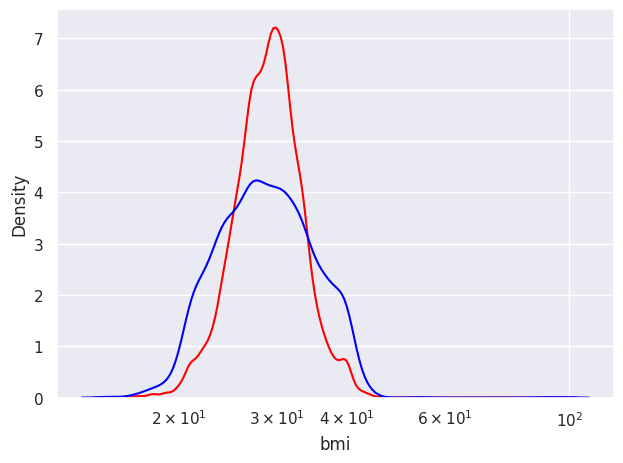

In [161]:
sns.kdeplot(numerical_train['bmi'], color='red', log_scale=True)
sns.kdeplot(wids_train['bmi'], color='blue', log_scale=True)
plt.tight_layout()
plt.show()

It can be seen that there is lesser explosion in the distribution when imputed with knn technique than with the mean of the column. Therefore we can opt to keep this technique unchanged

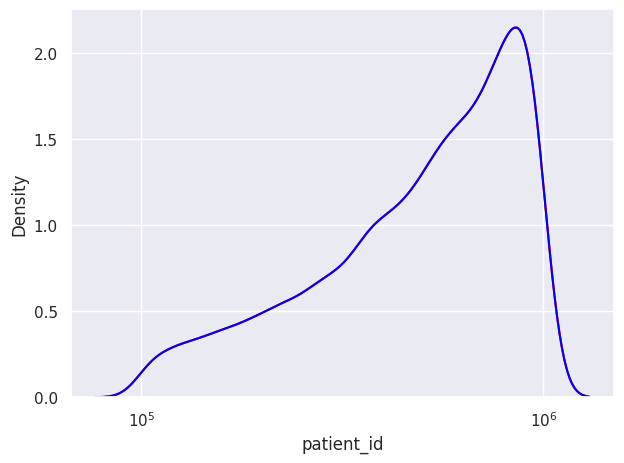

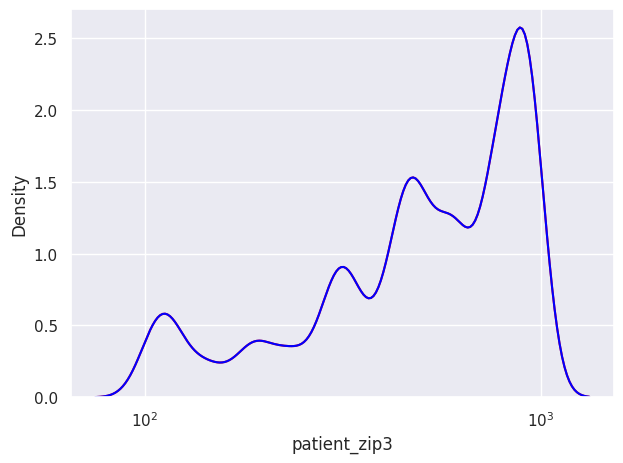

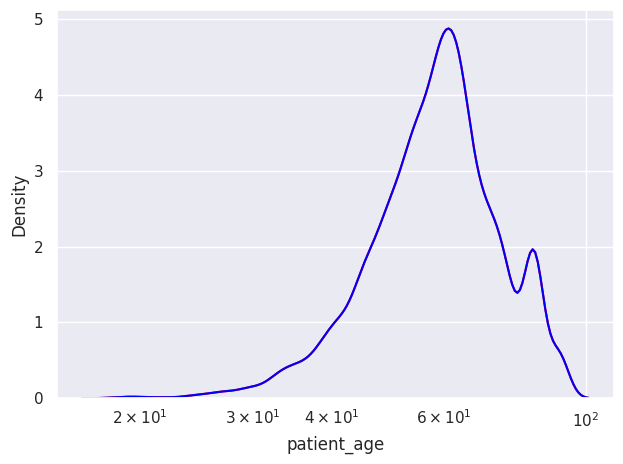

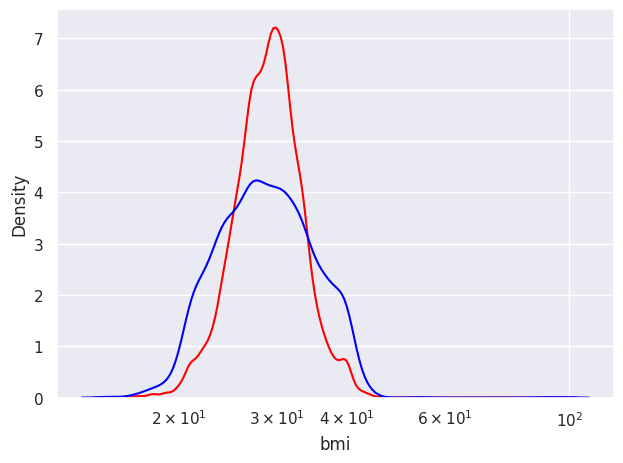

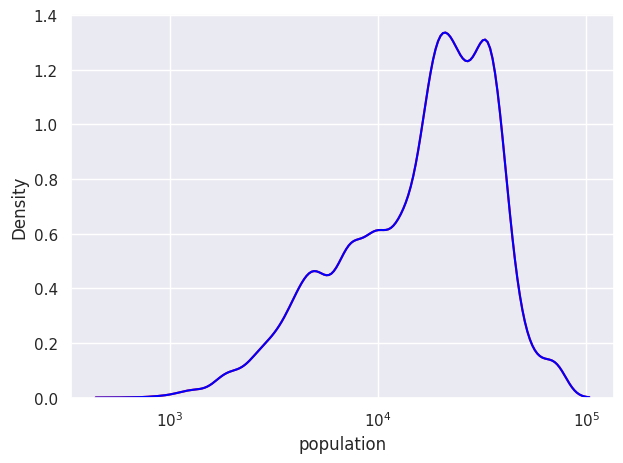

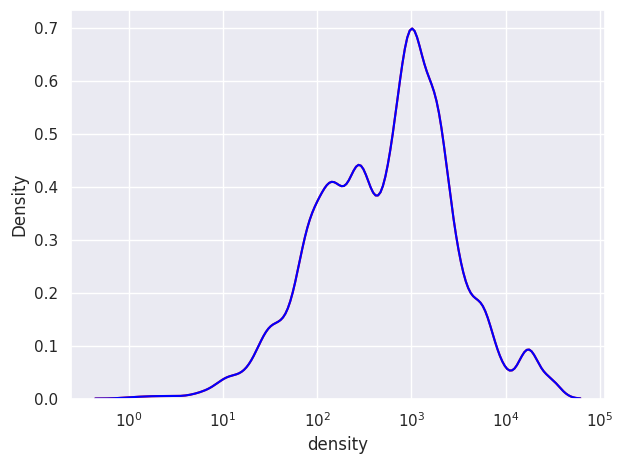

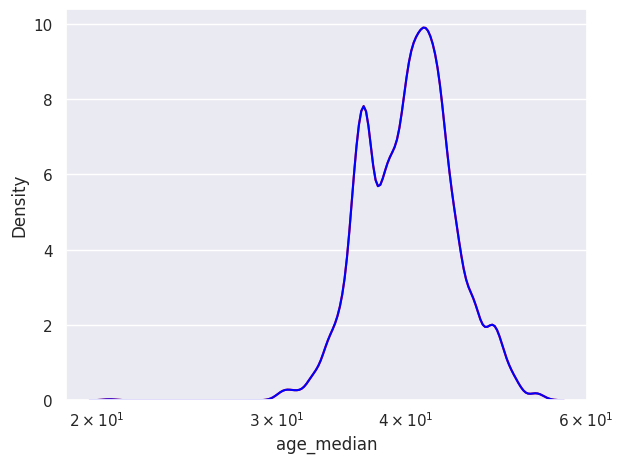

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


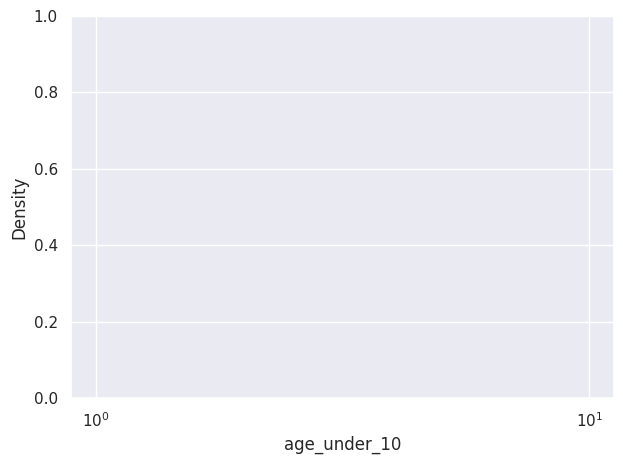

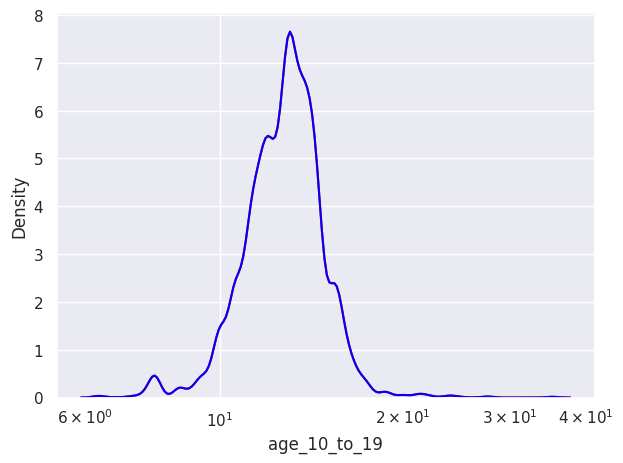

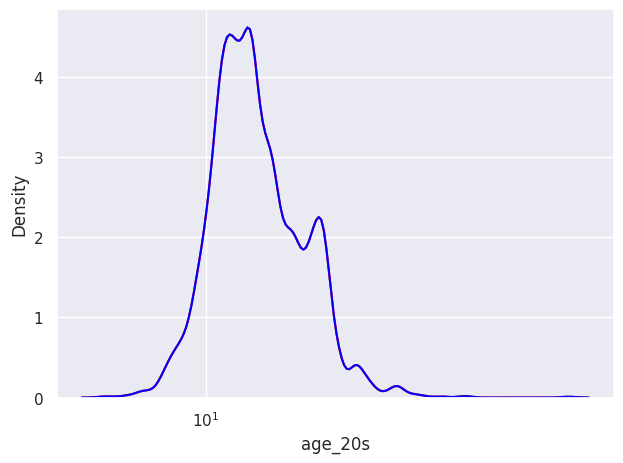

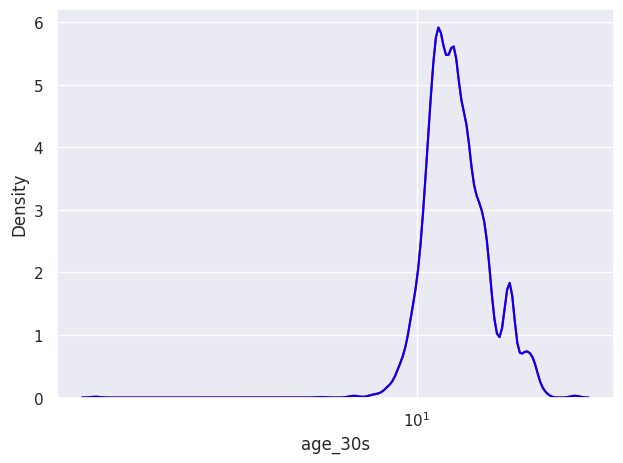

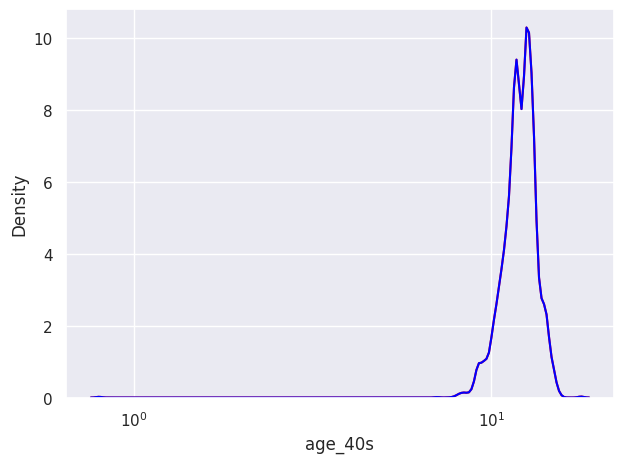

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


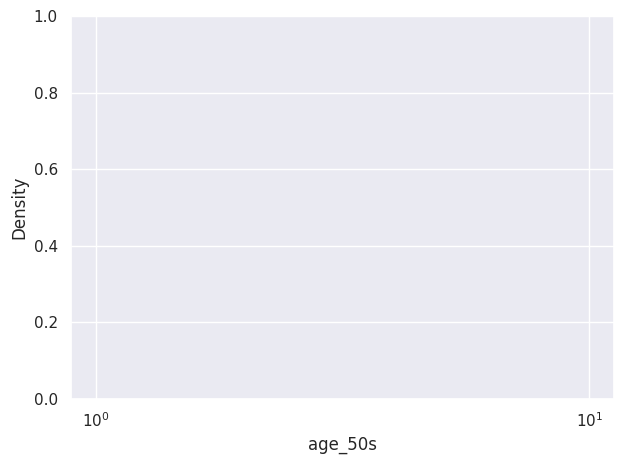

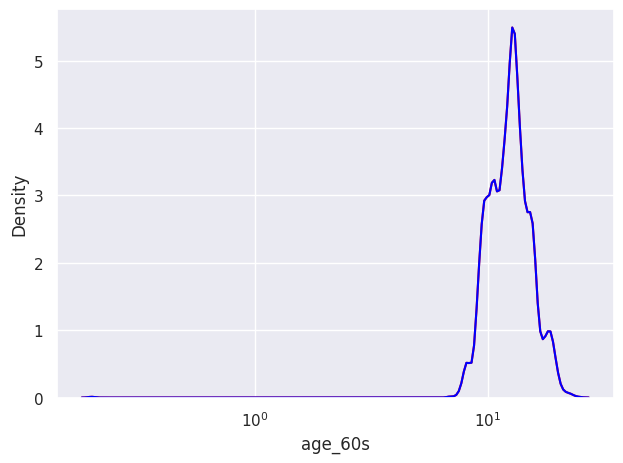

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


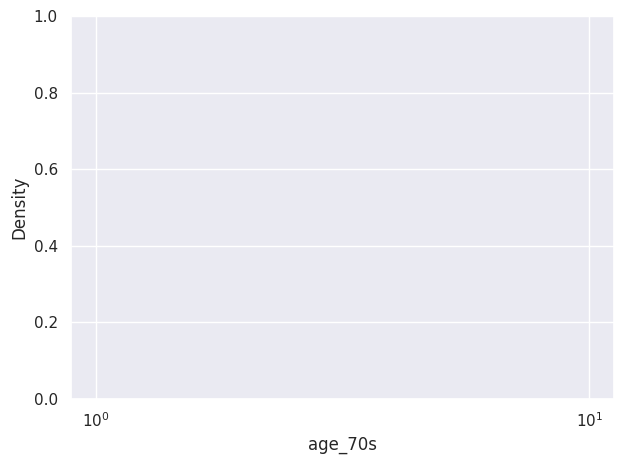

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


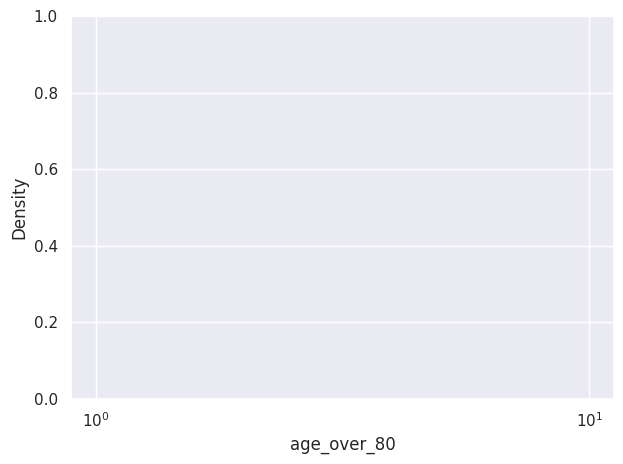

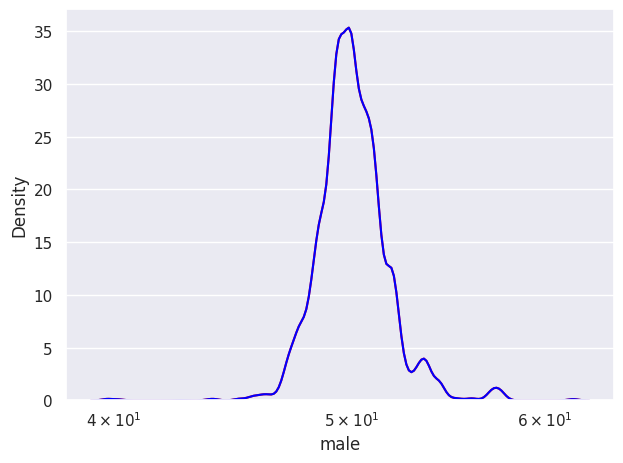

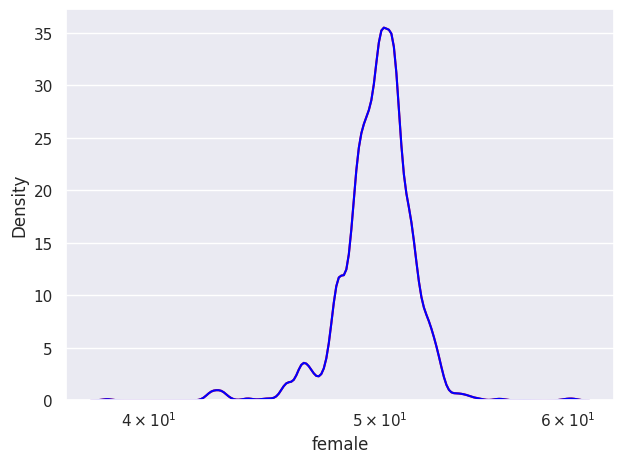

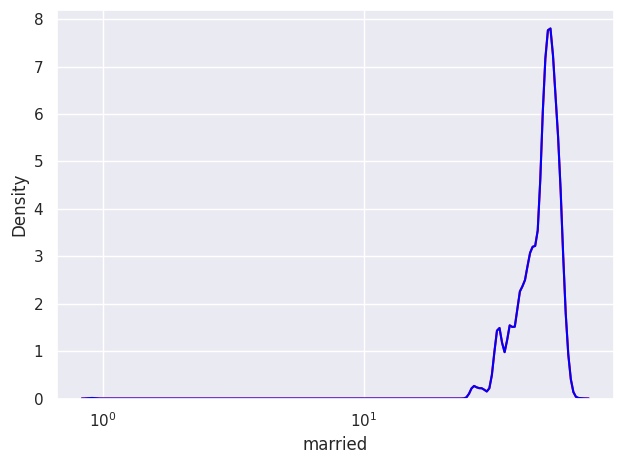

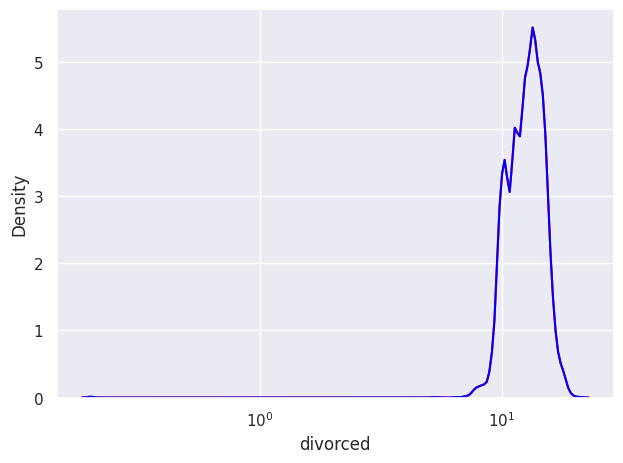

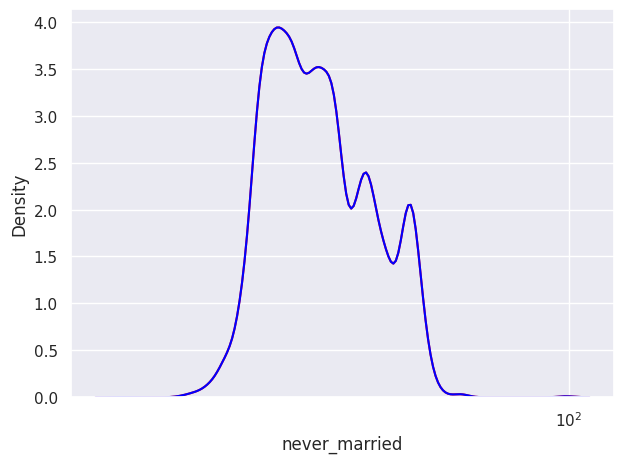

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


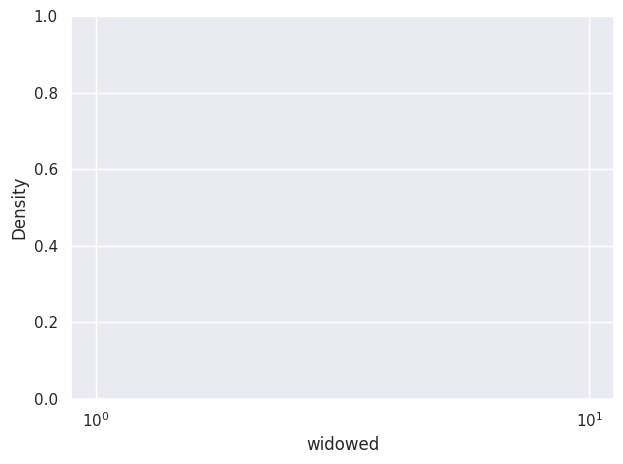

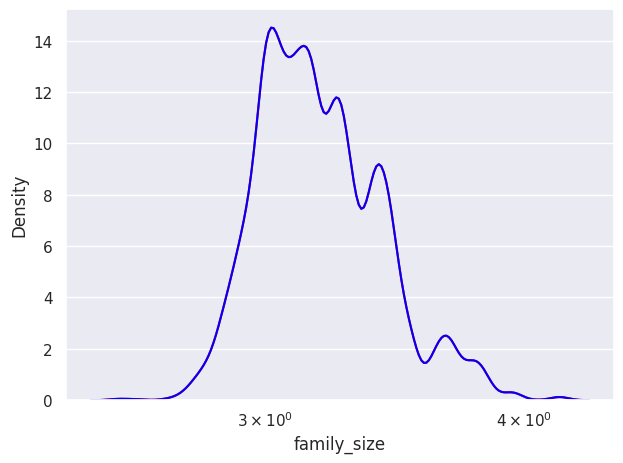

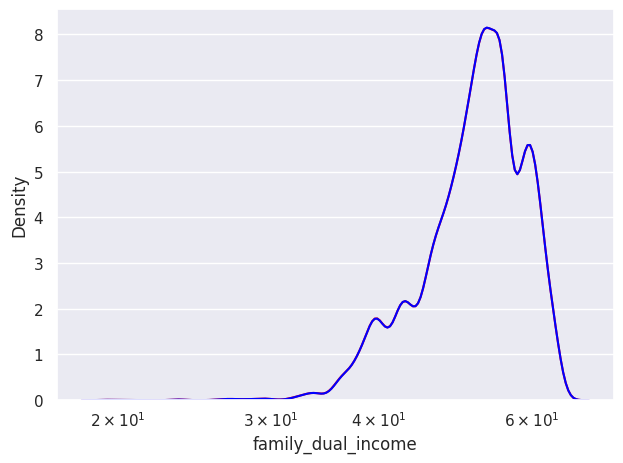

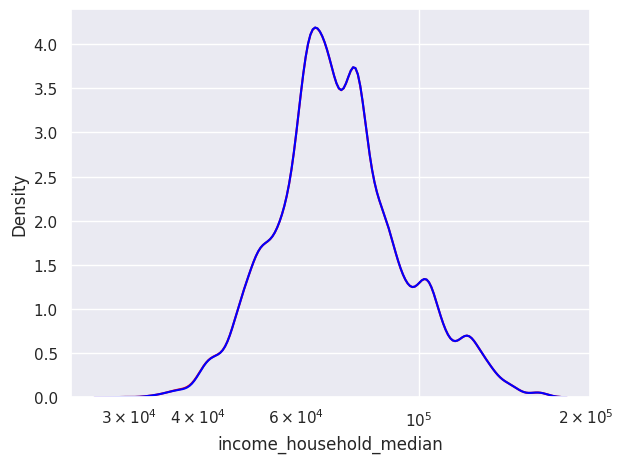

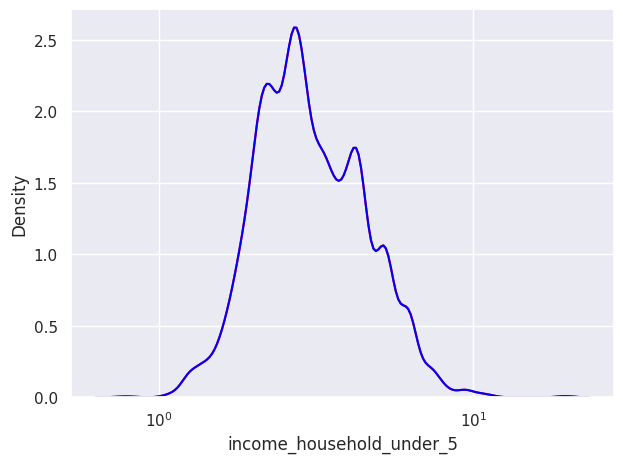

...

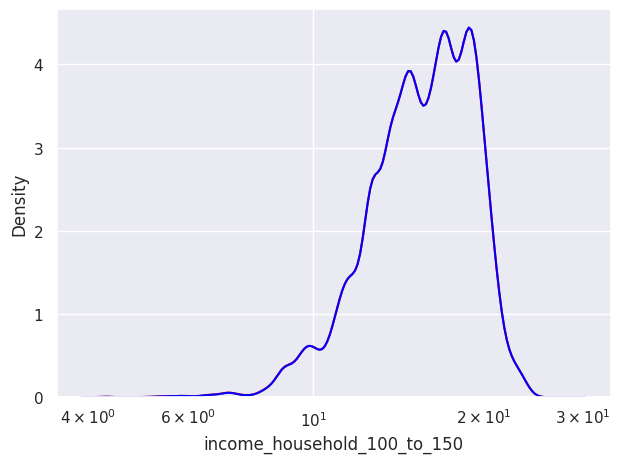

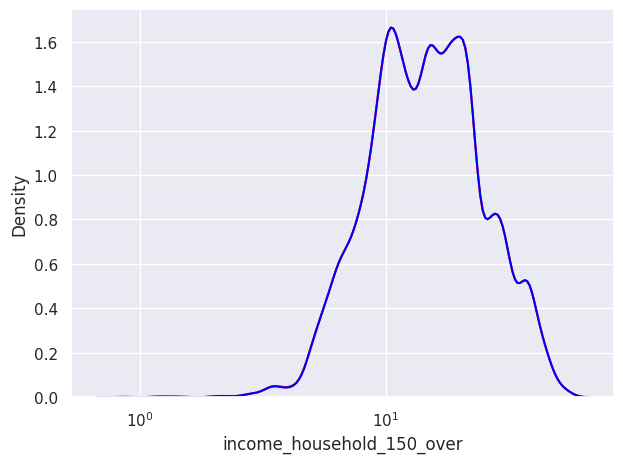

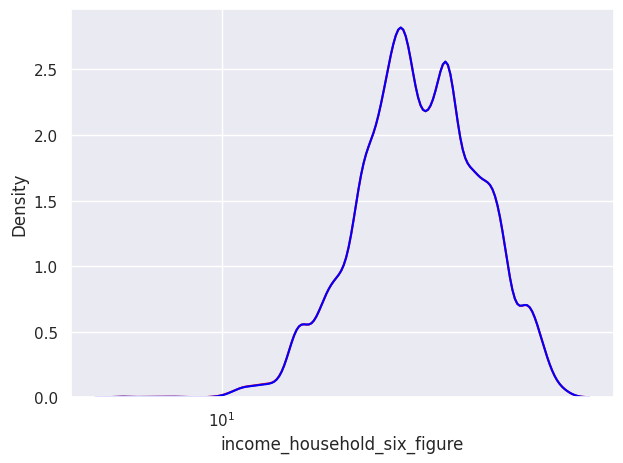

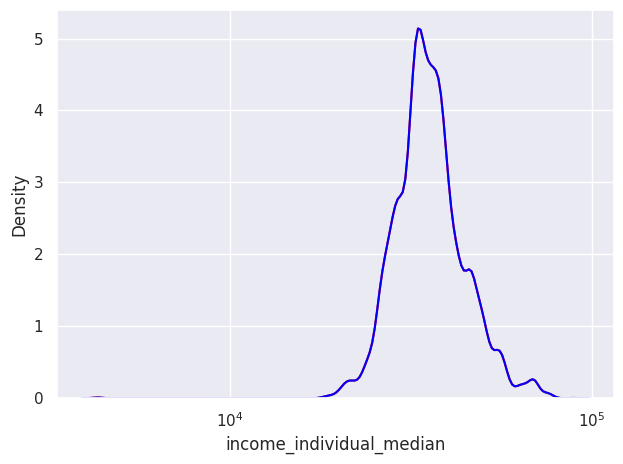

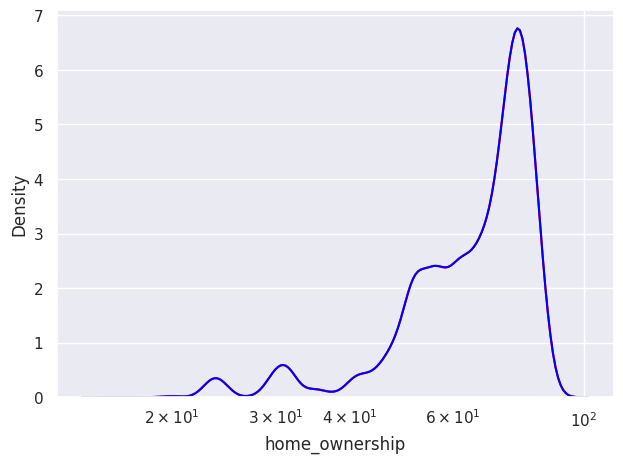

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


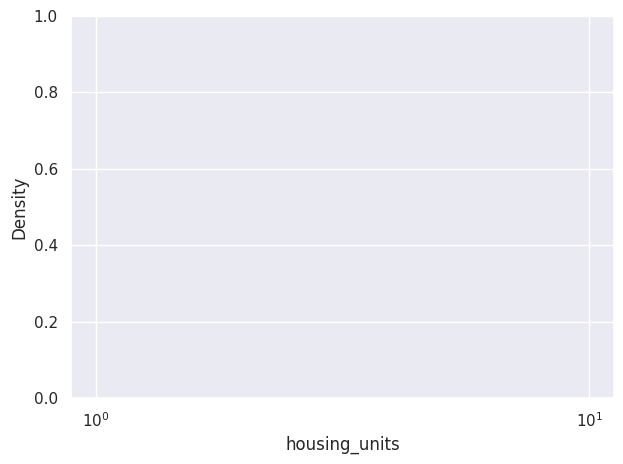

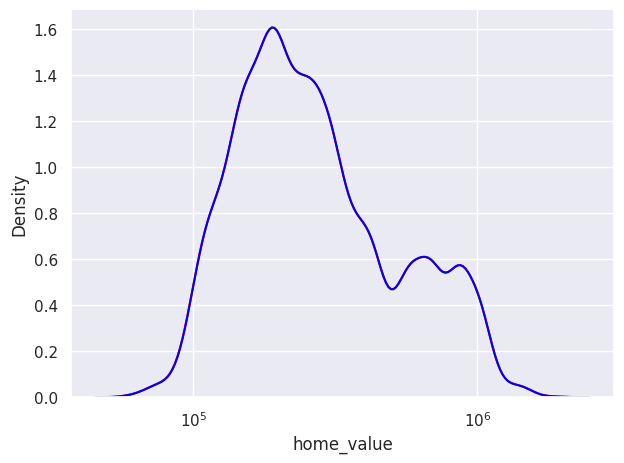

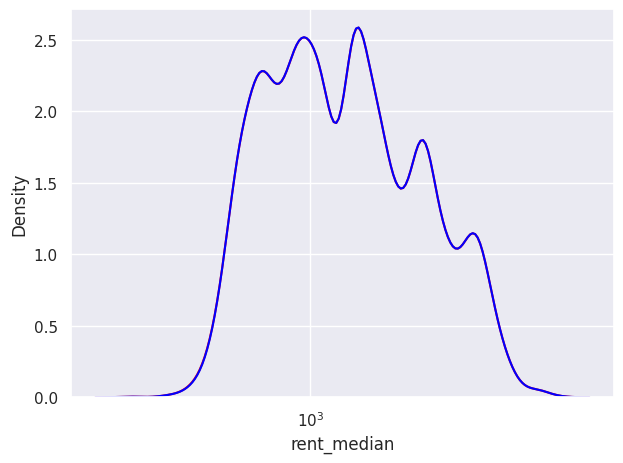

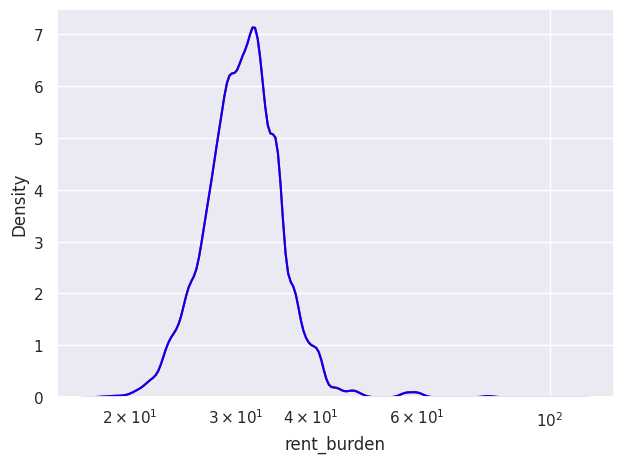

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


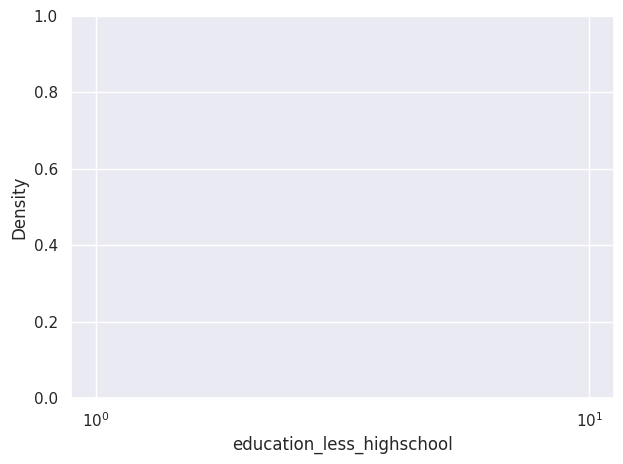

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


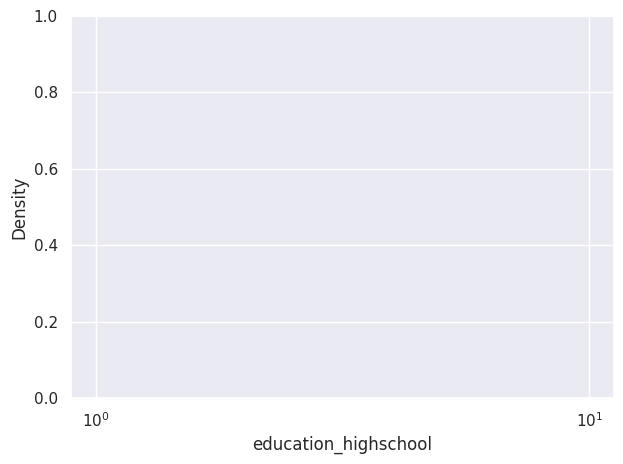

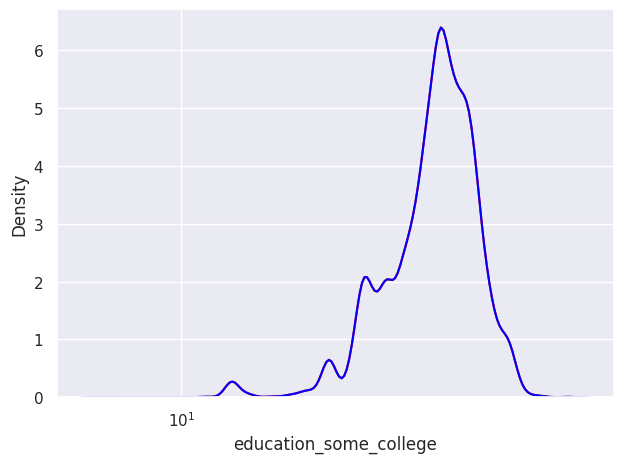

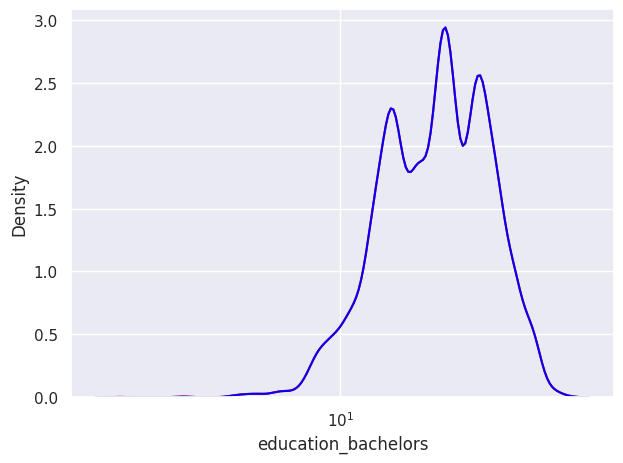

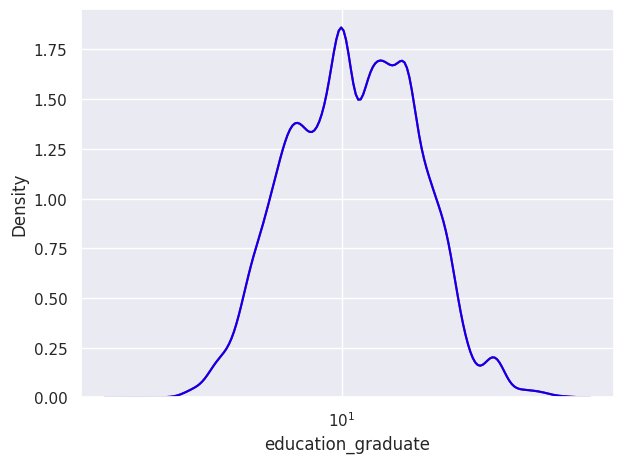

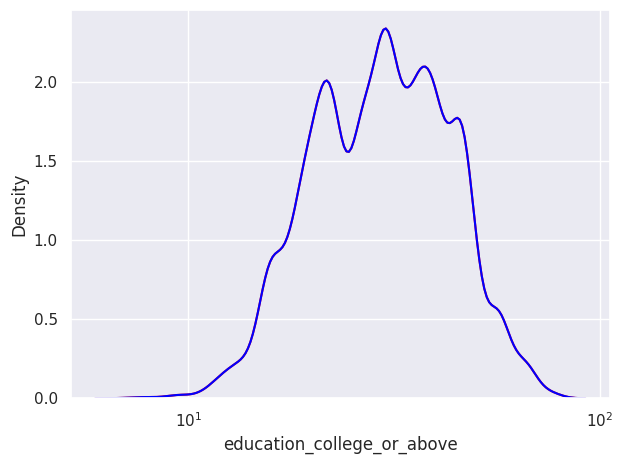

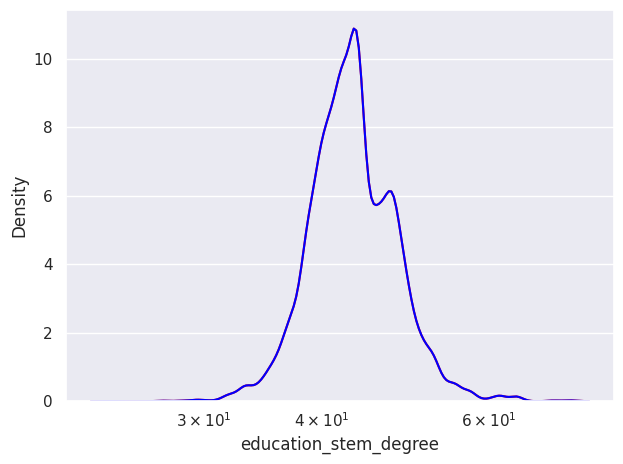

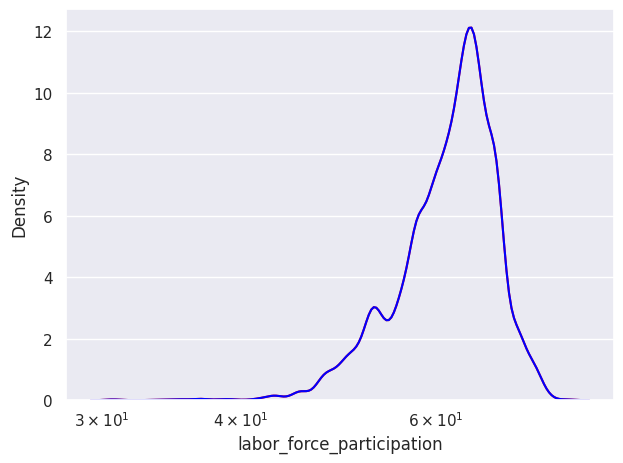

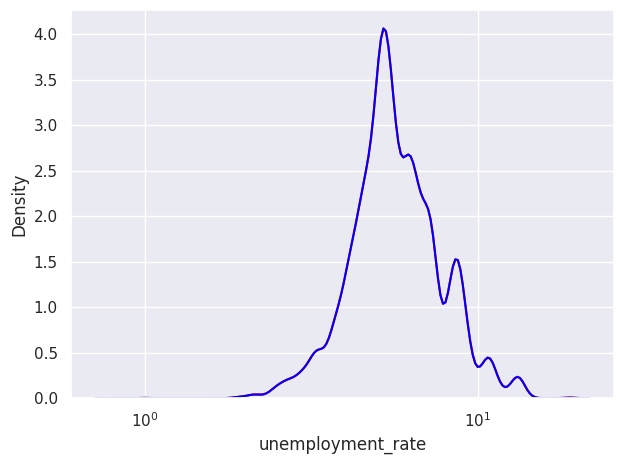

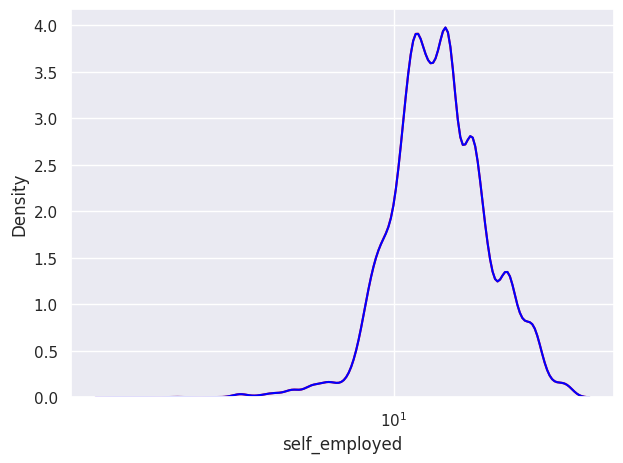

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


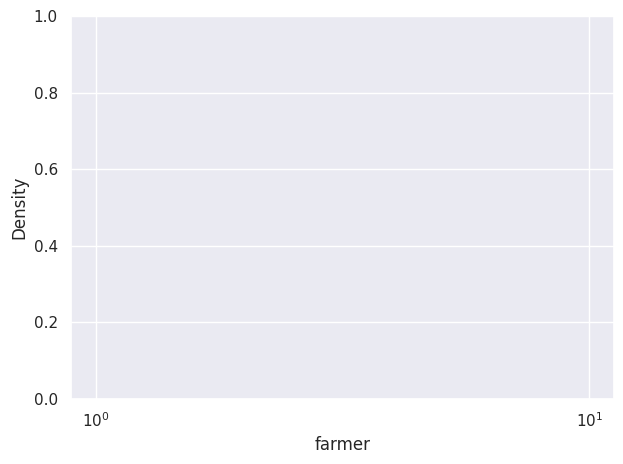

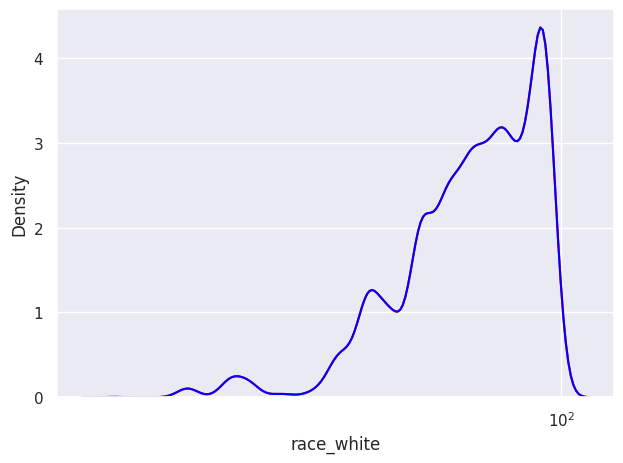

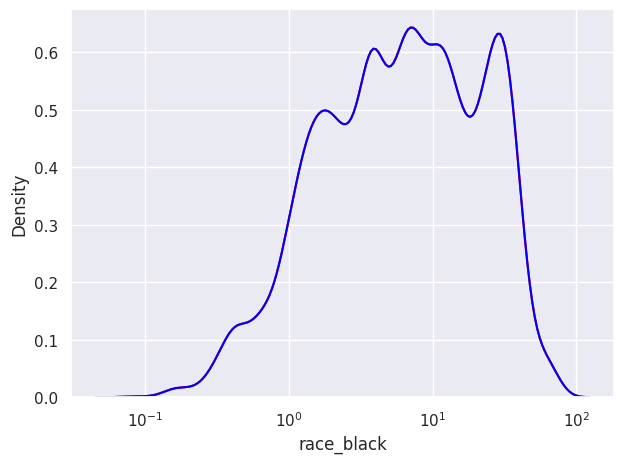

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


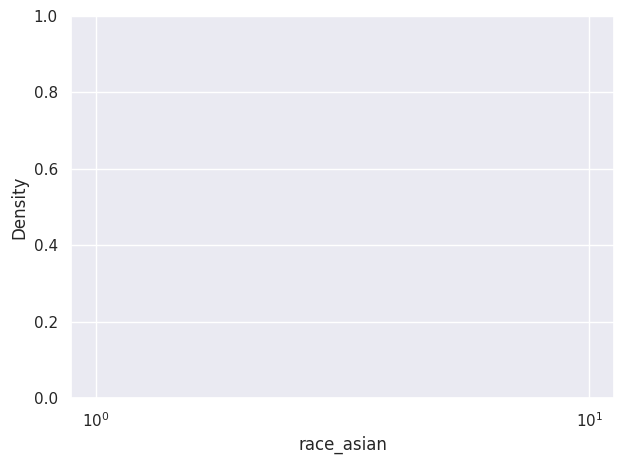

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


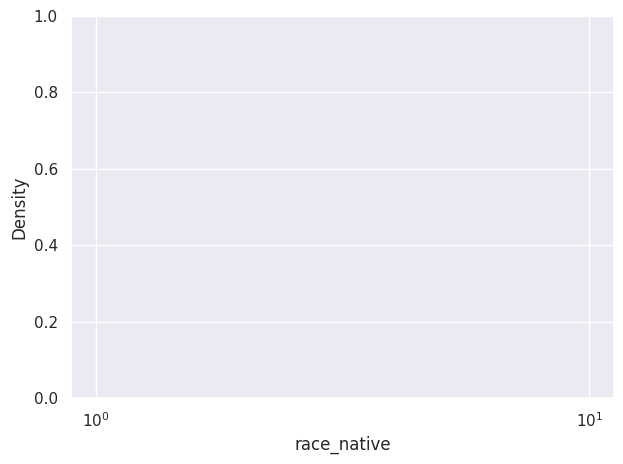

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


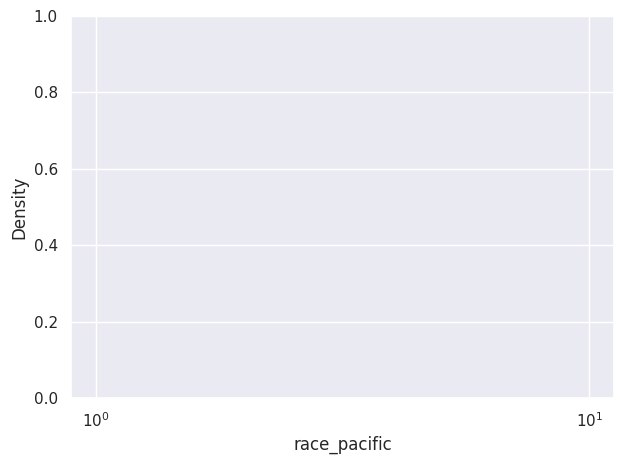

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


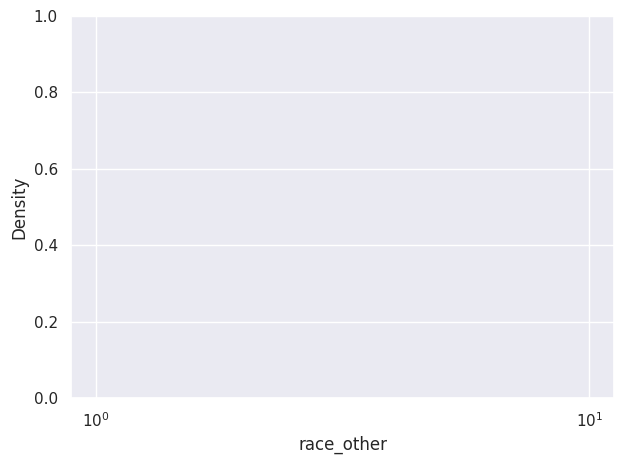

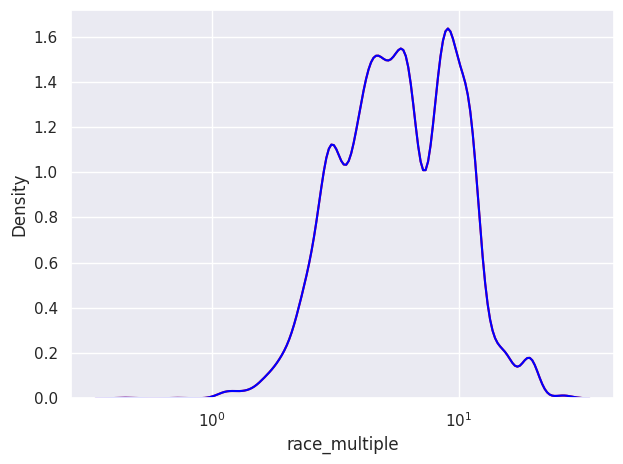

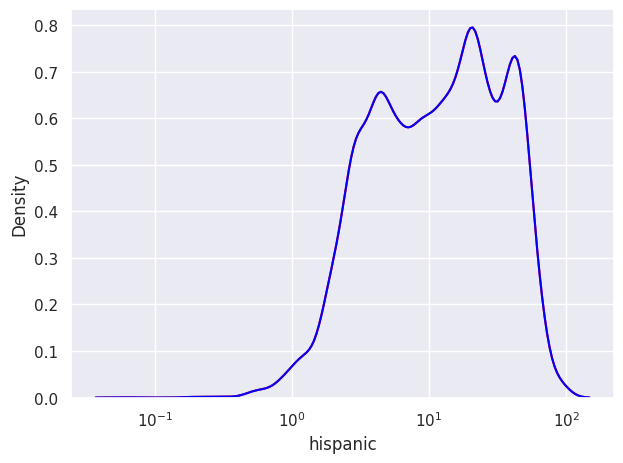

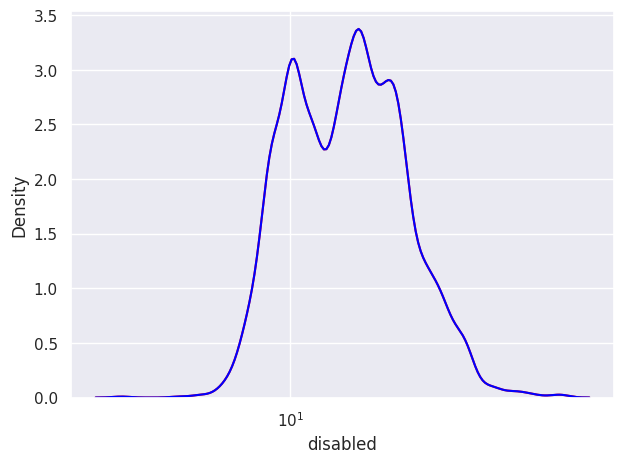

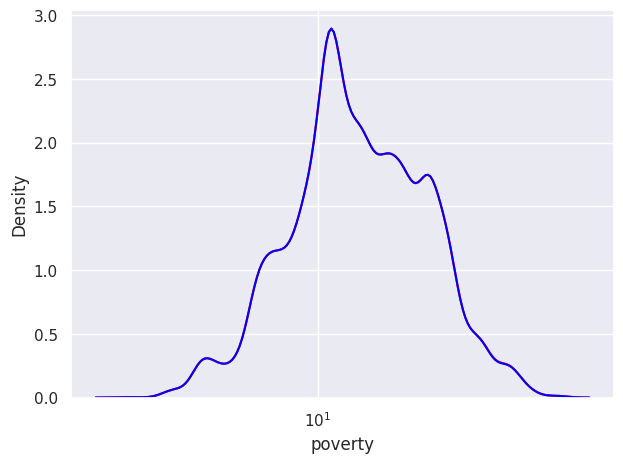

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


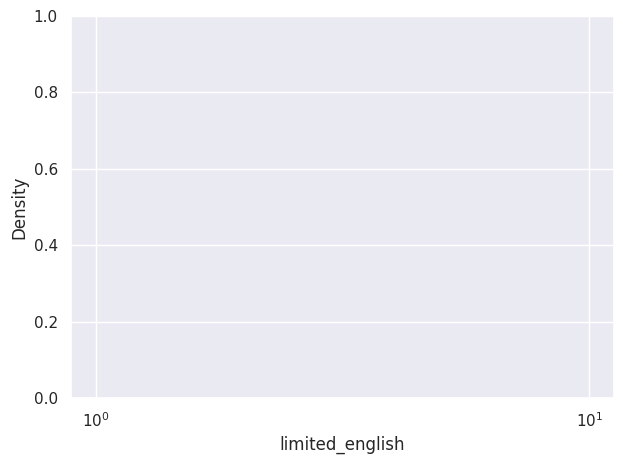

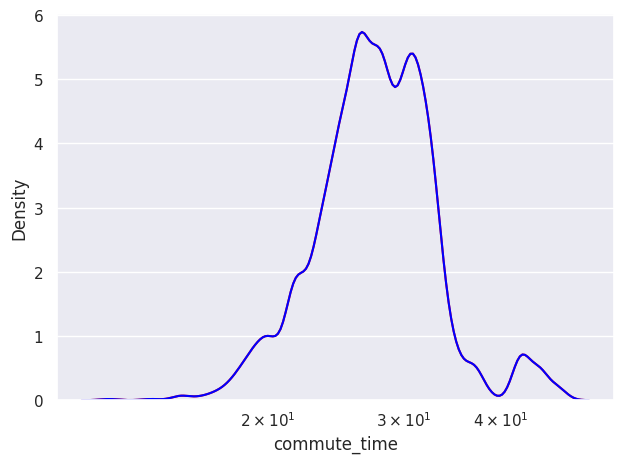

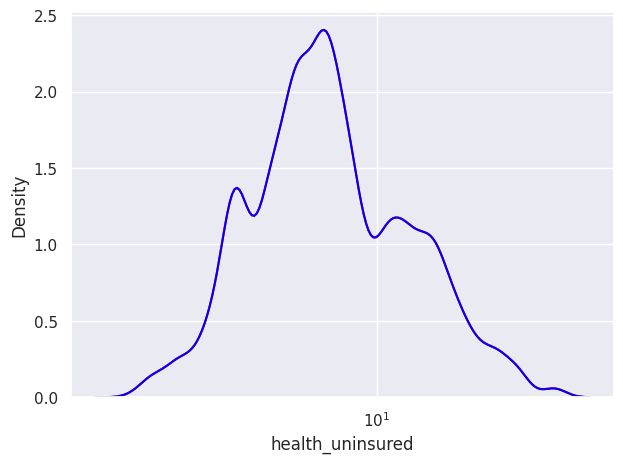

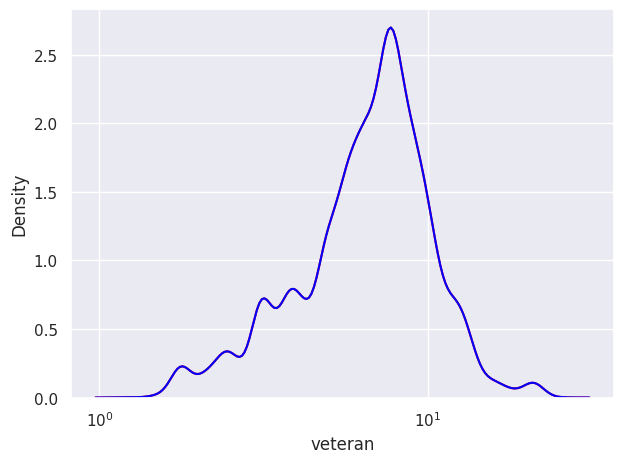

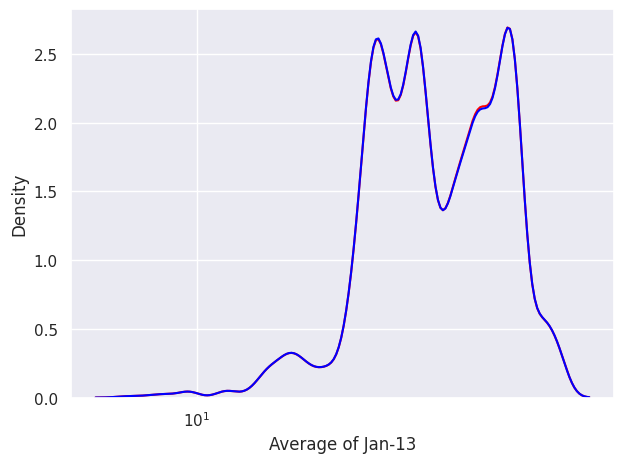

...

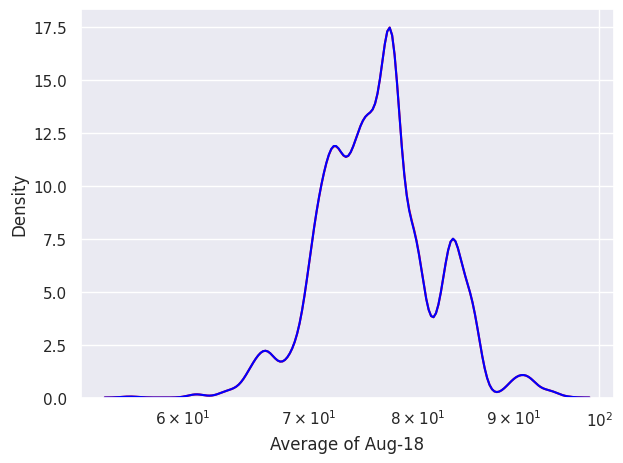

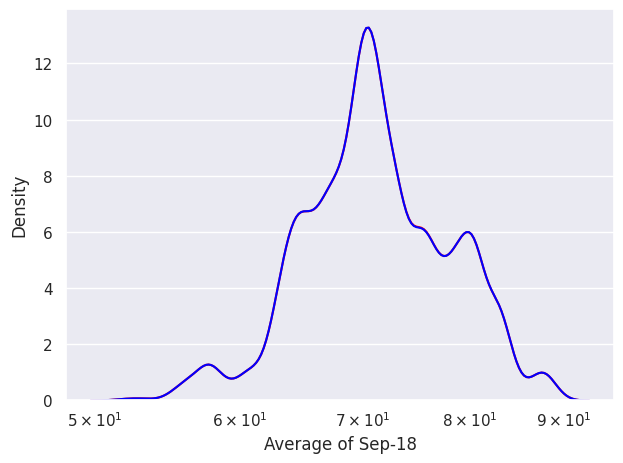

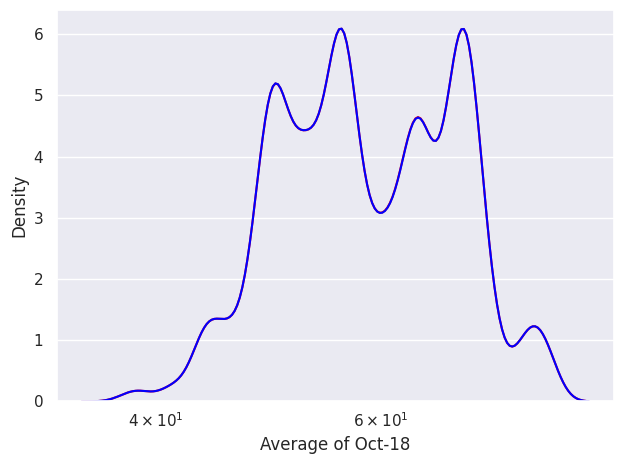

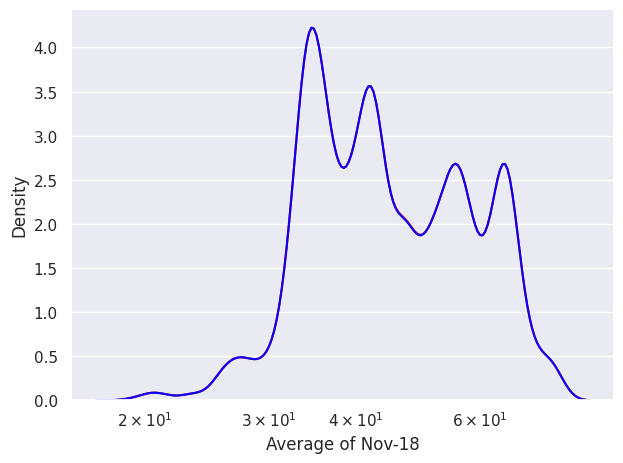

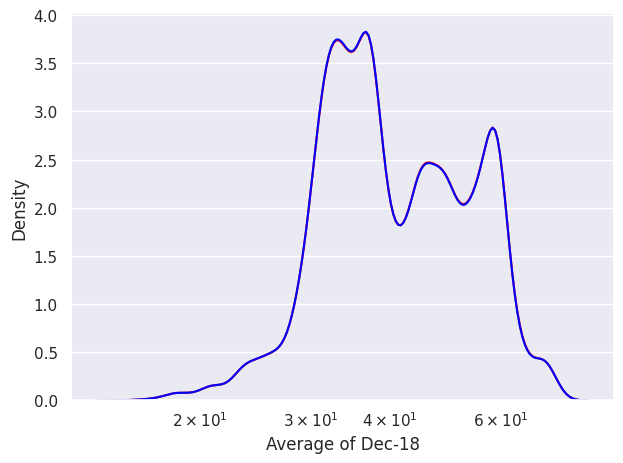

/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:2: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
/home/manish/.local/lib/python3.10/site-packages/pandas/core/nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
/tmp/ipykernel_3195/1555064050.py:3: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(wids_train[i], color='blue', log_scale=True)


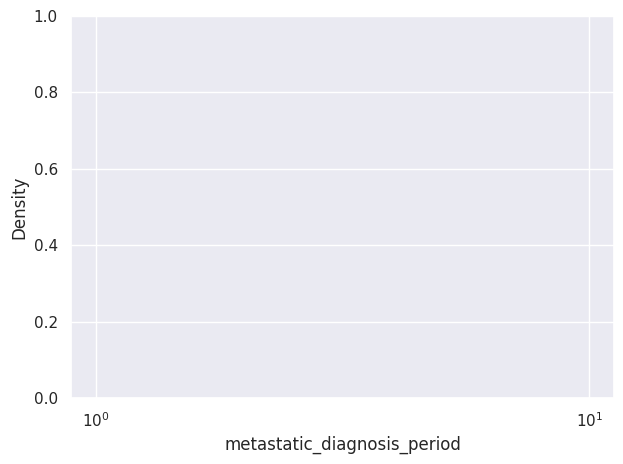

In [46]:
for i in numerical_train:
    sns.kdeplot(numerical_train[i], color= 'red', log_scale=True)
    sns.kdeplot(wids_train[i], color='blue', log_scale=True)
    plt.tight_layout()
    plt.show()

After the KNN Imputation, the distribution is nearly same. We keep this strategy unchanged. 

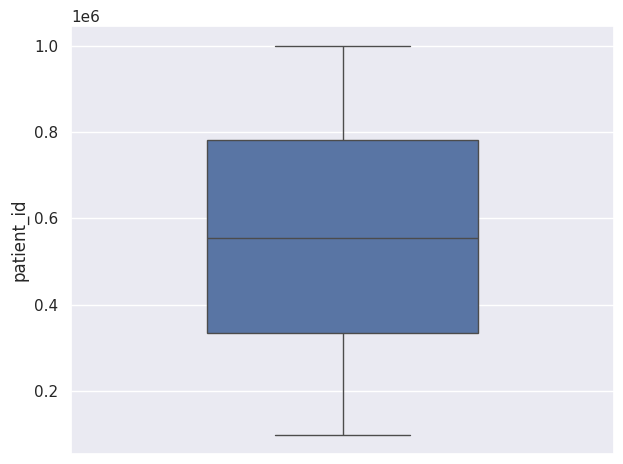

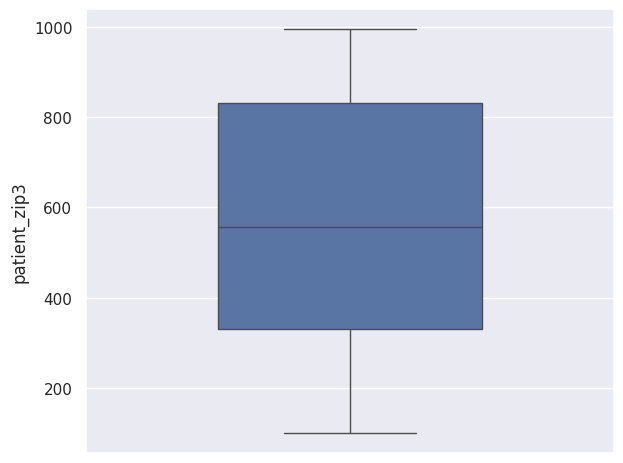

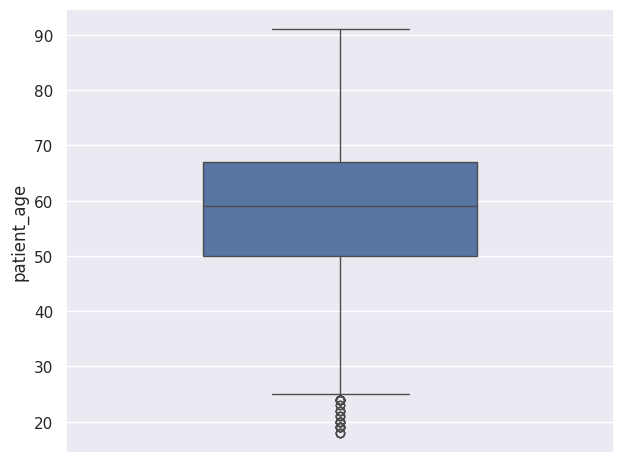

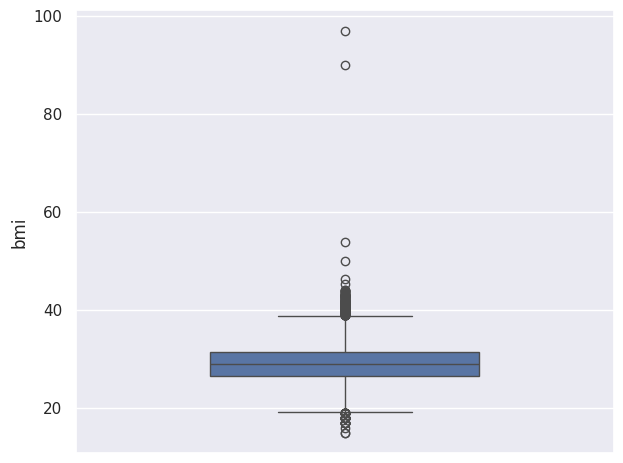

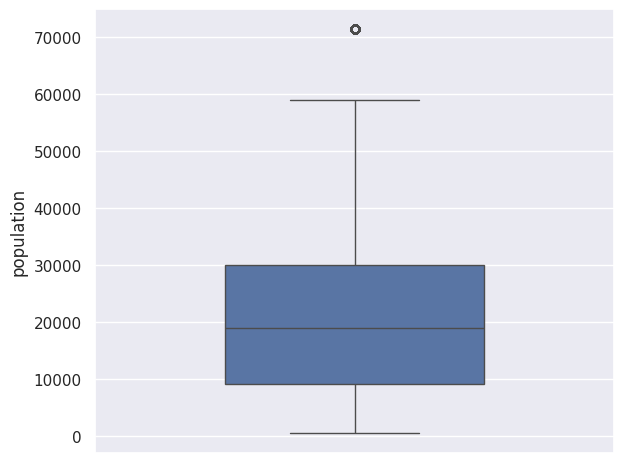

...

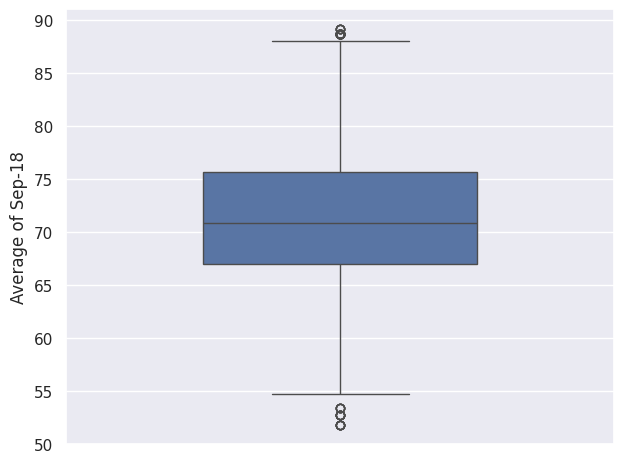

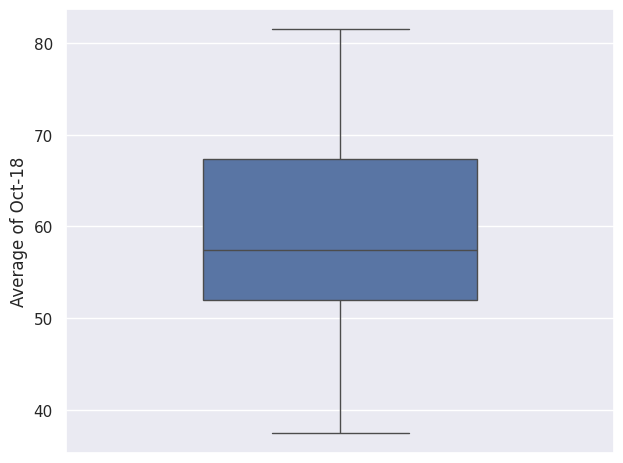

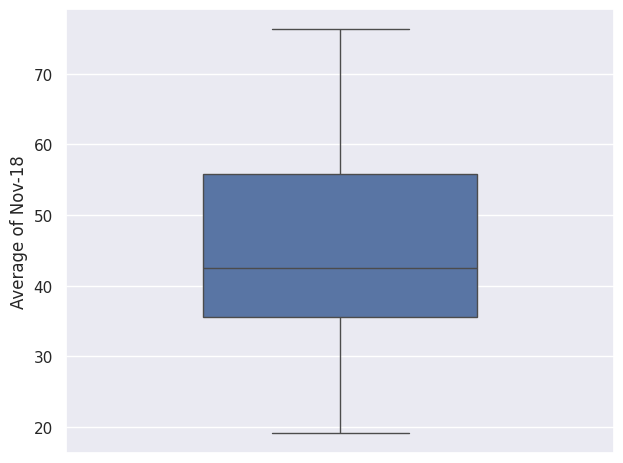

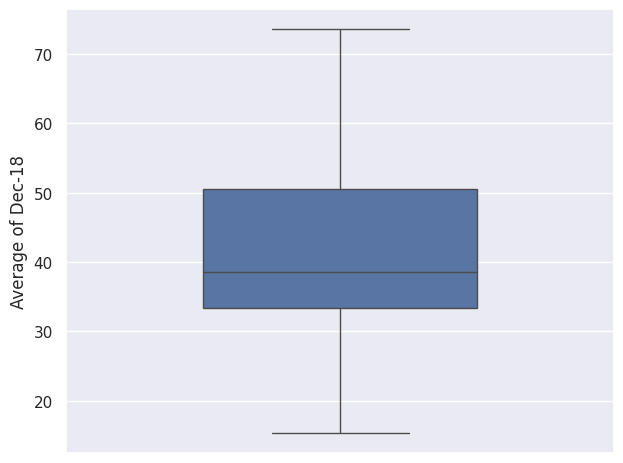

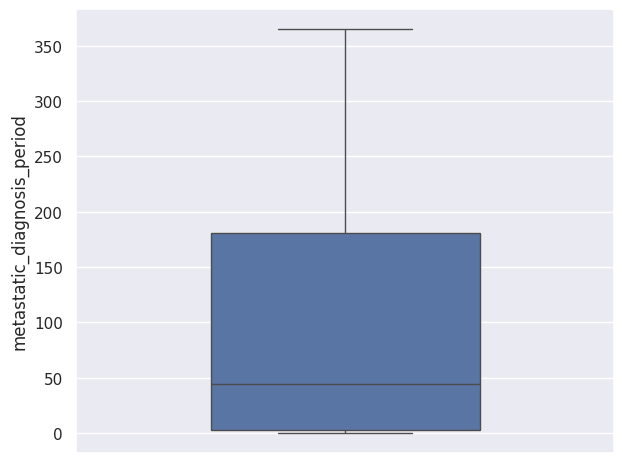

In [163]:
for c in numerical_train:
    sns.boxplot(numerical_train[c],  width=.5)
    plt.tight_layout()
    plt.show()

We still have outliers. Let's try capping these outliers to better fit our model

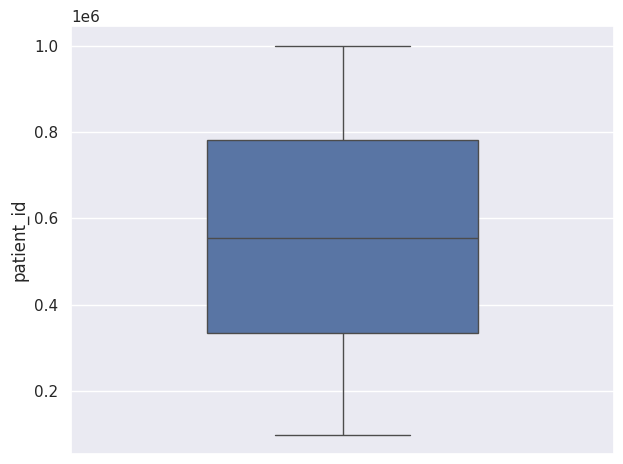

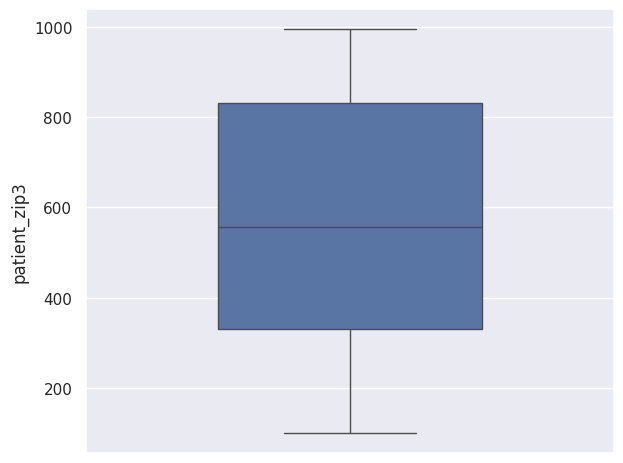

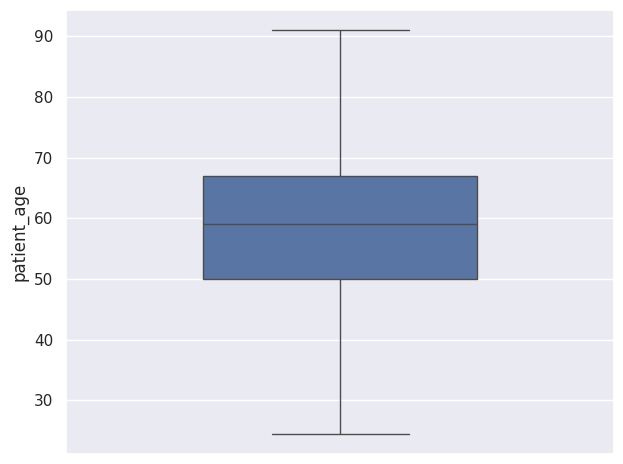

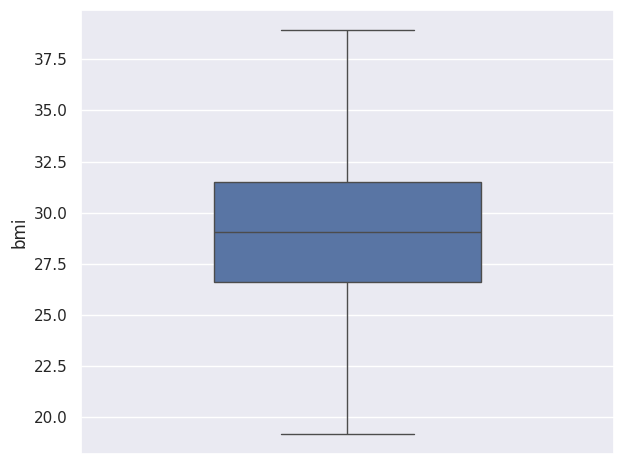

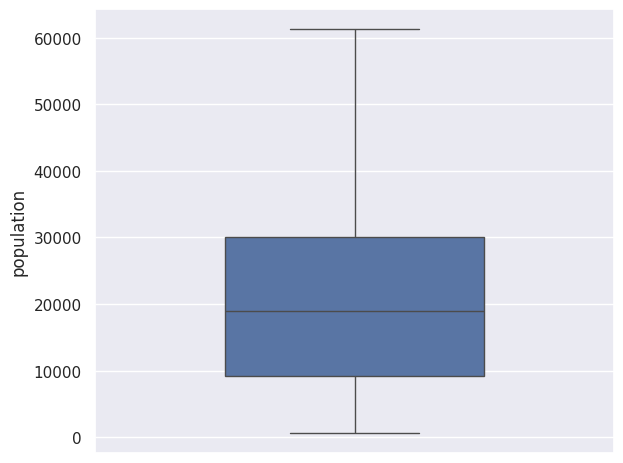

...

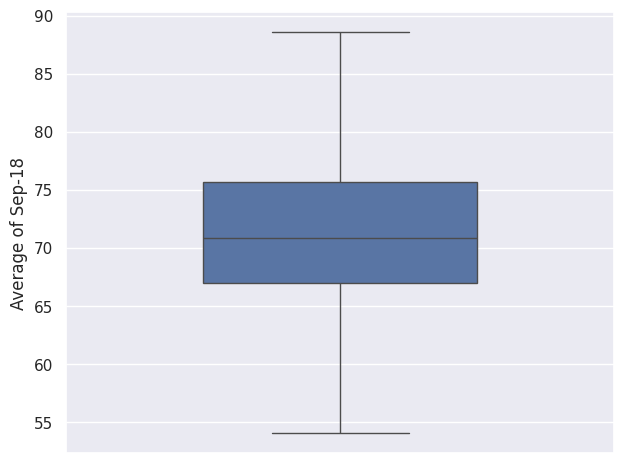

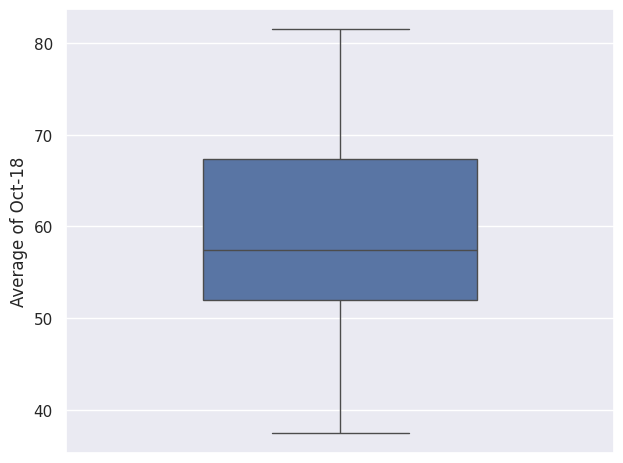

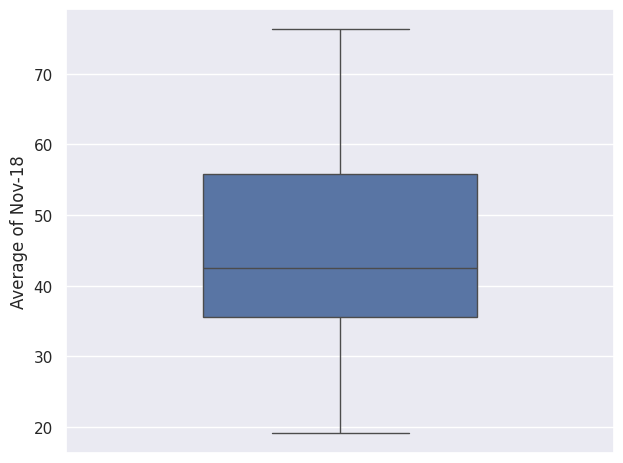

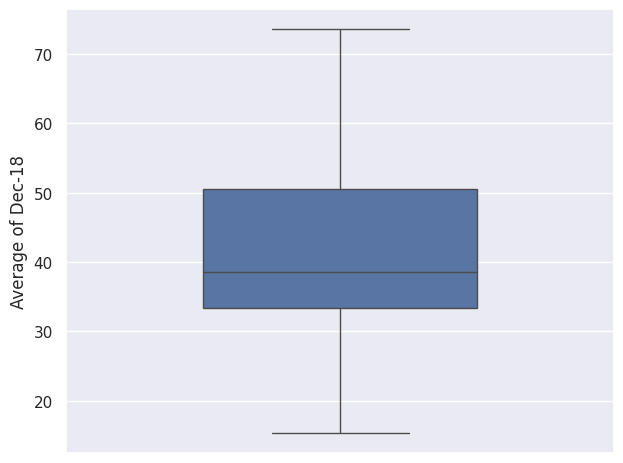

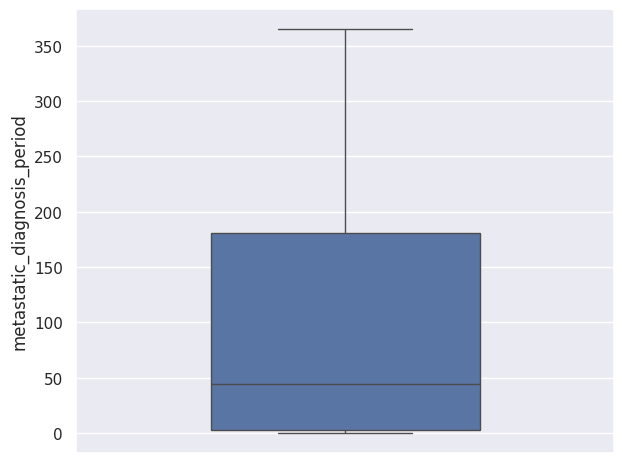

In [10]:
def outliercalc(dataframe_column):
    q3 = dataframe_column.quantile(0.75)
    q1 = dataframe_column.quantile(0.25)
    IQR = q3 - q1
    lowerlimit = q1 - (IQR*1.5)
    upperlimit = q3 + (IQR*1.5)
    return upperlimit, lowerlimit

def capoutliers(dataframe):
    for c in dataframe:
        upp, low = outliercalc(dataframe[c])
        dataframe[c]= dataframe[c].clip(lower=low, upper = upp)
    return dataframe

numerical_train = capoutliers(numerical_train)
for c in numerical_train:
    sns.boxplot(numerical_train[c],  width=.5)
    plt.tight_layout()
    plt.show()



In [165]:
after_skewness = numerical_train.skew(axis = 0)
for i in after_skewness.index:
    print("The skewness of ", i, "\nBefore outlier capping was: ", prev_skewness[i], " After outlier capping is: ", after_skewness[i])

The skewness of  patient_id 
Before outlier capping was:  -0.02224157902886198  After outlier capping is:  -0.02224157902886198
The skewness of  patient_zip3 
Before outlier capping was:  -0.10541708739976652  After outlier capping is:  -0.10541708739976652
The skewness of  patient_age 
Before outlier capping was:  0.15672432872660738  After outlier capping is:  0.17120636387414562
The skewness of  bmi 
Before outlier capping was:  0.9381325545513864  After outlier capping is:  0.21724846502188638
The skewness of  population 
Before outlier capping was:  0.970057608772638  After outlier capping is:  0.7395600799961083
The skewness of  density 
Before outlier capping was:  4.776307691939511  After outlier capping is:  1.2507966188555966
The skewness of  age_median 
Before outlier capping was:  0.2572078809729715  After outlier capping is:  0.2551532295928178
The skewness of  age_under_10 
Before outlier capping was:  -0.16110096537995514  After outlier capping is:  -0.03070518655053351


In [166]:
imputed_df.isnull().sum()

patient_race_Black                                0
patient_race_Hispanic                             0
patient_race_Other                                0
patient_race_White                                0
payer_type_MEDICAID                               0
                                                 ..
metastatic_cancer_diagnosis_code_C7981            0
metastatic_cancer_diagnosis_code_C7982            0
metastatic_cancer_diagnosis_code_C7989            0
metastatic_cancer_diagnosis_code_C799             0
metastatic_first_novel_treatment_PEMBROLIZUMAB    0
Length: 190, dtype: int64

No more NULL values in the categorical_train dataframe. Proceed for concatenating with numerical_train for new completed dataframe

In [13]:
total_data = pd.concat([numerical_train, imputed_df], axis=1)
total_data.reset_index(drop=True, inplace=True)
print(total_data)
statanalysis(total_data)
catanalysis(total_data) 

       patient_id  patient_zip3  patient_age      bmi  population   density  \
0        268700.0         724.0         39.0  34.1050     3924.87    82.630   
1        484983.0         629.0         55.0  35.3600     2745.39    51.790   
2        277055.0         925.0         59.0  26.8025    38343.18   700.340   
3        320055.0         900.0         59.0  28.7450    36054.12  3921.575   
4        190386.0         934.0         71.0  25.4075    13700.37   400.480   
...           ...           ...          ...      ...         ...       ...   
13168    588544.0         191.0         59.0  27.2350    31948.46  3921.575   
13169    393047.0         757.0         73.0  30.6700     9309.38   204.690   
13170    790904.0         928.0         24.5  22.5425    39121.88  2295.940   
13171    455518.0         481.0         52.0  29.0875    23266.06   743.560   
13172    379418.0         900.0         63.0  22.1200    36054.12  3921.575   

       age_median  age_under_10  age_10_to_19  age_

#### WHAT COLUMNS TO DROP?

/tmp/ipykernel_3366/3460242214.py:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=numerical_train, x=x_column, y=y_column,  palette='viridis')
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


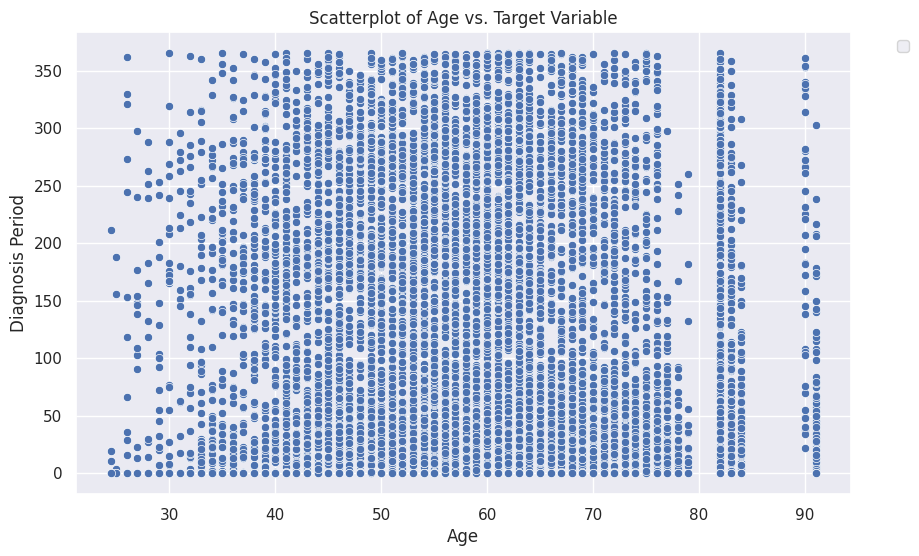

In [17]:
x_column = 'patient_age'
y_column = 'metastatic_diagnosis_period'

# Create the scatterplot
plt.figure(figsize=(10, 6))
sns.scatterplot(data=numerical_train, x=x_column, y=y_column,  palette='viridis')

# Add titles and labels
plt.title('Scatterplot of Age vs. Target Variable')
plt.xlabel('Age')
plt.ylabel('Diagnosis Period')

# Show the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

Because of the huge size of the dataset, the graphs produced are unreadable. Therefore we opt for statistical models to better understand the relationships between the variables.

In [ ]:
x_column = 'patient_age'
y_column = 'bmi'

# Create the scatterplot
plt.figure(figsize=(10, 6))
sns.scatterplot(data=numerical_train, x=x_column, y=y_column,  palette='viridis', s=100, alpha=0.7)

# Add titles and labels
plt.title('Scatterplot of Age vs. BMI')
plt.xlabel('Age')
plt.ylabel('BMI')

# Show the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

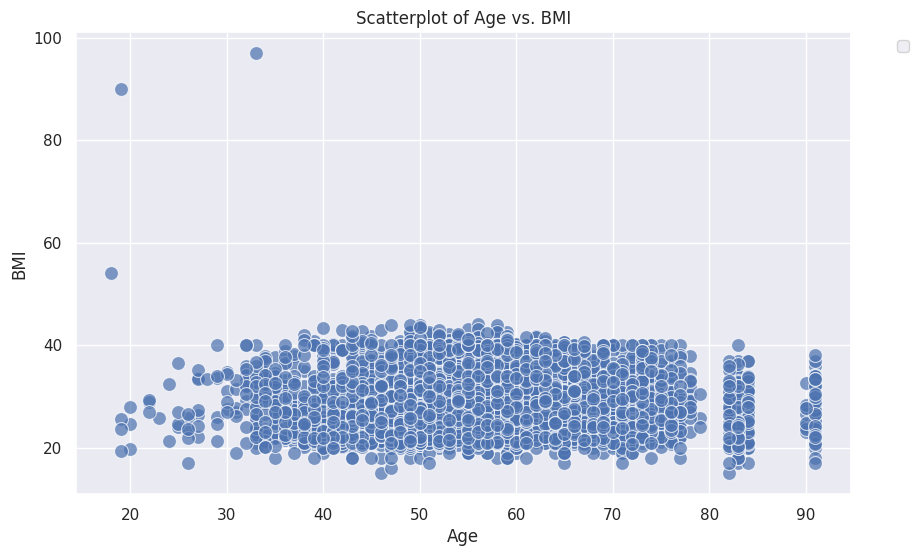

#### Hypothesis from the above graph
11) Age and BMI are unrelated. Scatter plot shows neutral relationship

In [ ]:
x_column = 'male'
y_column = 'female'

# Create the scatterplot
plt.figure(figsize=(10, 6))
sns.scatterplot(data=wids_train, x=x_column, y=y_column, hue='patient_state', palette='viridis', s=100, alpha=0.7)

# Add titles and labels
plt.title('Scatterplot of Average Male vs. Female Numbers by State')
plt.xlabel('Average Male Numbers')
plt.ylabel('Average Female Numbers')

# Show the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

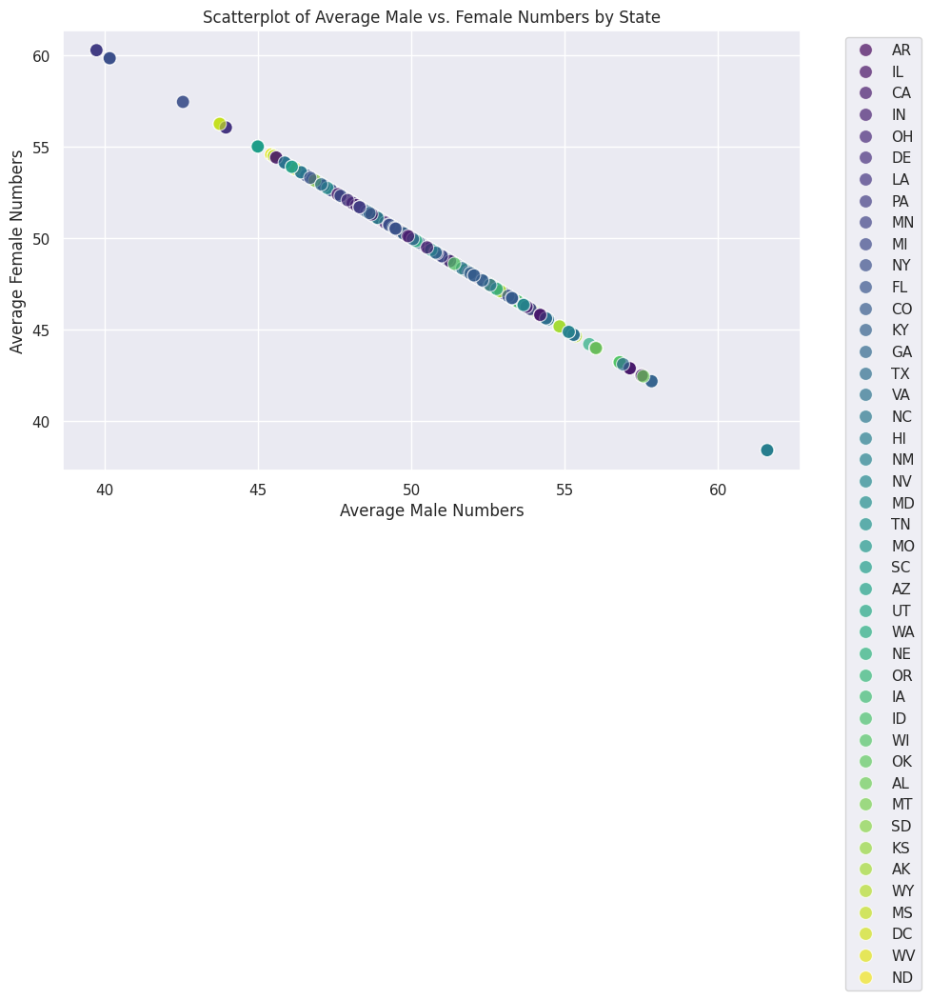

#### Hypothesis from the above graph
12) There is an equal distribution of male and female residents in the given states. There are states with high male residents and low female residents. There are states with low male residents and high female residents whereas there are states with equal male residents and equal female residents.

In [ ]:
x_column = 'bmi'
y_column = 'metastatic_diagnosis_period'

# Create the scatterplot
plt.figure(figsize=(10, 6))
sns.scatterplot(data=wids_train, x=x_column, y=y_column, palette='viridis', s=100, alpha=0.7)

# Add titles and labels
plt.title('BMI vs Target Variable')
plt.xlabel('BMI')
plt.ylabel('Diagnosis Period')

# Show the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

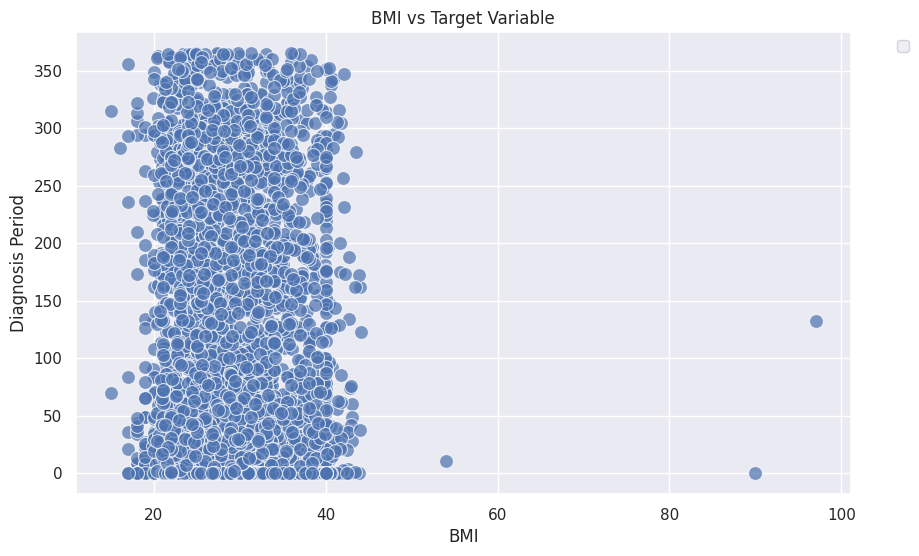

#### Hypothesis from the above graph
13) Neutral relationship between BMI and Target Variable which is true since the bmi of the patient does nothing on the amount of time it took for the patient to get her tests done.

In [ ]:
pivot_table = wids_train.pivot_table(index='patient_state', columns='payer_type', aggfunc='size', fill_value=0)

# Reset index to make 'state' a column again
pivot_table.reset_index(inplace=True)

# Rename columns for clarity
pivot_table.columns.name = None  # Remove the name of the columns index
pivot_table.columns = ['State', 'Commercial', 'Medicaid', 'MedicareAdvantage']

total_patients = pivot_table[['Commercial', 'Medicaid', 'MedicareAdvantage']].sum().tolist()

# Append the total row to the DataFrame
total_row = pd.DataFrame({'Commercial': [total_patients[0]], 
                          'Medicaid': [total_patients[1]], 
                          'MedicareAdvantage': [total_patients[2]]})

pivot_table_total = pd.concat([pivot_table, total_row], keys=['Number of Patients', 'Total'])

pivot_table_total

| State | Commercial | Medicaid | MedicareAdvantage |
|-------|------------|----------|------------------|
| AK    | 6          | 1        | 0                |
| AL    | 27         | 0        | 2                |
| AR    | 45         | 0        | 29               |
| AZ    | 86         | 104      | 37               |
| CA    | 968        | 665      | 366              |
| CO    | 128        | 7        | 48               |
| DC    | 4          | 10       | 0                |
| DE    | 6          | 6        | 0                |
| FL    | 184        | 195      | 132              |
| GA    | 244        | 234      | 37               |
| HI    | 3          | 12       | 3                |
| IA    | 27         | 12       | 0                |
| ID    | 78         | 1        | 28               |
| IL    | 576        | 95       | 87               |
| IN    | 186        | 55       | 51               |
| KS    | 25         | 32       | 1                |
| KY    | 141        | 64       | 45               |
| LA    | 43         | 86       | 6                |
| MD    | 23         | 35       | 1                |
| MI    | 354        | 38       | 333              |
| MN    | 180        | 30       | 150              |
| MO    | 143        | 4        | 6                |
| MS    | 28         | 8        | 19               |
| MT    | 39         | 2        | 12               |
| NC    | 103        | 3        | 65               |
| ND    | 3          | 0        | 0                |
| NE    | 23         | 11       | 8                |
| NM    | 65         | 26       | 37               |
| NV    | 35         | 20       | 2                |
| NY    | 410        | 261      | 395              |
| OH    | 420        | 41       | 212              |
| OK    | 122        | 0        | 1                |
| OR    | 27         | 14       | 47               |
| PA    | 151        | 125      | 147              |
| SC    | 44         | 45       | 9                |
| SD    | 13         | 0        | 0                |
| TN    | 65         | 37       | 9                |
| TX    | 763        | 153      | 93               |
| UT    | 19         | 4        | 5                |
| VA    | 261        | 68       | 13               |
| WA    | 96         | 51       | 28               |
| WI    | 121        | 19       | 53               |
| WV    | 8          | 19       | 0                |
| WY    | 4          | 0        | 1                |

#### Hypothesis from the above table
14) Commercial Payer_Type dominates in the entire dataset which would mean that there are people that earn moderate in the regions given.

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=numerical_train, x='density', y='breast_cancer_diagnosis_code')
plt.title('Population Density vs. Breast Cancer Incidence')
plt.xlabel('Population Density')
plt.ylabel('Breast Cancer Diagnosis')
plt.show()

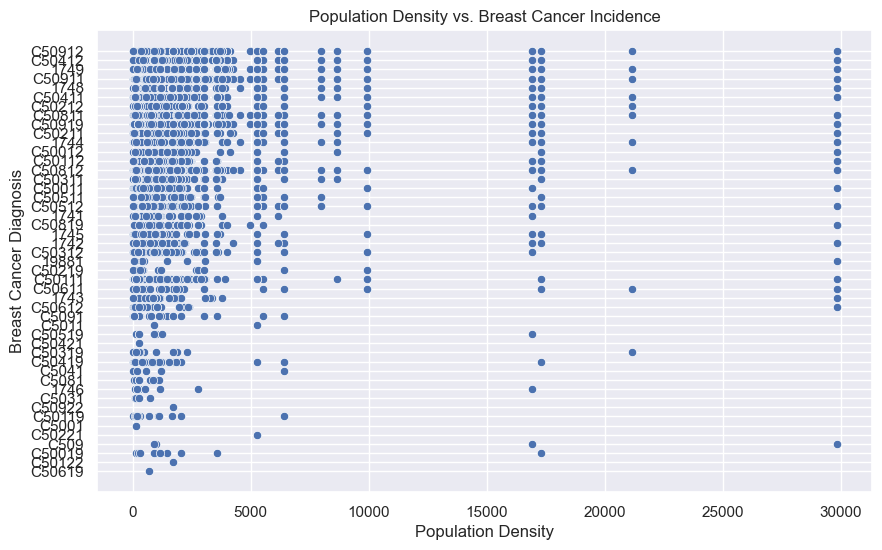

#### Hypothesis from the above graph
15) There is a correlation between population density and the incidence of breast cancer, with higher population density areas having higher rates of diagnosis indicating a positive correlation

### Hypothesis from all the observations:


1) Given patients are mostly ordinary people. The fact that commercial payer type is dominant in the dataset indicates that most patients prefer private insurances indicating that most patients are predominantly ordinary people who do not enjoy any government benefits.~


2) Why so? How can you prove it? 

        A LOFO importance model was plotted that indicates that the occupations like farmer or veteran had negative importance mean on the target variable which brings us to a theory that the diagnosis period did not depend on the occupation that dominated the state or the region the patient is from and which explains why commercial payer type is dominant because most farmers or veterans use Medicaid or Medicare-Advantage payer type.


3) How can you prove that insurance played a role in determining the diangosis period?

        The LOFO model shows a positive importance mean of 'uninsured health' attribute of the patient's region with the target variable meaning if a patient lived in region with higher uninsured health clients, it probably affected the diagnosis period of the patient.


4) So who are these patients?

        The LOFO models shows a higher importance mean for the education_bachelors attribute which means that the diagnosis period of the patient was dependent on how high the people in the patient's region are educated. Since most Americans have a bachelor degree, it could simply mean that areas  It could be that these people must have advised the patient to not opt for certain tests that may have prolonged the diagnosis period, or maybe otherwise.


5) Does that mean that the patients were uneducated or perhaps not from the USA?

        Patients education was not specified in the dataset but it could be that the patients may have not been from the USA originally. They could be migrants as the LOFO importance model shows that the race of the patient influence the target variable as well. 
6) What else indicates that the patients were not from USA?

        The dependence of the diagnosis period on the attribute 'limited english', as shown by the LOFO model, means that the patients may have not been from USA.


7) Could there be a possibility that the dataset is biased?

        There seems to be no possibility that the dataset is biased. The OLS Model shows that races like Black or Hispanic occurred frequently in the dataset meaning that patients identified as Black or Hispanic which could follow our Hypothesis Number 4


8) How was the dependence of the diagnosis period with the patients health?

        As shown by both, the LOFO model, the scatter plot and the OLS model, the patient's BMI did not play any role in the diagnosis period of the patient which could be true since BMI could be important in determining if a patient has cancer or not, it may not be important in predicting how long it took for the patient to get diagnosed. It is also scientifically proven that BMI is not a good measure of health as it does not assess body fat, muscle fat and bone density.


9) So in terms of patient's health, what contributed to the diagnosis period?

        Patient's age showed a significant dominance with the target variable. This could be due to the tests that may have been excluded if not for the patient's age.


10) Is the BMI dependent on the patient's age?

        No. The scatter plot shows no relationship between age of the patient and her BMI.


11) And what about the marital status?

        Patients marital status was not specified in the dataset, but the marital statuses of the people in the patient's region played an important role in determining the diangosis period. With statuses like 'married', 'never married', 'widowed' or 'divorced' playing an important role in determining how quickly the patient was diagnosed. This may be because the patient is involved in some community activities that could postpone the tests that the patient was scheduled for.


12) If marital status played a role in the diagnosis period of the patient, does that mean the family size did as well?

        No. The average family size of the patient's region did not determine the diagnosis period of the patient.


13) So how did the people in the region of the patient affect the diagnosis period?

        The average household income of the patient's region influence the diagnosis period. Like what hypothesis 1 says, most patients are middle-classes, earning between $35k - $155k (per SmartAsset.com). So the regions with family incomes that lie between that range played a role in the diagnosis period of the patient as shown by the OLS Model.


14) In terms of the cancers, who was responsible in the late or quick diagnosis period of the patients?

        Both the cancer codes and diagnosis descriptions of the patients were responsible for the diagnosis periods of the patients as shown by the OLS, LOFO models. This could be because of the mutations of each cancers that could have required more or less tests to get a diagnosis done.


15) So their cures played a role too?

        No. Both, the OLS and LOFO model showed that the treatments did not play a role in the diagnosis period of the patient. Infact the treatment and the treatment types had heavy missing values and had no effect on the target variable


16) What else played a role in diagnosing a patient?

        The average temperatures of the regions played a role in diagnosing the patient. As shown by the LOFO model and the objective of the dataset, average temperatures did play a role in diagnosing a patient. Maybe due to extreme heat or extreme cold, patients postponed their tests.

        

# SECTION 4
## REGRESSION ANALYSIS

### - _Apply Multiple Regression to find the best fitting model_
### - _Evaluate the model based on the R-Squared analysis_
### - _Reject insignificant attributes based on their p-value?_

In [168]:
total_data

,patient_id,patient_zip3,patient_age,bmi,population,density,age_median,age_under_10,age_10_to_19,age_20s,...,metastatic_cancer_diagnosis_code_C7962,metastatic_cancer_diagnosis_code_C7970,metastatic_cancer_diagnosis_code_C7971,metastatic_cancer_diagnosis_code_C7972,metastatic_cancer_diagnosis_code_C798,metastatic_cancer_diagnosis_code_C7981,metastatic_cancer_diagnosis_code_C7982,metastatic_cancer_diagnosis_code_C7989,metastatic_cancer_diagnosis_code_C799,metastatic_first_novel_treatment_PEMBROLIZUMAB
0,268700.0,724.0,39.0,34.1050,3924.87,82.630,42.58,11.61,13.03,10.87,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,484983.0,629.0,55.0,35.3600,2745.39,51.790,43.54,11.22,12.19,11.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,277055.0,925.0,59.0,26.8025,38343.18,700.340,36.28,13.27,15.66,13.49,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,320055.0,900.0,59.0,28.7450,36054.12,3921.575,36.65,9.76,11.27,17.23,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,190386.0,934.0,71.0,25.4075,13700.37,400.480,41.78,10.03,16.43,12.97,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13168,588544.0,191.0,59.0,27.2350,31948.46,3921.575,35.72,10.85,10.95,18.16,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13169,393047.0,757.0,73.0,30.6700,9309.38,204.690,40.87,11.27,14.64,12.11,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13170,790904.0,928.0,24.5,22.5425,39121.88,2295.940,38.20,11.88,13.35,14.23,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
13171,455518.0,481.0,52.0,29.0875,23266.06,743.560,41.47,10.94,13.59,12.67,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [169]:
col = total_data.columns
new_col = col.delete(col.get_loc('metastatic_diagnosis_period'))
y = total_data['metastatic_diagnosis_period']
x1 = total_data[new_col]
x = sm.add_constant(x1)
results = sm.OLS(y, x).fit()


In [170]:
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:     metastatic_diagnosis_period   R-squared:                       0.438
Model:                                     OLS   Adj. R-squared:                  0.426
Method:                          Least Squares   F-statistic:                     35.99
Date:                         Sat, 18 May 2024   Prob (F-statistic):               0.00
Time:                                 12:37:26   Log-Likelihood:                -76693.
No. Observations:                        13173   AIC:                         1.539e+05
Df Residuals:                            12893   BIC:                         1.560e+05
Df Model:                                  279                                         
Covariance Type:                     nonrobust                                         
=============================================================================================================================================================
                                                                                                coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------------------------------------------------------------
const                                                                                     -6805.9235    5.6e+04     -0.122      0.903   -1.17e+05    1.03e+05
patient_id                                                                                 -1.89e-06   2.81e-06     -0.674      0.501   -7.39e-06    3.61e-06
patient_zip3                                                                                  0.1689      0.129      1.311      0.190      -0.084       0.421
patient_age                                                                                  -0.4395      0.066     -6.693      0.000      -0.568      -0.311
bmi                                                                                          -0.0846      0.192     -0.440      0.660      -0.461       0.292
population                                                                                   -0.0010      0.001     -1.023      0.306      -0.003       0.001
density                                                                                       0.0013      0.003      0.502      0.616      -0.004       0.007
age_median                                                                                    0.0700      1.428      0.049      0.961      -2.730       2.870
age_under_10                                                                                 -2.9445      1.722     -1.710      0.087      -6.319       0.430
age_10_to_19                                                                                 -0.5670      1.300     -0.436      0.663      -3.115       1.981
age_20s                                                                                      -2.3955      1.356     -1.766      0.077      -5.054       0.263
age_30s                                                                                      -0.4980      1.285     -0.387      0.698      -3.017       2.021
age_40s                                                                                      -1.7744      1.523     -1.165      0.244      -4.759       1.210
age_50s                                                                                      -2.5608      1.348     -1.900      0.058      -5.203       0.082
age_60s                                                                                      -2.1402      1.293     -1.655      0.098      -4.675       0.394
age_70s                                                                                      -2.7128      1.642     -1.652      0.099      -

#### Hypothesis from the OLS Model
15) income_six_figure has a lower p-value as shown by OLS model than the other income columns which indicate that maybe patients that lived in areas where affluence dominated, diagnosis periods were heavily influenced by it.
16) No relation of patient races with the target variable as shown by OLS meaning that the dataset is unbiased and shows no signs of any racism that any patient faced when receiving her diagnosis.

#### Conclusion from the OLS Model:
 We notice that there are columns with p-value more than 0.05. This explains us that these columns add explanatory power to the data but makes the regression model futile. Dropping these columns can be a strategy that may maximise the $R^{2}$ which can give us a better fitting model for our data. We'll now try excluding this columns to see if it has any effect on the $R^{2}$ value of the OLS model that we employ.

 Columns to exclude: All columns with p-value more than 0.05

In [171]:
reg_data = total_data.copy()
col_to_consider = ['bmi', 'race_white', 'race_black', 'race_asian', 'race_native', 'race_pacific', 'race_other', 'race_multiple',
                   'education_less_highschool', 'education_highschool', 'education_some_college',
                   'income_household_under_5', 'income_household_10_to_15', 'income_household_15_to_20',
                   'income_household_20_to_25', 'income_household_25_to_35', 'income_household_35_to_50',
                   'income_household_50_to_75', 'income_household_75_to_100', 'income_household_100_to_150',
                   'income_household_150_over', 'income_household_six_figure', 'patient_age']
for c in reg_data.columns:
    if c not in col_to_consider and c != 'metastatic_diagnosis_period':
        reg_data.drop(columns=c, inplace = True)


c = reg_data.columns
new_c = c.delete(c.get_loc('metastatic_diagnosis_period'))
predicted = reg_data['metastatic_diagnosis_period']
predictor1 = reg_data[new_c]
predictor = sm.add_constant(predictor1)
result1 = sm.OLS(predicted, predictor).fit()




In [172]:
result1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:     metastatic_diagnosis_period   R-squared:                       0.007
Model:                                     OLS   Adj. R-squared:                  0.005
Method:                          Least Squares   F-statistic:                     4.017
Date:                         Sat, 18 May 2024   Prob (F-statistic):           3.11e-10
Time:                                 12:37:27   Log-Likelihood:                -80441.
No. Observations:                        13173   AIC:                         1.609e+05
Df Residuals:                            13149   BIC:                         1.611e+05
Df Model:                                   23                                         
Covariance Type:                     nonrobust                                         
===============================================================================================
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          60.5883     89.820      0.675      0.500    -115.472     236.648
patient_age                    -0.4576      0.072     -6.335      0.000      -0.599      -0.316
bmi                            -0.2066      0.248     -0.832      0.406      -0.693       0.280
income_household_under_5        1.1939      1.708      0.699      0.484      -2.153       4.541
income_household_10_to_15       0.7441      1.598      0.466      0.641      -2.388       3.876
income_household_15_to_20       0.6573      1.806      0.364      0.716      -2.882       4.196
income_household_20_to_25      -1.3601      1.833     -0.742      0.458      -4.953       2.233
income_household_25_to_35       0.4068      1.292      0.315      0.753      -2.126       2.940
income_household_35_to_50       0.2950      1.140      0.259      0.796      -1.939       2.529
income_household_50_to_75      -0.3696      1.070     -0.345      0.730      -2.467       1.728
income_household_75_to_100     -1.2703      1.176     -1.080      0.280      -3.575       1.035
income_household_100_to_150    -1.0119      1.704     -0.594      0.553      -4.352       2.328
income_household_150_over      -0.5881      1.807     -0.326      0.745      -4.129       2.953
income_household_six_figure     1.1189      1.972      0.568      0.570      -2.746       4.983
education_less_highschool       0.1522      0.402      0.378      0.705      -0.637       0.941
education_highschool            0.8905      0.257      3.460      0.001       0.386       1.395
education_some_college          1.0924      0.301      3.632      0.000       0.503       1.682
race_white                      0.0820      0.232      0.354      0.724      -0.372       0.536
race_black                      0.3119      0.263      1.184      0.237      -0.205       0.828
race_asian                      0.6755      0.513      1.316      0.188      -0.330       1.681
race_native                    -1.4050      2.710     -0.518      0.604      -6.717       3.907
race_pacific                  -21.1116     13.208     -1.598      0.110     -47.002       4.778
race_other                      0.6674      0.486      1.374      0.170      -0.285       1.620
race_multiple                  -0.1529      0.498     -0.307      0.759      -1.129       0.823
==============================================================================
Omnibus:                     1637.339   Durbin-Watson:                   2.023
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2002.851
Skew:                           0.921   Prob(JB):                         0.00
Kurtosis:                       2.493   Cond. No.                     1.11e+

#### Conclusion from the new OLS Model:
 We see that upon excluding the columns that exceeded a p-value of 0.05, the $R^{2}$ value of the model significantly decreases to the point where it almost has no predictive power and cannot explain the dependence of the dependent variable on the present independent variable. This could be due to the underlying factor that even though the excluded variable has a greater p-value, they had some relation with the dependent variable `metastatic_diagnosis_period`. Hence employing the strategy of excluding these variable is not feasible.  

 Columns to exclude: None

# SECTION 5
## Model Selection
### - _Apply various machine learning models_
### - _Evaluate their RMSE_ 
### - _Choose the least RMSE model for the test dataframe_

In [13]:
t = total_data.copy()
t

,patient_id,patient_zip3,patient_age,bmi,population,density,age_median,age_under_10,age_10_to_19,age_20s,...,metastatic_cancer_diagnosis_code_C7962,metastatic_cancer_diagnosis_code_C7970,metastatic_cancer_diagnosis_code_C7971,metastatic_cancer_diagnosis_code_C7972,metastatic_cancer_diagnosis_code_C798,metastatic_cancer_diagnosis_code_C7981,metastatic_cancer_diagnosis_code_C7982,metastatic_cancer_diagnosis_code_C7989,metastatic_cancer_diagnosis_code_C799,metastatic_first_novel_treatment_PEMBROLIZUMAB
0,268700.0,724.0,39.0,34.1050,3924.87,82.630,42.58,11.61,13.03,10.87,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,484983.0,629.0,55.0,35.3600,2745.39,51.790,43.54,11.22,12.19,11.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,277055.0,925.0,59.0,26.8025,38343.18,700.340,36.28,13.27,15.66,13.49,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,320055.0,900.0,59.0,28.7450,36054.12,3921.575,36.65,9.76,11.27,17.23,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,190386.0,934.0,71.0,25.4075,13700.37,400.480,41.78,10.03,16.43,12.97,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13168,588544.0,191.0,59.0,27.2350,31948.46,3921.575,35.72,10.85,10.95,18.16,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13169,393047.0,757.0,73.0,30.6700,9309.38,204.690,40.87,11.27,14.64,12.11,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13170,790904.0,928.0,24.5,22.5425,39121.88,2295.940,38.20,11.88,13.35,14.23,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
13171,455518.0,481.0,52.0,29.0875,23266.06,743.560,41.47,10.94,13.59,12.67,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


RMSE for Linear Regression: 82.97168237853444
RMSE for Ridge Regression: 82.9028935714289


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.068e+07, tolerance: 1.244e+04
  model = cd_fast.enet_coordinate_descent(


RMSE for Lasso Regression: 87.70613546539623
RMSE for Decision Tree Regressor: 117.3046181296163
RMSE for K-Neighbor Regressor: 112.29248663799693
RMSE for Histogram Based Gradient Boosting: 82.51277287933632


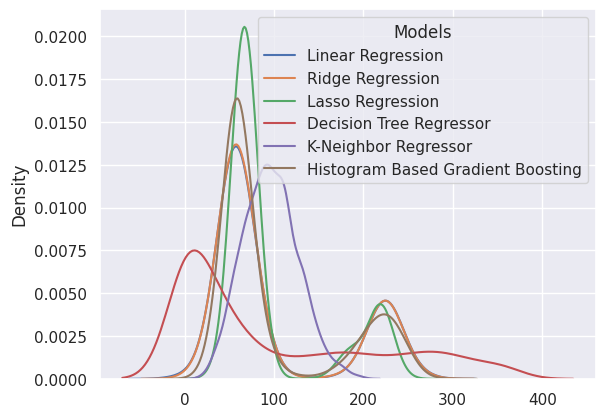

In [26]:
X = t.drop(columns = ['patient_id', 'metastatic_diagnosis_period'])
y = wids_train['metastatic_diagnosis_period'] 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
models = {
    'Linear Regression': LinearRegression(),
    'Ridge Regression': Ridge(),
    'Lasso Regression': Lasso(),
    'Decision Tree Regressor': DecisionTreeRegressor(),
    'K-Neighbor Regressor': KNeighborsRegressor(n_neighbors=15),
    'Histogram Based Gradient Boosting': HistGradientBoostingRegressor()
}

rmse_dict = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    rmse_dict[name] = y_pred
    print(f"RMSE for {name}: {rmse}")

for name, y_pred in rmse_dict.items():
    sns.kdeplot(y_pred, label=name)


plt.legend(title = "Models")
plt.show()

Training Linear Regression...
Training Ridge Regression...
Training Lasso Regression...


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.656e+05, tolerance: 1.004e+04
  model = cd_fast.enet_coordinate_descent(
/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.930e+07, tolerance: 9.867e+03
  model = cd_fast.enet_coordinate_descent(
/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2

Best parameters for Lasso Regression: {'alpha': 0.1}
Training Decision Tree Regressor...
Training K-Neighbor Regressor...
RMSE for Linear Regression: 82.97168237853444
RMSE for Ridge Regression: 82.9028935714289
RMSE for Lasso Regression: 82.87268309034734
RMSE for Decision Tree Regressor: 116.72195184174112
RMSE for K-Neighbor Regressor: 112.29248663799693


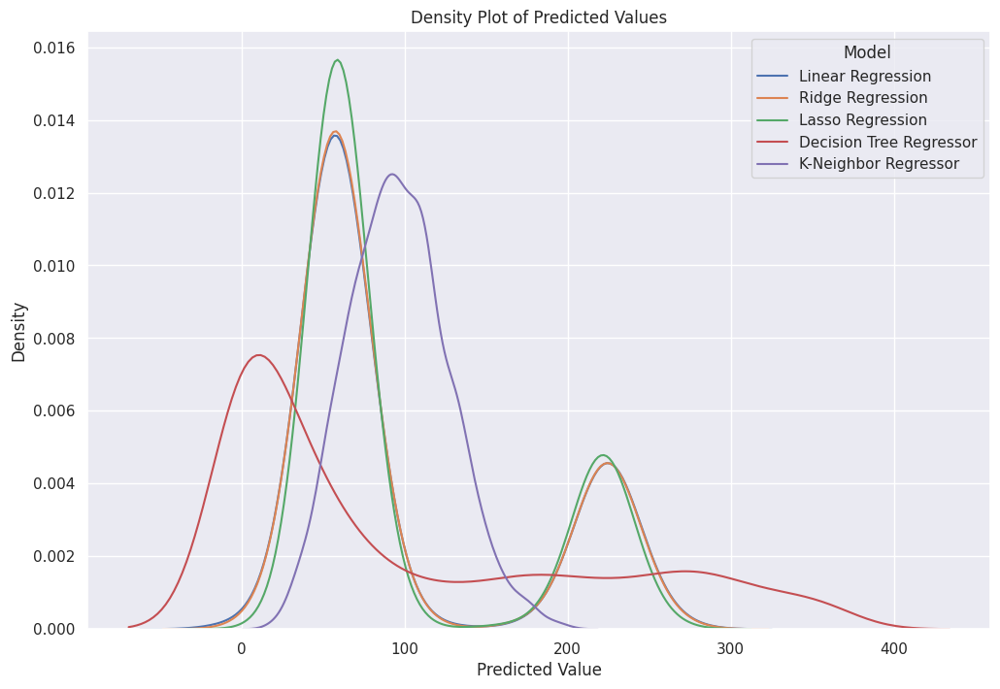

In [175]:
# Define parameter grids for each model
param_grids = {
    'Lasso Regression': {'alpha': [0.1, 1, 10, 100]}
}

best_estimators = {}

for name, model in models.items():
    print(f"Training {name}...")
    if name == 'Lasso Regression':
        grid_search = GridSearchCV(model, param_grids[name], cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
        grid_search.fit(X_train, y_train)
        best_estimators[name] = grid_search.best_estimator_
        print(f"Best parameters for {name}: {grid_search.best_params_}")
    else:
        model.fit(X_train, y_train)
        best_estimators[name] = model

# Evaluate the best models
for name, model in best_estimators.items():
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    print(f"RMSE for {name}: {rmse}")

# Plot the results
# Store predictions for plotting
predictions = {}

for name, model in best_estimators.items():
    predictions[name] = model.predict(X_test)

plt.figure(figsize=(12, 8))
for name, y_pred in predictions.items():
    sns.kdeplot(y_pred, label=name)

plt.title('Density Plot of Predicted Values')
plt.xlabel('Predicted Value')
plt.ylabel('Density')
plt.legend(title='Model')
plt.show()

#### Conclusion: 
We find that Histogram based gradient boosting Regression is the best model that can be applied to our data.

# SECTION 6
## Replicating the steps we applied on the test dataset
### - _Replicate the train dataset preprocessing and model selection on test dataset_
### - _Create a final submission array to be submitted_

In [14]:
numerical_test

,patient_id,patient_zip3,patient_age,bmi,population,density,age_median,age_under_10,age_10_to_19,age_20s,...,Average of Mar-18,Average of Apr-18,Average of May-18,Average of Jun-18,Average of Jul-18,Average of Aug-18,Average of Sep-18,Average of Oct-18,Average of Nov-18,Average of Dec-18
0,730681,713,55,NaN,4639.07,72.66,41.50,11.40,13.44,11.42,...,62.21,62.23,78.34,81.96,83.58,82.22,80.20,69.73,53.14,51.34
1,334212,283,60,40.00,10875.30,217.91,39.64,11.23,13.72,15.01,...,48.63,58.14,77.26,80.05,82.88,82.09,78.85,64.60,50.57,48.10
2,571362,794,54,32.33,18716.73,1019.51,30.37,11.00,18.86,23.11,...,57.82,59.95,77.79,82.45,82.44,80.77,72.16,59.31,48.25,42.13
3,907331,373,63,27.07,7804.79,140.05,44.32,10.19,12.66,11.70,...,47.57,53.50,71.31,75.20,76.96,75.78,74.87,61.06,44.31,42.83
4,208382,980,62,NaN,28628.29,1091.83,39.68,12.14,12.46,11.32,...,41.02,46.25,56.92,57.88,66.16,65.21,57.52,49.53,43.75,38.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5641,649011,800,63,NaN,33840.19,1214.02,38.10,12.79,12.24,13.20,...,43.24,48.85,61.47,72.59,74.94,72.44,67.41,49.12,38.81,33.29
5642,869024,300,57,40.00,40162.73,875.12,37.73,13.42,14.39,12.03,...,50.20,56.76,72.53,77.56,78.82,77.39,78.71,64.14,47.25,44.86
5643,304800,914,44,NaN,39504.88,4008.49,37.55,11.49,11.44,14.51,...,59.25,62.98,63.26,67.57,76.04,75.15,71.05,68.75,65.27,59.42
5644,267406,906,66,31.79,40982.11,3008.77,37.06,10.83,15.64,16.01,...,60.26,64.84,64.40,69.37,78.29,77.42,73.15,70.26,65.92,59.39


In [15]:
categorical_test

,patient_race,payer_type,patient_state,Region,Division,patient_gender,breast_cancer_diagnosis_code,breast_cancer_diagnosis_desc,metastatic_cancer_diagnosis_code,metastatic_first_novel_treatment,metastatic_first_novel_treatment_type
0,NaN,COMMERCIAL,LA,South,West South Central,F,1746,Malignant neoplasm of axillary tail of female ...,C7981,NaN,NaN
1,Black,NaN,NC,South,South Atlantic,F,C50912,Malignant neoplasm of unspecified site of left...,C773,NaN,NaN
2,NaN,COMMERCIAL,TX,South,West South Central,F,1742,Malignant neoplasm of upper-inner quadrant of ...,C773,NaN,NaN
3,NaN,COMMERCIAL,TN,South,East South Central,F,1748,Malignant neoplasm of other specified sites of...,C7951,NaN,NaN
4,Asian,NaN,WA,West,Pacific,F,C50411,Malig neoplm of upper-outer quadrant of right ...,C787,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
5641,White,NaN,CO,West,Mountain,F,C50911,Malignant neoplasm of unsp site of right femal...,C773,NaN,NaN
5642,NaN,COMMERCIAL,GA,South,South Atlantic,F,C50212,Malig neoplasm of upper-inner quadrant of left...,C7989,NaN,NaN
5643,Asian,COMMERCIAL,CA,West,Pacific,F,1749,"Malignant neoplasm of breast (female), unspeci...",C7951,NaN,NaN
5644,White,MEDICARE ADVANTAGE,CA,West,Pacific,F,C50911,Malignant neoplasm of unsp site of right femal...,C779,NaN,NaN


In [16]:
statanalysis(numerical_test)

                                      Mean       Median  Total Null Values  \
patient_id                   555441.784939  555769.0000                  0   
patient_zip3                    568.530859     557.0000                  0   
patient_age                      59.279967      59.0000                  0   
bmi                              29.167416      29.0725                  0   
population                    20511.599881   18952.7800                  0   
...                                    ...          ...                ...   
Average of Sep-18                71.420214      70.8800                  0   
Average of Oct-18                59.324472      57.4500                  0   
Average of Nov-18                46.100138      42.4300                  0   
Average of Dec-18                42.121123      38.5200                  0   
metastatic_diagnosis_period      96.515221      44.0000                  0   

                             Null Value Percentage           Ma

In [17]:
catanalysis(categorical_test)

                                                                                    Mode  \
patient_race                                                                       White   
payer_type                                                                    COMMERCIAL   
patient_state                                                                         CA   
Region                                                                             South   
Division                                                              East North Central   
patient_gender                                                                         F   
breast_cancer_diagnosis_code                                                        1749   
breast_cancer_diagnosis_desc           Malignant neoplasm of breast (female), unspeci...   
metastatic_cancer_diagnosis_code                                                    C773   
metastatic_first_novel_treatment                                                

In [180]:
male_columns = [c for c in wids_test['breast_cancer_diagnosis_desc'] if re.search(r'\bmale\b', c)]
filtered_data = wids_test[wids_test['breast_cancer_diagnosis_desc'].isin(male_columns)]
corresponding_codes = filtered_data['breast_cancer_diagnosis_code']
for code, description in zip(corresponding_codes, filtered_data['breast_cancer_diagnosis_desc']):
    print(f"{code}: {description}")

No NLP required for test dataset.

In [181]:
categorical_test.drop(columns=['breast_cancer_diagnosis_desc'], inplace = True)

In [18]:
imputer = KNNImputer(n_neighbors= 4)
numerical_test = pd.DataFrame(imputer.fit_transform(numerical_test), columns=numerical_test.columns)
categorical_test = pd.get_dummies(categorical_test[categorical_test.columns], drop_first=True)
imputercat = KNNImputer(n_neighbors=4)
imputed_data = imputercat.fit_transform(categorical_test)
imputed_df = pd.DataFrame(imputed_data, columns=categorical_test.columns)

In [183]:
numerical_test.isnull().sum()

patient_id           0
patient_zip3         0
patient_age          0
bmi                  0
population           0
                    ..
Average of Aug-18    0
Average of Sep-18    0
Average of Oct-18    0
Average of Nov-18    0
Average of Dec-18    0
Length: 140, dtype: int64

In [184]:
imputed_df.isnull().sum()

patient_race_Black                                0
patient_race_Hispanic                             0
patient_race_Other                                0
patient_race_White                                0
payer_type_MEDICAID                               0
                                                 ..
metastatic_cancer_diagnosis_code_C7981            0
metastatic_cancer_diagnosis_code_C7982            0
metastatic_cancer_diagnosis_code_C7989            0
metastatic_cancer_diagnosis_code_C799             0
metastatic_first_novel_treatment_PEMBROLIZUMAB    0
Length: 137, dtype: int64

In [19]:
numerical_test = capoutliers(numerical_test)
total_test = pd.concat([numerical_test, imputed_df], axis=1)
total_test.reset_index(drop=True, inplace=True)
print(total_test)
statanalysis(total_test)
catanalysis(total_test) 


      patient_id  patient_zip3  patient_age        bmi  population   density  \
0       730681.0         713.0         55.0  25.527500     4639.07    72.660   
1       334212.0         283.0         60.0  38.481875    10875.30   217.910   
2       571362.0         794.0         54.0  32.330000    18716.73  1019.510   
3       907331.0         373.0         63.0  27.070000     7804.79   140.050   
4       208382.0         980.0         62.0  25.717500    28628.29  1091.830   
...          ...           ...          ...        ...         ...       ...   
5641    649011.0         800.0         63.0  30.440000    33840.19  1214.020   
5642    869024.0         300.0         57.0  38.481875    40162.73   875.120   
5643    304800.0         914.0         44.0  30.147500    39504.88  3972.905   
5644    267406.0         906.0         66.0  31.790000    40982.11  3008.770   
5645    873886.0         122.0         73.0  28.367500    12947.75  1662.480   

      age_median  age_under_10  age_10_

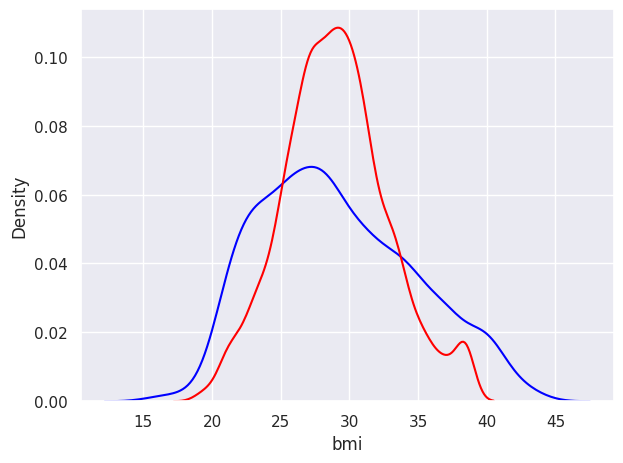

In [186]:
sns.kdeplot(wids_test['bmi'], color = 'blue')
sns.kdeplot(numerical_test['bmi'], color = 'red')
plt.tight_layout()
plt.show()

In [20]:
combined_data = pd.concat([total_data, total_test], ignore_index=True)


combined_data = pd.get_dummies(combined_data, drop_first=True)

combined_data.fillna(0, inplace=True)
combined_data = combined_data.drop(columns=['patient_id'])


total_data_encoded = combined_data[:len(total_data)]
total_test_encoded = combined_data[len(total_data):]


In [188]:
combined_data.isnull().sum()

patient_zip3                                      0
patient_age                                       0
bmi                                               0
population                                        0
density                                           0
                                                 ..
metastatic_cancer_diagnosis_code_C799             0
metastatic_first_novel_treatment_PEMBROLIZUMAB    0
breast_cancer_diagnosis_code_C5021                0
metastatic_cancer_diagnosis_code_C7830            0
metastatic_cancer_diagnosis_code_C7919            0
Length: 333, dtype: int64

In [189]:
assert total_data_encoded.isnull().sum().sum() == 0, "There are still missing values in the training data"
assert total_test_encoded.isnull().sum().sum() == 0, "There are still missing values in the test data"


In [23]:
finalx_train = total_data_encoded.drop(columns=['metastatic_diagnosis_period'])
finaly_train = total_data_encoded['metastatic_diagnosis_period']
x_test = total_test_encoded.drop(columns=['metastatic_diagnosis_period'])


In [85]:

models = {
    'Linear Regression': LinearRegression(),
    'Ridge Regression': Ridge(),
    'Lasso Regression': Lasso(),
    'Histogram Based Gradient Boosting': HistGradientBoostingRegressor()
}

param_grids = {
    'Ridge Regression': {'alpha': [0.1, 1, 10, 100]},
    'Lasso Regression': {'alpha': [0.1, 1, 10, 100]},
    'Histogram Based Gradient Boosting': {
        'learning_rate': [0.01, 0.1, 0.2],
        'max_iter': [100, 200, 300],
        'max_leaf_nodes': [31, 63, 127],
        'max_depth': [None, 10, 20],
        'min_samples_leaf': [20, 50, 100],
        'l2_regularization': [0.0, 0.1, 0.5],
        'max_bins': [255, 512]
    }
}

pred = {}
best_estimators = {}

# Train models and perform grid search where applicable
for name, model in models.items():
    print(f"Training {name}...")
    if name in param_grids:
        grid_search = GridSearchCV(model, param_grids[name], cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=2)
        grid_search.fit(finalx_train, finaly_train)
        best_estimators[name] = grid_search.best_estimator_
        print(f"Best parameters for {name}: {grid_search.best_params_}")
    else:
        model.fit(finalx_train, finaly_train)
        best_estimators[name] = model

# Evaluate the best models
for name, model in best_estimators.items():
    y_pred = model.predict(x_test)
    pred[name] = y_pred
    

Training Linear Regression...
Training Ridge Regression...
Fitting 5 folds for each of 4 candidates, totalling 20 fits


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=1.0024e-16): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=1.01895e-16): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T


[CV] END ..........................................alpha=0.1; total time=   0.2s
[CV] END ..........................................alpha=0.1; total time=   0.2s
[CV] END ............................................alpha=1; total time=   0.4s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=1.0014e-16): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=1.01342e-16): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T


[CV] END ..........................................alpha=0.1; total time=   0.3s
[CV] END ...........................................alpha=10; total time=   0.3s
[CV] END ............................................alpha=1; total time=   0.3s
[CV] END ...........................................alpha=10; total time=   0.3s
[CV] END ..........................................alpha=0.1; total time=   0.4s
[CV] END ............................................alpha=1; total time=   0.4s
[CV] END ..........................................alpha=100; total time=   0.3s
[CV] END ..........................................alpha=100; total time=   0.4s[CV] END ............................................alpha=1; total time=   0.3s



/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:204: LinAlgWarning: Ill-conditioned matrix (rcond=1.0125e-16): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T


[CV] END ..........................................alpha=0.1; total time=   0.3s
[CV] END ............................................alpha=1; total time=   0.4s
[CV] END ..........................................alpha=100; total time=   0.3s
[CV] END ..........................................alpha=100; total time=   0.2s
[CV] END ...........................................alpha=10; total time=   0.2s
[CV] END ...........................................alpha=10; total time=   0.3s
[CV] END ..........................................alpha=100; total time=   0.2s
[CV] END ...........................................alpha=10; total time=   0.1s
Best parameters for Ridge Regression: {'alpha': 10}
Training Lasso Regression...
Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV] END ..........................................alpha=100; total time=   5.8s
[CV] END ...........................................alpha=10; total time=   8.7s
[CV] END ........................................

/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.735e+07, tolerance: 1.259e+04
  model = cd_fast.enet_coordinate_descent(


[CV] END ..........................................alpha=0.1; total time=  33.0s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.827e+07, tolerance: 1.251e+04
  model = cd_fast.enet_coordinate_descent(
/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.167e+07, tolerance: 1.248e+04
  model = cd_fast.enet_coordinate_descent(


[CV] END ............................................alpha=1; total time=  34.4s
[CV] END ............................................alpha=1; total time=  34.5s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.903e+07, tolerance: 1.248e+04
  model = cd_fast.enet_coordinate_descent(


[CV] END ............................................alpha=1; total time=  35.0s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.712e+07, tolerance: 1.249e+04
  model = cd_fast.enet_coordinate_descent(


[CV] END ..........................................alpha=0.1; total time=  35.2s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.335e+07, tolerance: 1.259e+04
  model = cd_fast.enet_coordinate_descent(


[CV] END ............................................alpha=1; total time=  35.5s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.487e+07, tolerance: 1.249e+04
  model = cd_fast.enet_coordinate_descent(
/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.678e+07, tolerance: 1.248e+04
  model = cd_fast.enet_coordinate_descent(
/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3

[CV] END ............................................alpha=1; total time=  36.6s
[CV] END ..........................................alpha=0.1; total time=  36.6s
[CV] END ..........................................alpha=0.1; total time=  36.7s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.681e+07, tolerance: 1.248e+04
  model = cd_fast.enet_coordinate_descent(


[CV] END ..........................................alpha=0.1; total time=  37.1s


/home/manish/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.622e+07, tolerance: 1.564e+04
  model = cd_fast.enet_coordinate_descent(


Best parameters for Lasso Regression: {'alpha': 0.1}
Training Histogram Based Gradient Boosting...
Fitting 5 folds for each of 1458 candidates, totalling 7290 fits
[CV] END l2_regularization=0.0, learning_rate=0.01, max_bins=255, max_depth=None, max_iter=100, max_leaf_nodes=31, min_samples_leaf=20; total time=  16.3s
[CV] END l2_regularization=0.0, learning_rate=0.01, max_bins=255, max_depth=None, max_iter=100, max_leaf_nodes=31, min_samples_leaf=20; total time=  17.0s
[CV] END l2_regularization=0.0, learning_rate=0.01, max_bins=255, max_depth=None, max_iter=100, max_leaf_nodes=31, min_samples_leaf=50; total time=  17.3s
[CV] END l2_regularization=0.0, learning_rate=0.01, max_bins=255, max_depth=None, max_iter=100, max_leaf_nodes=31, min_samples_leaf=100; total time=  17.3s
[CV] END l2_regularization=0.0, learning_rate=0.01, max_bins=255, max_depth=None, max_iter=100, max_leaf_nodes=31, min_samples_leaf=100; total time=  17.5s
[CV] END l2_regularization=0.0, learning_rate=0.01, max_bin

/home/manish/.local/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning: 
3645 fits failed out of a total of 7290.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3645 fits failed with the following error:
Traceback (most recent call last):
  File "/home/manish/.local/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/manish/.local/lib/python3.10/site-packages/sklearn/base.py", line 1467, in wrapper
    estimator._validate_params()
  File "/home/manish/.local/lib/python3.10/site-packages/sklearn/base.py", line 666, in _validate_params
    validate_parameter_constraints(
  File "/home/manish/

Best parameters for Histogram Based Gradient Boosting: {'l2_regularization': 0.1, 'learning_rate': 0.01, 'max_bins': 255, 'max_depth': 20, 'max_iter': 300, 'max_leaf_nodes': 31, 'min_samples_leaf': 20}


# SECTION 7:
## Experimental Models
### -_Histogram-Based Gradient Boosting_
#### Applied directly on the training and testing datasets without any preprocessing

In [69]:
experimental_total = pd.concat([experimental_train, experimental_test], ignore_index=True)

# Perform one-hot encoding on the combined dataset
combined_data_exp = pd.get_dummies(experimental_total, drop_first=True)

# Split the encoded data back into training and testing sets
total_exptrain_encoded = combined_data_exp[:len(experimental_train)]
total_exptest_encoded = combined_data_exp[len(experimental_train):]

# Define target and features for training
y = total_exptrain_encoded['metastatic_diagnosis_period']
x = total_exptrain_encoded.drop(columns=['metastatic_diagnosis_period'])

# Initialize and fit the HistGradientBoostingRegressor
regressor = HistGradientBoostingRegressor()
regressor.fit(x, y)

# Make predictions on the test set
predictions = regressor.predict(total_exptest_encoded.drop(columns=['metastatic_diagnosis_period']))

processedpred = pred['Histogram Based Gradient Boosting']
# Print the predictions
for i in range(len(predictions)):
    print("The processed predictions are: ", processedpred[i] , "The unprocessed predictions are: ", predictions[i])

The processed predictions are:  101.4641986659166 The unprocessed predictions are:  133.03093441419202
The processed predictions are:  78.41367113976865 The unprocessed predictions are:  78.51421457323988
The processed predictions are:  174.8043136605411 The unprocessed predictions are:  161.8800447226032
The processed predictions are:  213.97050941315882 The unprocessed predictions are:  225.95261323122534
The processed predictions are:  50.21144769602129 The unprocessed predictions are:  48.18873944480963
The processed predictions are:  230.41690467200604 The unprocessed predictions are:  231.63717268802216
The processed predictions are:  56.353933599225485 The unprocessed predictions are:  51.24058823520739
The processed predictions are:  65.80620316521059 The unprocessed predictions are:  58.61166417214287
The processed predictions are:  134.2318497859859 The unprocessed predictions are:  75.48365686096368
The processed predictions are:  38.392464871784185 The unprocessed predictio

In [24]:
import pandas as pd
import numpy as np
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.model_selection import GridSearchCV, train_test_split
import csv

# Hyperparameter tuning with GridSearchCV
param_grid = {
    'learning_rate': [0.01, 0.05, 0.1],
    'max_iter': [100, 200, 300],
    'max_leaf_nodes': [15, 31, 50]
}

hgb = HistGradientBoostingRegressor(random_state=42)
grid_search = GridSearchCV(estimator=hgb, param_grid=param_grid, cv=5, n_jobs=-1, scoring='neg_mean_squared_error')
grid_search.fit(finalx_train, finaly_train)

print("Best parameters found by GridSearchCV:")
print(grid_search.best_params_)
print("Best RMSE found by GridSearchCV:")
print(np.sqrt(-grid_search.best_score_))

# Make predictions
model = grid_search.best_estimator_
preds = model.predict(x_test)

# Prepare submission file
patient_id = np.array(wids_test['patient_id'])
field_names = ['patient_id', 'metastatic_diagnosis_period']
filename = "submissions_hgb_tuned_random_state_42.csv"

# Write predictions to CSV file
with open(filename, "w", newline='') as csvfile:
    writer = csv.DictWriter(csvfile, fieldnames=field_names)
    writer.writeheader()
    for pid, prediction in zip(patient_id, preds):
        row = {
            'patient_id': pid,
            'metastatic_diagnosis_period': prediction
        }
        writer.writerow(row)

print(f"Predictions saved to {filename}")

Best parameters found by GridSearchCV:
{'learning_rate': 0.05, 'max_iter': 100, 'max_leaf_nodes': 15}
Best RMSE found by GridSearchCV:
82.83140956921716
Predictions saved to submissions_hgb_tuned_random_state_42.csv


# Section 8:
### SUBMISSIONS

In [74]:
patient_id = np.array(experimental_test["patient_id"])

# Define the field names for the CSV
field_names = ['patient_id', 'metastatic_diagnosis_period']

# Name of the CSV file
filename = "submissions.csv"

# Open the CSV file in write mode
with open(filename, "w", newline='') as csvfile:
    # Create a CSV DictWriter object
    writer = csv.DictWriter(csvfile, fieldnames=field_names)
    
    # Write the header to the CSV file
    writer.writeheader()
    
    # Iterate through the patient IDs and their corresponding predictions
    for pid, prediction in zip(patient_id, predictions):
        # Create a dictionary for each row
        row = {
            'patient_id': pid,
            'metastatic_diagnosis_period': prediction
        }
        
        # Write the dictionary to the CSV file
        writer.writerow(row)

print(f"Predictions saved to {filename}")

Predictions saved to submissions.csv


In [86]:
patient_id = np.array(experimental_test["patient_id"])

field_names = ['patient_id', 'metastatic_diagnosis_period']

# Name of the CSV file
filename = "submissions5.csv"

predi = np.array(pred["Histogram Based Gradient Boosting"])

# Open the CSV file in write mode
with open(filename, "w", newline='') as csvfile:
    # Create a CSV DictWriter object
    writer = csv.DictWriter(csvfile, fieldnames=field_names)
    
    # Write the header to the CSV file
    writer.writeheader()
    
    # Iterate through the patient IDs and their corresponding predictions
    for pid, prediction in zip(patient_id, predi):
        # Create a dictionary for each row
        row = {
            'patient_id': pid,
            'metastatic_diagnosis_period': prediction
        }
        
        # Write the dictionary to the CSV file
        writer.writerow(row)

print(f"Predictions saved to {filename}")

Predictions saved to submissions5.csv


# FINAL CODE WITH SUBMISSION:


In [3]:
wids_train = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/train.csv')
wids_test = pd.read_csv('/media/manish/D Drive/DataSet/WiDS Dataset/WiDS Data/test.csv')
total_data = pd.concat([wids_train, wids_test], keys=["train", "test"])
copydata = total_data.copy()
col = [
 'patient_id',
 'patient_state',
 'Division',
 'patient_gender',
 'bmi',
 'metastatic_first_novel_treatment',
 'metastatic_first_novel_treatment_type',
 'population',
 'age_under_10',
 'age_10_to_19',
 'age_20s',
 'age_30s',
 'age_40s',
 'age_50s',
 'age_60s',
 'age_70s',
 'age_over_80',
 'male',
 'female',
 'divorced',
 'never_married',
 'widowed',
 'family_size',
 'family_dual_income',
 'income_household_median',
 'income_household_under_5',
 'income_household_5_to_10',
 'income_household_10_to_15',
 'income_household_15_to_20',
 'income_household_20_to_25',
 'income_household_25_to_35',
 'income_household_50_to_75',
 'income_household_75_to_100',
 'income_household_100_to_150',
 'income_household_150_over',
 'home_ownership',
 'housing_units',
 'home_value',
 'rent_median',
 'rent_burden',
 'education_less_highschool',
 'education_highschool',
 'education_some_college',
 'education_graduate',
 'education_college_or_above',
 'education_stem_degree',
 'labor_force_participation',
 'unemployment_rate',
 'self_employed',
 'hispanic',
 'disabled',
 'poverty',
 'commute_time',
 'veteran'
]
copydata = copydata.drop(columns=col)

copydata = pd.get_dummies(copydata, drop_first=True)
train = copydata[:len(wids_train)]
test = copydata[len(wids_train):].drop(columns=['metastatic_diagnosis_period'])

# Split train into x_train and y_train
y_train = train['metastatic_diagnosis_period']
x_train = train.drop(columns=['metastatic_diagnosis_period'])


model = HistGradientBoostingRegressor()
model.fit(x_train, y_train)


preds = model.predict(test)

print(preds)

patient_id = np.array(wids_test['patient_id'])
field_names = ['patient_id', 'metastatic_diagnosis_period']


filename = "subnew1.csv"

# Open the CSV file in write mode
with open(filename, "w", newline='') as csvfile:
    # Create a CSV DictWriter object
    writer = csv.DictWriter(csvfile, fieldnames=field_names)
    
    # Write the header to the CSV file
    writer.writeheader()
    
    # Iterate through the patient IDs and their corresponding predictions
    for pid, prediction in zip(patient_id, preds):
        # Create a dictionary for each row
        row = {
            'patient_id': pid,
            'metastatic_diagnosis_period': prediction
        }
        
        # Write the dictionary to the CSV file
        writer.writerow(row)

print(f"Predictions saved to {filename}")

[100.52648889  84.48687268 175.50701381 ... 197.62387304  63.86500285
  54.73269634]
Predictions saved to subnew1.csv
